# What is the best group of models to use in our validation dataset?

In [2]:
import numpy as np
import pickle
import matplotlib.pyplot as plt
import matplotlib.patches as pat
import matplotlib
import seaborn as sb
import os
import pandas as pd
# import proplot

%matplotlib inline
sb.set()
sb.set_palette("colorblind")
colors = sb.color_palette("colorblind")
sb.set_style("whitegrid")

In [20]:
USER = 'jrader'
ROOT = '/Users/' + USER + '/Rams/TOE_Research/'
TRIALTYPE='_globe-land'
TRIALTYPE='_americas-land'
EXPERIMENT = 'pr_tas_final' + TRIALTYPE + '/'
EXPERIMENT = 'r95p_final' + TRIALTYPE + '/'
f = open(ROOT + '/playground_data/' + EXPERIMENT+
         'bestmodeldictionary_cmip6_classification'+TRIALTYPE+'.p', 'rb')
modelstats = pickle.load(f)
f.close()

In [22]:
all_validations = []
for i in range(100):
    all_validations.append(
        sorted(modelstats["['r95p']"][i]['dataset info']['validation model id numbers']))

In [23]:
sorted(all_validations)

[[0, 2, 3, 4, 21, 30],
 [0, 3, 6, 11, 12, 22],
 [0, 3, 6, 15, 17, 22],
 [0, 3, 11, 18, 24, 27],
 [0, 3, 12, 16, 20, 27],
 [0, 4, 10, 13, 16, 29],
 [0, 4, 13, 18, 23, 31],
 [0, 5, 9, 14, 17, 20],
 [0, 7, 9, 11, 15, 18],
 [0, 8, 20, 25, 28, 31],
 [0, 10, 24, 28, 29, 30],
 [0, 11, 22, 26, 27, 31],
 [0, 14, 20, 22, 28, 31],
 [0, 15, 19, 23, 29, 30],
 [0, 20, 28, 29, 30, 31],
 [0, 21, 22, 26, 28, 29],
 [1, 2, 6, 12, 17, 22],
 [1, 3, 7, 9, 11, 16],
 [1, 3, 12, 13, 16, 23],
 [1, 3, 14, 21, 24, 29],
 [1, 4, 11, 14, 20, 23],
 [1, 4, 12, 20, 26, 28],
 [1, 4, 15, 21, 25, 27],
 [1, 5, 10, 14, 26, 30],
 [1, 5, 12, 20, 27, 30],
 [1, 5, 12, 23, 25, 28],
 [1, 7, 12, 13, 18, 19],
 [1, 13, 15, 19, 20, 30],
 [1, 14, 22, 23, 27, 28],
 [2, 3, 6, 14, 18, 20],
 [2, 3, 9, 12, 19, 31],
 [2, 4, 6, 12, 13, 16],
 [2, 4, 6, 16, 19, 25],
 [2, 5, 6, 8, 11, 26],
 [2, 5, 13, 15, 21, 22],
 [2, 6, 7, 16, 19, 30],
 [2, 6, 15, 17, 18, 27],
 [2, 7, 8, 16, 19, 21],
 [2, 8, 10, 23, 24, 25],
 [2, 8, 11, 15, 21, 25],
 [2, 8, 1

### Do obs correlations


In [271]:
modelstats
np.array(list(modelstats.keys()))[np.array([6, 0, 9, 7, 1, 10, 8, 12, 11])]
titles = ['tas-ann', 'tas-seas', 'tas-mon', 
          'pr-ann-gpcp', 'pr-ann-era5', 'pr-ann-jra55',
          'pr-seas-gpcp', 'pr-seas-era5', 'pr-seas-jra55',
          'pr-mon-gpcp', 'pr-mon-era5', 'pr-mon-jra55',
          'com-ann-gpcp', 'com-ann-era5','com-ann-jra55',
          'com-seas-gpcp', 'com-seas-era5', 'com-seas-jra55',
          'com-mon-gpcp', 'com-mon-era5', 'com-mon-jra55']
titles1 = ['tas'] * 3 + ['pr'] * 9 + ['com'] * 9
titles2 = ['ann', 'seas', 'mon'] + ['ann'] * 3 + ['seas'] * 3 \
        + ['mon'] * 3 + ['ann'] * 3 + ['seas'] * 3 + ['mon'] * 3
titles3 = ['BEST'] * 3 + ['GPCP', 'ERA5', 'JRA55'] * 6

In [280]:
correlations = dict()
correlations['var'] = []
correlations['seg'] = []
correlations['obs'] = []
correlations['cor'] = []
for var in np.array(list(modelstats.keys()))[np.array([1])]:
    varnm = 'r95p'
    segnm = 'seas'
    for probs in ['']:
        probsnm = 'ERA-5'
        for i in range(100):
            correlations['obs'].append(probsnm)
            correlations['seg'].append(segnm)
            correlations['var'].append(varnm)
            correlations['cor'].append( \
            float(modelstats[var][i]['model result']['obs corr' + probs + '']) )
            #correlations[varnm][segnm][probsnm][i] = float(modelstats[var][i]['model result']['obs corr' + probs + ''])

In [282]:
iterate = 0
for var in np.array(list(modelstats.keys()))[np.array([6, 0, 9, 7, 1, 10, 8, 12, 11])]:
    varnm = titles1[iterate]
    segnm = titles2[iterate]
    if var in np.array(list(modelstats.keys()))[np.array([6, 0, 9])]:
        probs = ''
        probsnm = titles3[iterate]
        for i in range(100):
            correlations['obs'].append(probsnm)
            correlations['seg'].append(segnm)
            correlations['var'].append(varnm)
            correlations['cor'].append( \
            float(modelstats[var][i]['model result']['obs corr' + probs + '']) )
            #correlations[varnm][segnm][probsnm][i] = float(modelstats[var][i]['model result']['obs corr' + probs + ''])
        iterate += 1

    else:
        for probs in [' (gpcp)', '', ' (jra55)']:
            probsnm = titles3[iterate]
            for i in range(100):
                correlations['obs'].append(probsnm)
                correlations['seg'].append(segnm)
                correlations['var'].append(varnm)
                correlations['cor'].append( \
                float(modelstats[var][i]['model result']['obs corr' + probs + '']) )
                #correlations[varnm][segnm][probsnm][i] = float(modelstats[var][i]['model result']['obs corr' + probs + ''])
            iterate += 1

In [283]:
#user_dict = correlations
dfdat = pd.DataFrame.from_dict(correlations)
#dfdat = pd.DataFrame.from_dict({(i,j): user_dict[i][j] 
#                               for i in user_dict.keys() 
#                               for j in user_dict[i].keys()},
#                               orient='index')
display(dfdat)

,var,seg,obs,cor
0,r95p,seas,ERA-5,0.482
1,r95p,seas,ERA-5,0.437
2,r95p,seas,ERA-5,0.400
3,r95p,seas,ERA-5,0.426
4,r95p,seas,ERA-5,0.266
...,...,...,...,...
2195,com,mon,JRA55,0.912
2196,com,mon,JRA55,0.933
2197,com,mon,JRA55,0.920
2198,com,mon,JRA55,0.929


<Figure size 2000x1000 with 0 Axes>

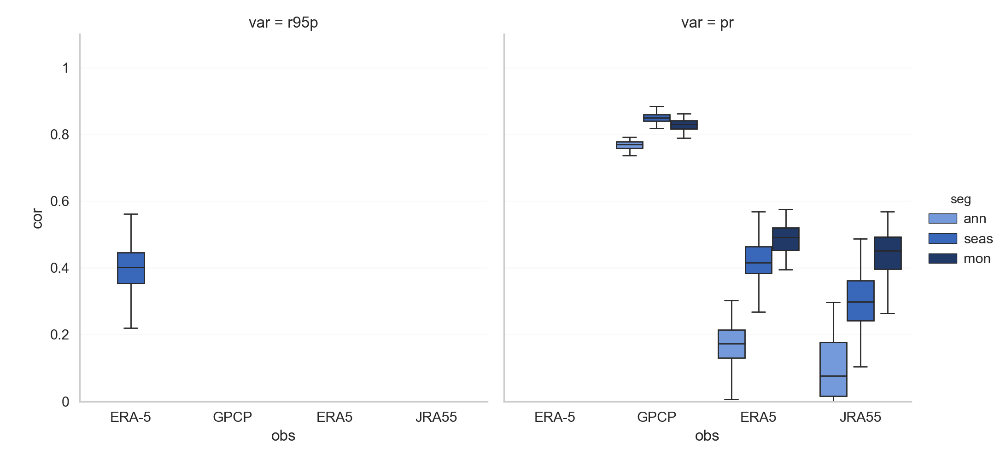

In [311]:
chvar = 'pr'
data = dfdat[(dfdat['var'] == 'pr') | (dfdat['var'] == 'r95p')]

hatchcolor = '#6d2121' #'#6d2121' # temp #'#143673' # precip # '#584116' #combined

#'#cd5d5d','#6495ed','#dda338','#b63838','#2461cf','#9a7227','#6d2121','#143673','#584116', '#FF00FF', '#b63838'

if chvar == 'tas':
    colors = ['#cd5d5d', '#b63838', '#6d2121']
elif chvar == 'pr':
    colors = ['#6495ed', '#2461cf', '#143673']
elif chvar == 'com':
    colors = ['#dda338', '#9a7227', '#584116']
elif chvar == 'r95p':
    colors = ['#FF00FF']

#enmax_palette = ['#cd5d5d', '#b63838', '#6d2121']
pp = sb.color_palette(palette=colors)

#sb.palplot(pal = pp)

#Get data in proper format
#fixed_data = list(data)
#Set up the graph parameters
plt.figure(figsize=(20,10))
sb.set(context='notebook', style='whitegrid')
#sb.axlabel(xlabel="Groups", ylabel="Y-Axis", fontsize=16)

#Plot the graph
#sb.boxplot(data=fixed_data, whis=np.inf, width=.18)
sb.catplot(x="obs", y="cor", hue="seg", col = "var", kind='box', linewidth=1,  
           data=data, palette = pp, hue_order = ['ann', 'seas', 'mon'], fliersize=0)
plt.yticks(size=12, fontweight='demibold')
plt.ylim(0,1.1)
#plt.xticks(ticks = np.arange(21), labels = titles, rotation=90);
#sb.swarmplot(data=fixed_data, size=6, edgecolor="black", linewidth=.9)
#plt.savefig(ROOT + 'plots/final_plots/' + chvar + '_correlation_boxplots_all.png', dpi=300, transparent=True)

In [1]:
# correlates = []


# var = 7
# print(list(modelstats.keys())[var]) #7-ann, 10-mon 1-seas
# for i in range(100):
#     correlates.append( float(modelstats[list(modelstats.keys())[var]][i]['model result']['obs corr (gpcp)']) )

# print('10th percentile: ', np.percentile(correlates, 10))
# print('50th percentile: ', np.mean(correlates))
# print('90th percentile: ', np.percentile(correlates, 90))
# print('STD percentile: ', np.std(correlates))

In [3]:
# modelstolookat = modelstats.keys()
modelstolookat = list(modelstats.keys())
#modelstolookat = np.array(list(modelstats.keys()))[np.array([6,7,8,0,1,12,9,10,11])] #pr/tas
#modelstolookat = np.array(list(modelstats.keys()))[np.array([0,1,-3, 2,3,-2, 4,5,-1])] #pr/tas/seas
#modelstolookat = np.array(list(modelstats.keys()))[np.array([0,3,6,9])+1]
#modelstolookat = np.array(list(modelstats.keys()))[np.array([1,3])]
modelstolookat = np.array(list(modelstats.keys()))[np.arange(9,18)]
print(modelstolookat)
print(len(modelstolookat))

["['tas-djf', 'tas-jja', 'tas-mam', 'tas-son']1"
 "['pr-djf', 'pr-jja', 'pr-mam', 'pr-son']1"
 "['pr-djf', 'pr-jja', 'pr-mam', 'pr-son', 'tas-djf', 'tas-jja', 'tas-mam', 'tas-son']1"
 "['tas-djf', 'tas-jja', 'tas-mam', 'tas-son']0.1"
 "['pr-djf', 'pr-jja', 'pr-mam', 'pr-son']0.1"
 "['pr-djf', 'pr-jja', 'pr-mam', 'pr-son', 'tas-djf', 'tas-jja', 'tas-mam', 'tas-son']0.1"
 "['tas-djf', 'tas-jja', 'tas-mam', 'tas-son']0.01"
 "['pr-djf', 'pr-jja', 'pr-mam', 'pr-son']0.01"
 "['pr-djf', 'pr-jja', 'pr-mam', 'pr-son', 'tas-djf', 'tas-jja', 'tas-mam', 'tas-son']0.01"]
9


### Do TOE plots

In [8]:
modelstolookat = np.array(list(modelstats.keys()))[np.array([6,7,8,0,1,12,9,10,11])]

In [15]:
val_rmse = dict()
val_rmse20 = dict()
val_rmse60 = dict()
obs_rmse = dict()
obs_corr = dict()
val_toe = dict()
models = dict()

for varlist in modelstolookat:
    val_rmse[varlist] = []
    val_rmse20[varlist] = []
    val_rmse60[varlist] = []
    obs_rmse[varlist] = []
    obs_corr[varlist] = []
    val_toe[varlist] = []
    models[varlist] = []
    
    # Extract 
    for i in modelstats[varlist].keys():
        val_rmse[varlist].append(modelstats[varlist][i]['model result']['val rmse'])
        val_rmse20[varlist].append(modelstats[varlist][i]['model result']['val rmse pre-2020'])
        val_rmse60[varlist].append(modelstats[varlist][i]['model result']['val rmse post-2060'])
        obs_rmse[varlist].append(modelstats[varlist][i]['model result']['obs rmse'])
        obs_corr[varlist].append(modelstats[varlist][i]['model result']['obs corr'])
        val_toe[varlist].append(modelstats[varlist][i]['model result']['TOE(5-yr val mean)'])
        models[varlist].append(modelstats[varlist][i]['dataset info']['validation model id numbers'])
    
    # Change all to numpy arrays for easier computing
    val_rmse[varlist] = np.array([float(i) for i in val_rmse[varlist]])
    val_rmse20[varlist] = np.array([float(i) for i in val_rmse20[varlist]])
    val_rmse60[varlist] = np.array([float(i) for i in val_rmse60[varlist]])
    obs_rmse[varlist] = np.array([float(i) for i in obs_rmse[varlist]])
    obs_corr[varlist] = np.array([float(i) for i in obs_corr[varlist]])
    val_toe[varlist] = np.array([float(i) for i in val_toe[varlist]])
    models[varlist] = np.array(models[varlist])

In [17]:
# Define and find the best set of models based on rank
bestmodels = dict()
top20models = dict()
top100models = dict()
numnum = 0
modelsetlist = ['tas-ann', 'pr-ann', 'pr_tas-ann', 
                'tas-seas', 'pr-seas', 'pr_tas-seas',
                'tas-month', 'pr-month', 'pr_tas-month']
#modelsetlist = ['tas-met', 'pr-met', 'pr_tas-met',
#                 'tas-alt', 'pr-alt', 'pr_tas-alt',
#                 'tas-ord', 'pr-ord', 'pr_tas-ord']
#modelsetlist = ['dd-seas-ord', 'dd-seas-met','dd-seas-alt']
#modelsetlist = ['r95p-seas-ord', 'r95p-seas-met', 'r95p-seas-alt', 'r95p-ann']
#modelsetlist = ['DJF / MAM / JJA / SON', 'DJF / MAM / JJA / SON', 'DJF / MAM / JJA / SON',
#                'FMA / MJJ / ASO / NDJ', 'FMA / MJJ / ASO / NDJ', 'FMA / MJJ / ASO / NDJ',
#                'JFM / AMJ / JAS / OND', 'JFM / AMJ / JAS/ OND', 'JFM / AMJ / JAS / OND']

for varlist in modelstolookat:
    rank = np.zeros(100)
    #rank[(-obs_corr[varlist]).argsort()] += np.arange(100) **2
    #rank[obs_rmse[varlist].argsort()] += np.arange(100) **2
    #rank[val_rmse20[varlist].argsort()] += np.arange(100)
    #rank[val_rmse60[varlist].argsort()] += np.arange(100)
    #rank[val_rmse[varlist].argsort()] += np.arange(100) **2
    rank[val_toe[varlist].argsort()] += np.arange(100) **2
    bestmodels[varlist] = rank.argsort()[5]
    top20models[varlist] = rank.argsort()[:20]
    top100models[varlist] = rank.argsort()
    print(varlist, models[varlist][bestmodels[varlist]])
    #print(rank.argsort())
    if False:
        os.system('mkdir ' + ROOT + '/playground_data/'+EXPERIMENT)
        os.system('mkdir ' + ROOT + '/playground_data/'+EXPERIMENT+'ranked_best_models/')
        f = open(ROOT + '/playground_data/'+EXPERIMENT+'ranked_best_models/' + modelsetlist[numnum] + '_models.p', 'wb')
        pickle.dump(rank.argsort(), f)
        f.close()
        numnum+=1
    #print(bestmodels[varlist])
#print(modelstats["['pr', 'tas']"][25])

['tas'] [ 9 21 22 29 27 25 17]
['pr'] [24 15 11 12 32 25  7]
['pr', 'tas'] [ 1 13 11  8 26  2 22]
['tas-djf', 'tas-jja', 'tas-mam', 'tas-son'] [17  1 13 36 10 27 14]
['pr-djf', 'pr-jja', 'pr-mam', 'pr-son'] [ 0 36  9 25  7 31  8]
['pr-djf', 'pr-jja', 'pr-mam', 'pr-son', 'tas-djf', 'tas-jja', 'tas-mam', 'tas-son'] [ 9  7 29 11 34 15 31]
['tas-01', 'tas-02', 'tas-03', 'tas-04', 'tas-05', 'tas-06', 'tas-07', 'tas-08', 'tas-09', 'tas-10', 'tas-11', 'tas-12'] [ 0  1 34 27 31 10 29]
['pr-01', 'pr-02', 'pr-03', 'pr-04', 'pr-05', 'pr-06', 'pr-07', 'pr-08', 'pr-09', 'pr-10', 'pr-11', 'pr-12'] [ 3 36 12 17 11 35 34]
['pr-01', 'pr-02', 'pr-03', 'pr-04', 'pr-05', 'pr-06', 'pr-07', 'pr-08', 'pr-09', 'pr-10', 'pr-11', 'pr-12', 'tas-01', 'tas-02', 'tas-03', 'tas-04', 'tas-05', 'tas-06', 'tas-07', 'tas-08', 'tas-09', 'tas-10', 'tas-11', 'tas-12'] [26  7 30 33 29 27  8]


In [12]:
modelstats

{"['tas-djf', 'tas-jja', 'tas-mam', 'tas-son']": {0: {'dataset info': {'training dataset': 'cmip6',
    'variables': ['tas-djf', 'tas-jja', 'tas-mam', 'tas-son'],
    'base variables': ['tas-djf', 'tas-jja', 'tas-mam', 'tas-son'],
    'resolution': 'r90x45',
    'region': 'globe-land',
    'timetype': 'annual',
    'timerange': ['1920', '2099'],
    'global mean remove': False,
    'training models': array(['ACCESS-CM2', 'ACCESS-ESM1-5', 'BCC-CSM2-MR', 'CAMS-CSM1-0',
           'CESM2-WACCM', 'CESM2', 'CMCC-CM2-SR5', 'CNRM-CM6-1-HR',
           'CNRM-ESM2-1', 'CanESM5-CanOE', 'CanESM5', 'EC-Earth3-Veg',
           'EC-Earth3', 'FGOALS-f3-L', 'FGOALS-g3', 'FIO-ESM-2-0',
           'GFDL-ESM4', 'INM-CM4-8', 'IPSL-CM6A-LR', 'KACE-1-0-G',
           'KIOST-ESM', 'MCM-UA-1-0', 'MIROC-ES2L', 'MPI-ESM1-2-HR',
           'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM', 'TaiESM1',
           'UKESM1-0-LL'], dtype='<U15'),
    'validation models': array(['HadGEM3-GC31-LL', 'HadGEM3-GC31-MM', '

/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  if sys.path[0] == '':
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:12: MatplotlibDeprecationWarning: Addin

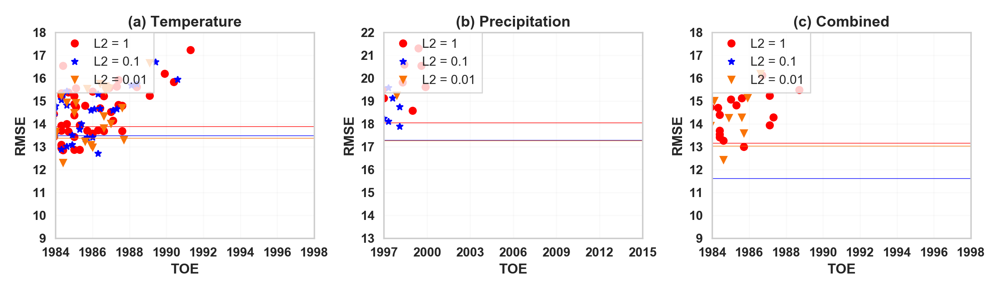

In [18]:
# Plot of RMSE versus TOE for various ridge penalties
plotnum = 0
marker = ['o', '*', 'v']
ridgepen = ['L2 = 1', 'L2 = 0.1', 'L2 = 0.01']
color = ['red', 'blue', 'orange']
titleof = ['(a) Temperature', '(b) Precipitation', '(c) Combined']
xticks = [np.arange(1984, 2000, 2), np.arange(1997, 2016, 3), np.arange(1984, 2000, 2)]
yticks = [np.arange(9, 19), np.arange(13, 23), np.arange(9, 19)]

plt.figure(figsize=(12,3.5))
for model2look in modelstolookat:
    plt.subplot(1,3,plotnum%3+1) 
    plt.plot(val_toe[model2look], val_rmse[model2look], '.', marker = marker[plotnum//3], 
             label=ridgepen[plotnum // 3], color = color[plotnum // 3])
    plt.axvline(np.mean(val_toe[model2look]), color = color[plotnum // 3], lw=.5)
    plt.axhline(np.mean(val_rmse[model2look]), color = color[plotnum // 3], lw=.5)
    plt.legend(loc=2)

    plt.ylabel('RMSE', size=12, fontweight='demi')
    plt.xlabel('TOE', size=12, fontweight='demi')
    plt.xlim(np.min(xticks[plotnum%3]), np.max(xticks[plotnum%3]))
    plt.ylim(np.min(yticks[plotnum%3]), np.max(yticks[plotnum%3]))
    plt.yticks(yticks[plotnum%3], fontsize=11, fontweight = 'demi')
    plt.xticks(xticks[plotnum%3], fontsize=11, fontweight = 'demi')
    plt.title(titleof[plotnum%3], size=13, fontweight ='demi')
    plotnum +=1
plt.tight_layout()
#plt.savefig('/Users/'+ USER + '/Rams/TOE_Research/plots/final_plots/ridge_versus_rmse.jpg', dpi=300)

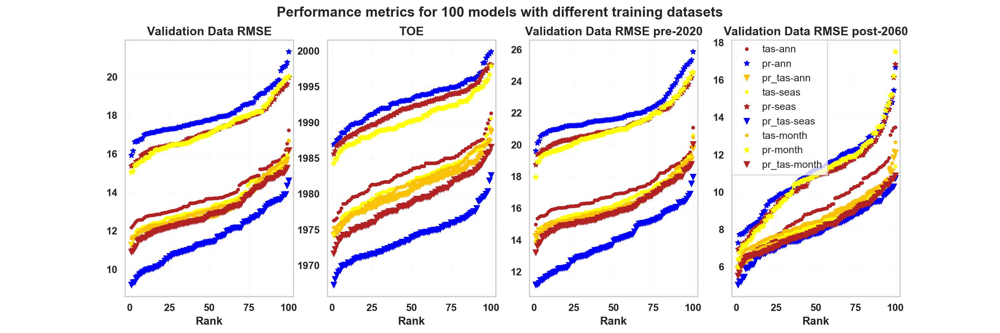

In [19]:
errorlist = [(val_rmse, 'Validation Data RMSE', 1), 
             (val_toe, 'TOE', 1),
             (val_rmse20, 'Validation Data RMSE pre-2020', 1), 
             (val_rmse60, 'Validation Data RMSE post-2060', 1)]

plt.figure(figsize=(15,5))
plotnum = 0
three_colors = ['firebrick', 'blue', 'goldenrod', 'yellow', 'orangered', 'slateblue']
linestyle = ['.', '*', 'v']
for errortype, identifier, rankorder in errorlist:
    plotnum +=1 
    plt.subplot(1,4,plotnum)  
    for i in range(len(modelstolookat)):
        varlist = list(modelstolookat)[i]
        x1 = errortype[varlist].copy()
        hundo = np.arange(100)
        plt.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.', label=modelsetlist[i], 
                 color = three_colors[i%4], marker = linestyle[i%3], markerfacecolor=None)
        #plt.plot(hundo[(x1*rankorder).argsort() == bestmodels[varlist]]+1, x1[bestmodels[varlist]], 'o', 
        #         color = three_colors[i], markerfacecolor='white', zorder=10)

        top3 = models[varlist][x1.argsort()][:3]
        plt.yticks(fontsize=11, fontweight = 'demi')
        plt.xticks(fontsize=11, fontweight = 'demi')
        #plt.legend()
        plt.xlabel('Rank', size=12, fontweight='demi')
        #plt.ylabel('Value')
        plt.title(identifier, size=13, fontweight ='demi')
        plt.xlim(-3,103)
        #plt.xlim(-3,22)
        #if plotnum in [1,2]:
        #    plt.ylim(5,21)
        if plotnum == 4:
            #plt.ylim(.85, .95)
            plt.legend()
        #plt.legend(['tas-ann', 'tas-seas', 'pr-ann', 'pr-seas', 'pr_tas-ann', 'pr_tas-seas'])
        #plt.legend(['pr-ann', 'pr-seas', 'pr_tas-ann', 'pr_tas-seas'])
        #plt.legend()    
plt.suptitle('Performance metrics for 100 models with different training datasets', 
             fontsize=15, fontweight='demi')
#plt.savefig('/Users/'+ USER + '/Rams/TOE_Research/plots/final_plots/100_random_models_metrics' \
#            + TRIALTYPE + '.jpg', dpi=300)
plt.show()

Final plot formatted here

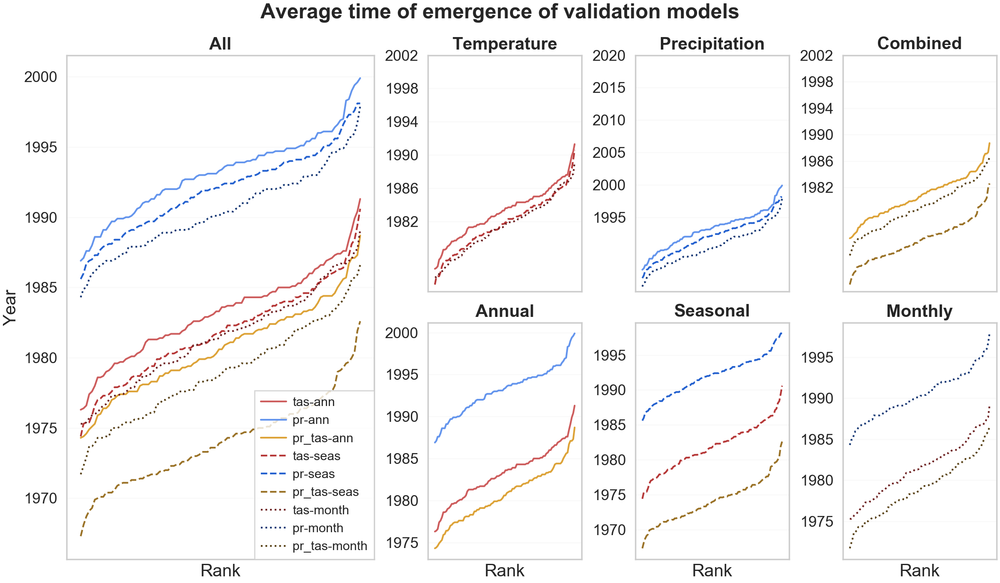

In [22]:
errorlist = [ (val_toe, 'time of emergence', 1)]#,
              #(val_rmse, 'validation data RMSE', 1)]

three_colors = ['#cd5d5d', '#6495ed', '#dda338',
                '#b63838', '#2461cf','#9a7227',
                '#6d2121', '#143673', '#584116']
linestyle = ['-', '--', ':']

for errortype, identifier, rankorder in errorlist:
    fig = plt.figure(constrained_layout=True, figsize = (12,7))
    gs = fig.add_gridspec(2, 5)

    # Setting up Axes
    ax1 = fig.add_subplot(gs[:, :2])
    ax1.set_title('All', size=15, fontweight='demi')  
    ax2 = fig.add_subplot(gs[0, 2])
    ax2.set_title('Temperature', size=15, fontweight='demi')
    ax3 = fig.add_subplot(gs[0, 3])
    ax3.set_title('Precipitation', size=15, fontweight='demi')
    ax4 = fig.add_subplot(gs[0, 4])
    ax4.set_title('Combined', size=15, fontweight='demi')
    ax5 = fig.add_subplot(gs[1, 2])
    ax5.set_title('Annual', size=15, fontweight='demi')
    ax6 = fig.add_subplot(gs[1, 3])
    ax6.set_title('Seasonal', size=15, fontweight='demi')
    ax7 = fig.add_subplot(gs[1, 4])
    ax7.set_title('Monthly', size=15, fontweight='demi')
    
    for ax in [ax1,ax2,ax3,ax4,ax5,ax6,ax7]:
        ax.set_xticks([])
        ax.tick_params(labelsize=13)

    # Plotting
    for varlist, i in zip(modelstolookat, range(len(modelstolookat))):
        x1 = errortype[varlist].copy()
        ax1.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
                 label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
        #ax1.set_ylim(1980,2020)
        ax1.set_xlabel('Rank', size=15)
        ax1.set_ylabel('Year', size=15)
        if i%3 == 0:
            ax2.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
            #ax2.set_ylim(1982,2000)
            ax2.set_yticks(np.arange(1982,2003, 4))
        if i%3 == 1:
            ax3.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
            #ax3.set_ylim(1995,1995+25)
            ax3.set_yticks(np.arange(1995,1995+26, 5))
            
        if i%3 == 2:
            ax4.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
            #ax4.set_ylim(1982,2000)
            ax4.set_yticks(np.arange(1982,2003, 4))
            
        if i//3 == 0:
            ax5.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
            #ax5.set_ylim(1980,2020)
            ax5.set_xlabel('Rank', size=15)
            
        if i//3 == 1:
            ax6.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
            #ax6.set_ylim(1980,2020)
            ax6.set_xlabel('Rank', size=15)
            
        if i//3 == 2:
            ax7.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
            #ax7.set_ylim(1980,2020)
            ax7.set_xlabel('Rank', size=15)
            
    ax1.legend()



    plt.suptitle('Average '+ identifier+' of validation models',
                size=18, fontweight='demi')
    #plt.savefig('/Users/' + USER + '/Rams/TOE_Research/plots/final_plots/avg_TOE_across_100models.png', dpi=300)

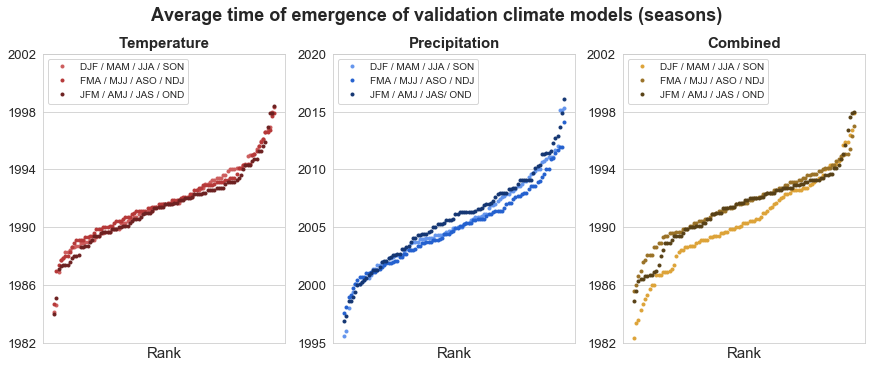

In [101]:
errorlist = [ (val_toe, 'time of emergence', 1)]#,
              #(val_rmse, 'validation data RMSE', 1)]

three_colors = ['#cd5d5d', '#6495ed', '#dda338',
                '#b63838', '#2461cf','#9a7227',
                '#6d2121', '#143673', '#584116']
linestyle = ['o', 'o', 'o']

for errortype, identifier, rankorder in errorlist:
    fig = plt.figure(constrained_layout=True, figsize = (12,5))
    gs = fig.add_gridspec(1, 3)

    # Setting up Axes 
    ax2 = fig.add_subplot(gs[0, 0])
    ax2.set_title('Temperature', size=15, fontweight='demi')
    ax3 = fig.add_subplot(gs[0, 1])
    ax3.set_title('Precipitation', size=15, fontweight='demi')
    ax4 = fig.add_subplot(gs[0, 2])
    ax4.set_title('Combined', size=15, fontweight='demi')
    
    for ax in [ax2,ax3,ax4]:
        ax.set_xticks([])
        ax.tick_params(labelsize=13)
        ax.set_xlabel('Rank', size=15)

    # Plotting
    for varlist, i in zip(modelstolookat, range(len(modelstolookat))):
        x1 = errortype[varlist].copy()
        #ax1.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
        #         label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
        #ax1.set_ylim(1980,2020)
        #ax1.set_xlabel('Rank', size=15)
        #ax1.set_ylabel('Year', size=15)
        if i%3 == 0:
            ax2.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.', marker=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None, ms=3)
            ax2.set_ylim(1982,2000)
            ax2.set_yticks(np.arange(1982,2003, 4))
        if i%3 == 1:
            ax3.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.',marker=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None, ms=3)
            ax3.set_ylim(1995,1995+25)
            ax3.set_yticks(np.arange(1995,1995+26, 5))
            
        if i%3 == 2:
            ax4.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.',marker=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None, ms=3)
            ax4.set_ylim(1982,2000)
            ax4.set_yticks(np.arange(1982,2003, 4))
    ax4.legend(loc='upper left')      
    ax2.legend(loc='upper left')
    ax3.legend(loc='upper left')



    plt.suptitle('Average '+ identifier+' of validation climate models (seasons)',
                size=18, fontweight='demi')
    #plt.savefig('/Users/' + USER + '/Rams/TOE_Research/plots/final_plots/avg_TOE_across_100models_compareseasons.png', dpi=300)

In [84]:
modelsetlist

['tas-ann',
 'pr-ann',
 'pr_tas-ann',
 'tas-seas',
 'pr-seas',
 'pr_tas-seas',
 'tas-month',
 'pr-month',
 'pr_tas-month']

In [ ]:
errorlist = [ (val_toe, 'time of emergence', 1)]#,
              #(val_rmse, 'validation data RMSE', 1)]

three_colors = ['#cd5d5d', '#6495ed', '#dda338',
                '#b63838', '#2461cf','#9a7227',
                '#6d2121', '#143673', '#584116']
linestyle = ['o', 'o', 'o']

for errortype, identifier, rankorder in errorlist:
    fig = plt.figure(constrained_layout=True, figsize = (12,9))
    gs = fig.add_gridspec(2, 3)

    # Setting up Axes 
    ax2 = fig.add_subplot(gs[0, 0])
    ax2.set_title('Temperature', size=15, fontweight='demi')
    ax3 = fig.add_subplot(gs[0, 1])
    ax3.set_title('Precipitation', size=15, fontweight='demi')
    ax4 = fig.add_subplot(gs[0, 2])
    ax4.set_title('Combined', size=15, fontweight='demi')
    ax5 = fig.add_subplot(gs[1, 0])
    ax5.set_title('Annual', size=15, fontweight='demi')
    ax6 = fig.add_subplot(gs[1, 1])
    ax6.set_title('Seasonal', size=15, fontweight='demi')
    ax7 = fig.add_subplot(gs[1, 2])
    ax7.set_title('Monthly', size=15, fontweight='demi')
    
    for ax in [ax2,ax3,ax4,ax5,ax6,ax7]:
        ax.set_xticks([])
        ax.tick_params(labelsize=13)

    # Plotting
    for varlist, i in zip(modelstolookat, range(len(modelstolookat))):
        x1 = errortype[varlist].copy()
        #ax1.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], ls=linestyle[i//3], 
        #         label=modelsetlist[i], color = three_colors[i], markerfacecolor=None)
        #ax1.set_ylim(1980,2020)
        #ax1.set_xlabel('Rank', size=15)
        #ax1.set_ylabel('Year', size=15)
        if i%3 == 0:
            ax2.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.', marker=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None, ms=3)
            ax2.set_ylim(1982,2000)
            ax2.set_yticks(np.arange(1982,2003, 4))
        if i%3 == 1:
            ax3.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.',marker=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None, ms=3)
            ax3.set_ylim(1995,1995+25)
            ax3.set_yticks(np.arange(1995,1995+26, 5))
            
        if i%3 == 2:
            ax4.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.',marker=linestyle[i//3], 
                     label=modelsetlist[i], color = three_colors[i], markerfacecolor=None, ms=3)
            ax4.set_ylim(1982,2000)
            ax4.set_yticks(np.arange(1982,2003, 4))
            
    #ax1.legend()



    plt.suptitle('Average '+ identifier+' of validation climate models',
                size=18, fontweight='demi')
    #plt.savefig('/Users/' + USER + '/Rams/TOE_Research/plots/final_plots/avg_TOE_across_100models_6frame.png', dpi=300)

In [140]:
val_toes = []
for varlist in modelstolookat: # modelstolookat[3:6]:
    print(varlist)
    print(top100models[varlist])
    thisval_toes = []
    for modnum in top100models[varlist]:
        thisval_toes.extend(modelstats[varlist][modnum]['model result']['TOE(val)'])
    val_toes.append(thisval_toes)

['r95p-djf', 'r95p-jja', 'r95p-mam', 'r95p-son']
[80 62 86 81 64 59 61 72 38 91 36 47 21 25 31 27 26  3 22 14 95 76 18 29
  6 40 35 33 87 67 20 50 97 46 92 74  7 19 68 30 53 13 63  4 15 69 82 10
 85 51  0 66 28 98 90 17 94 84 55 45  2 52 57 58 79 43 37 71 32 93 77 54
  5 49 41 16 83 73 42 75 96 56 60 65 11 70 99 78 39  1 34 23 88  9 89 48
 12 24  8 44]
['r95p']
[ 5 91 31 36 40 87 80 64 72 47 26 10 86 25 19  6 81 76 61  3 73 97 22 62
 59 38 95 17 70 50 93 35 39 55 43 13  4 69 46 99 58 82 21 52 27 20 29 16
 14 11 94 78 71 83 37  0 41 33 63 49 79  2 75  8 90 30 54 66 92 60 57 96
 85 68  7 67 98 84 42 88 74 48 28 53 18 51 23 56 45 15 89 32 34 12 24 77
  9  1 65 44]


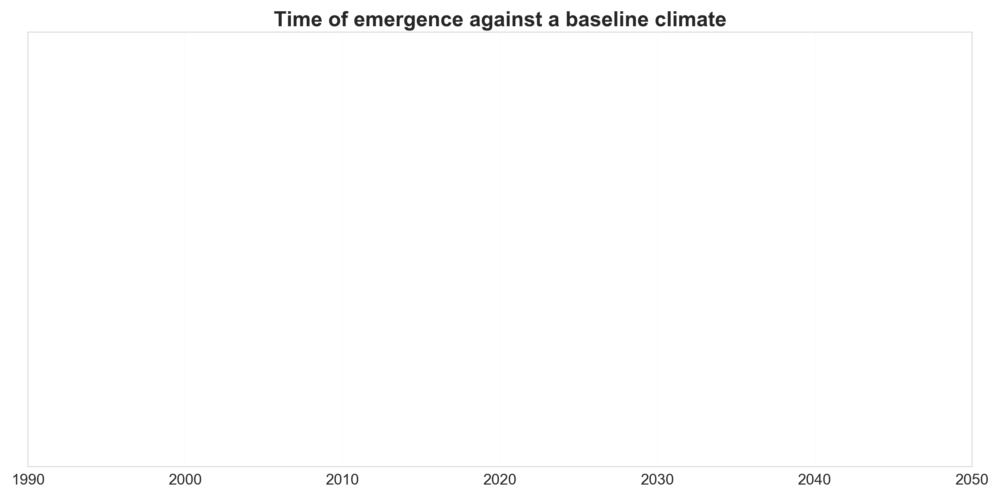

In [149]:
palette = ['#b63838','#2461cf', '#9a7227'] 
palette = ['#9a7227']
palette = ['#FF00FF']
plt.figure(figsize=(12,6))
mydata=np.array(val_toes).T
mydata2 = np.full((mydata.shape[0], mydata.shape[1] *2), np.nan)

for i in range(mydata.shape[1]):
    mydata2[:,i*2] = mydata[:,i].copy()
    
mydata2 = mydata.copy().astype(float)

myswarmdata2 = []
for i in range(mydata2.shape[1]):
    myswarmdata2.append([])
    for j in np.unique(mydata2[:,i]):
        div = 5
        orignumdots = len(mydata2[:,i][mydata2[:,i] == j])
        numdots = orignumdots // div + int(orignumdots % div > 0) 
        myswarmdata2[i].extend([j] * numdots)
    myswarmdata2[i] = np.array(myswarmdata2[i])
        
for i in range(len(myswarmdata2)):
    for j in np.unique(myswarmdata2[i]):
        if len(myswarmdata2[i][myswarmdata2[i] == j]) > 10:
            myswarmdata2[i][myswarmdata2[i] == j] = myswarmdata2[i][myswarmdata2[i] == j] \
            + np.random.choice([.25, -.25], size=myswarmdata2[i][myswarmdata2[i] == j].shape)

sb.swarmplot(data=myswarmdata2, orient='h', zorder=2, color='k', size=3.5)
#sb.violinplot(data=mydata, boxprops={'facecolor':'None'}, orient='h', zorder=2, showfliers=True)
sb.boxplot(data=mydata2, orient='h', zorder=1, showfliers=False, palette = palette)

#plt.yticks(ticks = np.arange(3), labels=['temperature', 'precipitation', 'combined'], size=15)

plt.xlim(1990,2050)
plt.title('Time of emergence against a baseline climate', fontweight = 'demi', size=18)
plt.xticks(np.arange(1990,2051,10), size=13)
plt.yticks([])
plt.tight_layout()
#plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/comparing_seasons_pr_tas.png', dpi=300)
plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/comparing_season_annual_r95p.png', dpi=300)

In [145]:
for j in mydata.T:
    print('Min: ', np.min(j))
    print('25th Percentile: ', np.percentile(j, 25))
    print('Mean: ', np.median(j))
    print('75th Percentile: ', np.percentile(j, 75))
    print('Max: ', np.max(j))
    print()
mydata.shape + (0,2)

Min:  1997
25th Percentile:  2010.0
Mean:  2017.0
75th Percentile:  2023.0
Max:  2042

Min:  1999
25th Percentile:  2014.0
Mean:  2018.5
75th Percentile:  2024.25
Max:  2037



(600, 2, 0, 2)

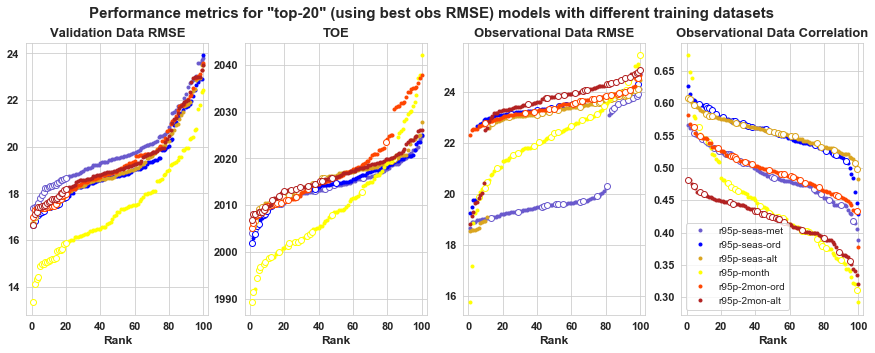

In [9]:
errorlist = [(val_rmse, 'Validation Data RMSE', 1), 
             (val_toe, 'TOE', 1), 
             (obs_rmse, 'Observational Data RMSE', 1), 
             (obs_corr, 'Observational Data Correlation', -1)]
modelsetlist = ['r95p-seas-met', 'r95p-seas-ord', 'r95p-seas-alt', 'r95p-month', 'r95p-2mon-ord', 'r95p-2mon-alt']
plt.figure(figsize=(15,5))
plotnum = 0
three_colors = ['slateblue', 'blue', 'goldenrod', 'yellow', 'orangered', 'firebrick']
for errortype, identifier, rankorder in errorlist:
    plotnum +=1 
    plt.subplot(1,4,plotnum)  
    for i in range(len(modelstolookat)):
        varlist = list(modelstolookat)[i]
        x1 = errortype[varlist].copy()
        x2 = errortype[varlist].copy()
        x2[top100models[varlist][20:]] = np.nan
        
        hundo = np.arange(100)
        plt.plot(np.arange(len(x1))+1, x1[(x1*rankorder).argsort()], '.', label=modelsetlist[i], 
                 color = three_colors[i], markerfacecolor=None)
        plt.plot((np.arange(len(x1))+1), x2[(x1*rankorder).argsort()], 'o', label=None, 
                 color = three_colors[i], markerfacecolor='white')
        #plt.plot(hundo[(x1*rankorder).argsort() == bestmodels[varlist]]+1, x1[bestmodels[varlist]], 'o', 
        #         color = three_colors[i], markerfacecolor='white', zorder=10)

        top3 = models[varlist][x1.argsort()][:3]
        plt.yticks(fontsize=11, fontweight = 'demi')
        plt.xticks(fontsize=11, fontweight = 'demi')
        #plt.legend()
        plt.xlabel('Rank', size=12, fontweight='demi')
        #plt.ylabel('Value')
        plt.title(identifier, size=13, fontweight ='demi')
        plt.xlim(-3,103)
        #if plotnum in [1,2]:
        #    plt.ylim(5,21)
        if plotnum == 4:
            #plt.ylim(.85, .95)
            plt.legend()
        #plt.legend(['tas-ann', 'tas-seas', 'pr-ann', 'pr-seas', 'pr_tas-ann', 'pr_tas-seas'])
        #plt.legend(['pr-ann', 'pr-seas', 'pr_tas-ann', 'pr_tas-seas'])
        #plt.legend()    
plt.suptitle('Performance metrics for "top-20" (using best obs RMSE) models with different training datasets', 
             fontsize=15, fontweight='demi')
#plt.savefig('/Users/'+ USER + '/Rams/TOE_Research/plots/final_plots/100_random_models_metrics' \
#            + TRIALTYPE + '.jpg', dpi=300)
plt.show()

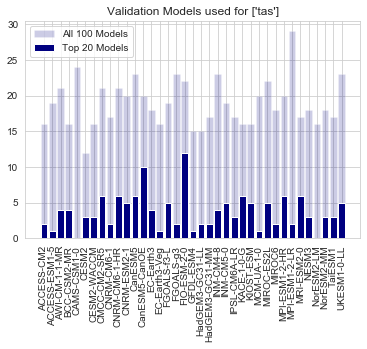

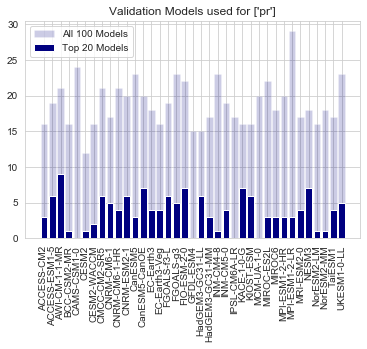

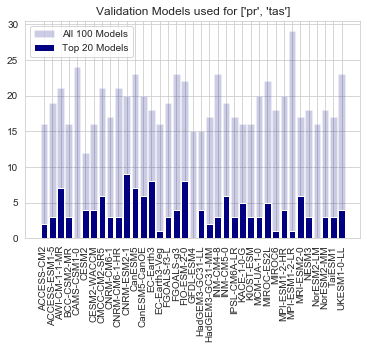

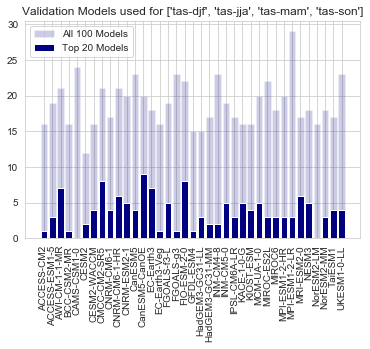

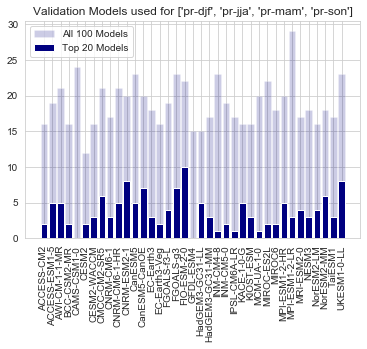

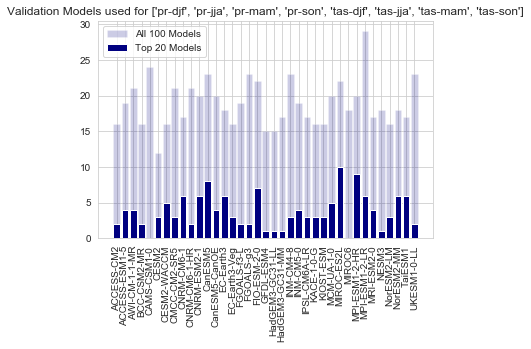

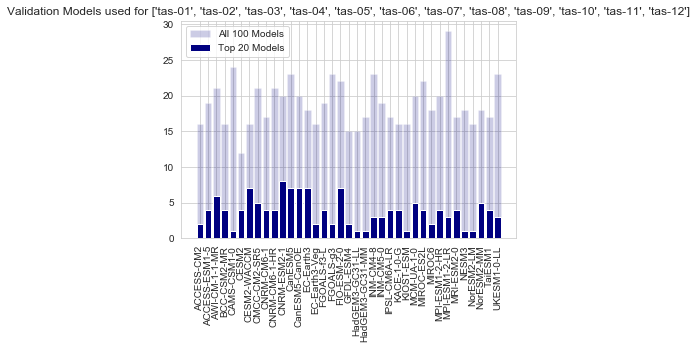

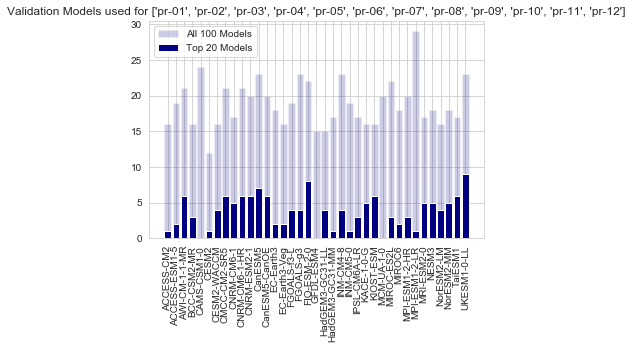

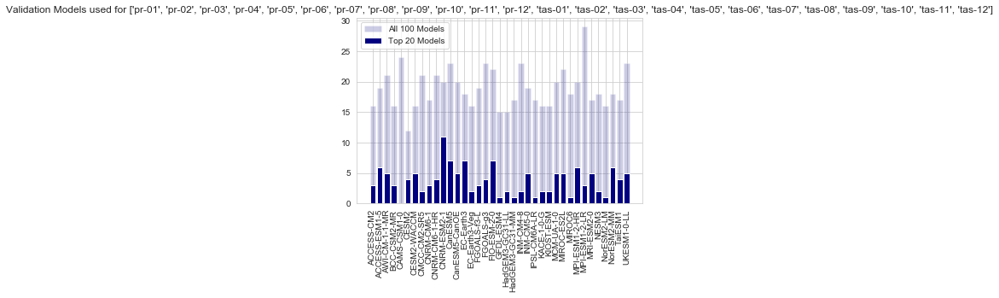

In [27]:
all_models = sorted(['ACCESS-CM2', 'ACCESS-ESM1-5', 'AWI-CM-1-1-MR', 'BCC-CSM2-MR',
       'CAMS-CSM1-0', 'CESM2-WACCM', 'CESM2', 'CMCC-CM2-SR5',
       'CNRM-CM6-1-HR', 'CNRM-CM6-1', 'CanESM5-CanOE', 'EC-Earth3-Veg',
       'EC-Earth3', 'FGOALS-g3', 'GFDL-ESM4', 'HadGEM3-GC31-LL',
       'HadGEM3-GC31-MM', 'INM-CM4-8', 'IPSL-CM6A-LR', 'KACE-1-0-G',
       'KIOST-ESM', 'MCM-UA-1-0', 'MIROC-ES2L', 'MPI-ESM1-2-HR',
       'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM', 'TaiESM1',
       'UKESM1-0-LL', 'CNRM-ESM2-1', 'CanESM5', 'FGOALS-f3-L', 'FIO-ESM-2-0',
       'INM-CM5-0', 'MIROC6', 'MPI-ESM1-2-LR'])


for varlist in modelstolookat:
    lst = []
    lst1 = []
    plt.title('Validation Models used for ' + str(varlist))
    for m in top20models[varlist]:
        lst.extend(models[varlist][m])
    for m in top100models[varlist]:
        lst1.extend(models[varlist][m])
    x1, y1 = np.unique(lst1, return_counts=True)
    plt.bar(x1,y1, color = 'navy', alpha = .2)
    plt.xticks(ticks = range(37), labels = all_models, rotation=90)
    x, y = np.unique(lst, return_counts=True)
    plt.bar(x,y, color = 'navy')
    plt.legend(['All 100 Models', 'Top 20 Models'])
    plt.show()

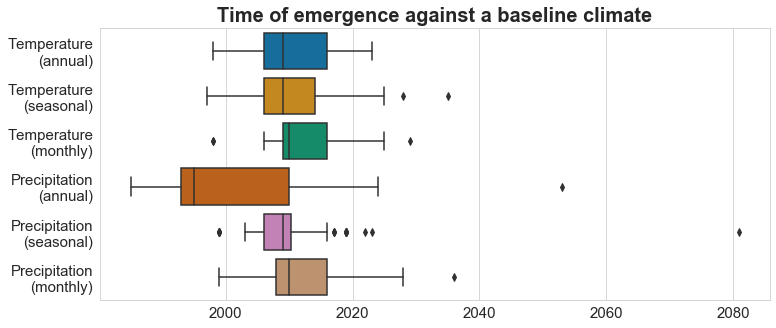

In [71]:
toe_array_list = []
for key in top20models.keys():
    top20 = top20models[key]
    toe_array = np.array([])
    for mn in top20:
        toes = modelstats[key][mn]['model result']['TOE(val)']
        toe_array = np.append(toe_array, toes)
    toe_array_list.append(toe_array)
        
plt.figure(figsize = (12,5))
ax = sb.boxplot(data=toe_array_list, orient='h')
plt.yticks([0,1,2,3,4,5], ['Temperature\n(annual)', 'Temperature\n(seasonal)', 'Temperature\n(monthly)',
                            'Precipitation\n(annual)', 'Precipitation\n(seasonal)','Precipitation\n(monthly)'],
          size=15, rotation=0)
plt.xticks(size=15)
plt.title('Time of emergence against a baseline climate',fontweight='demi', size=20)
plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/example_TOE_boxplot.png', dpi=300)



In [14]:
modelstats["['r95p-djf', 'r95p-jja', 'r95p-mam', 'r95p-son']"]

{0: {'dataset info': {'training dataset': 'cmip6',
   'variables': ['r95p-djf', 'r95p-jja', 'r95p-mam', 'r95p-son'],
   'resolution': 'r240x120',
   'region': 'americas-land',
   'timetype': 'annual',
   'timerange': ['1920', '2099'],
   'global mean remove': False,
   'training models': array(['ACCESS-CM2', 'ACCESS-ESM1-5', 'BCC-CSM2-MR', 'CESM2-WACCM',
          'CMCC-CM2-SR5', 'CNRM-CM6-1-HR', 'CNRM-CM6-1', 'CNRM-ESM2-1',
          'CanESM5', 'EC-Earth3-Veg', 'EC-Earth3', 'FGOALS-g3', 'GFDL-CM4',
          'GFDL-ESM4', 'HadGEM3-GC31-MM', 'INM-CM5-0', 'IPSL-CM6A-LR',
          'KIOST-ESM', 'MIROC-ES2L', 'MIROC6', 'MPI-ESM1-2-HR',
          'MPI-ESM1-2-LR', 'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM',
          'TaiESM1', 'UKESM1-0-LL'], dtype='<U15'),
   'validation models': array(['CESM2', 'KACE-1-0-G', 'INM-CM4-8', 'HadGEM3-GC31-LL'],
         dtype='<U15'),
   'validation model id numbers': [4, 20, 17, 15]},
  'model info': {'epochs': 150,
   'act func': 'relu',
   'ridge pe

# LRP versus Signal to Noise

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import os
from sklearn import linear_model
from cartopy.util import add_cyclic_point as acp
import cartopy
import cartopy.crs as ccrs
import seaborn as sb
from matplotlib.colors import ListedColormap
import scipy.stats as ss
import proplot
sb.set_style('white')

/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The examples.directory rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2. In the future, examples will be found relative to the 'datapath' directory.
  self[key] = other[key]


In [38]:
USER = 'Jamin'
ROOT = '/Users/' + USER+ '/Rams/TOE_Research/'
RES = 'r90x45'
LATRANGE = [-90,90]
LONRANGE = [0,360]
EXPERIMENT_NAME = 'pr_tas_final_globe-land'
MODEL_SET = 'pr_tas-seas-met_models'
VAR = 'tas-mam'
NORM = 'onemap'
YEAR = 2090
REF_YEAR = 1920

if '-' in VAR:
    periodstr = VAR.split('-')[1].upper()
else:
    periodstr = 'Annual Mean'
    
if VAR.startswith('tas'):
    varstr = 'Temperature'
else:
    varstr = 'Precipitation'

In [39]:
def get_lrp_data():
    #lrpdict = np.load(ROOT + 'plots/classification_topmodels/lrp/' + EXPERIMENT_NAME + '/' + MODEL_SET + '/' \
    #                  + 'model=' + MODEL_SET + '_var=' + VAR + '_time=' + str(YEAR) + '_norm=' + NORM + '.npz')
    lrpdict = np.load(ROOT + 'plots/classification_topmodels/lrp/' + EXPERIMENT_NAME + '/' + MODEL_SET + '/' \
                      + 'npzdata/lrp_' + str(YEAR) + '_' + VAR + '.npz')
    #lrpdata, lrplons, lrplats = lrpdict['lrp'], lrpdict['lons'], lrpdict['lats']
    return lrpdict['lrp'], lrpdict['lons'], lrpdict['lats']

def open_climate_model_data():

    fn_list = []
    dirr = ROOT + 'data/netcdfFiles_' + RES + '/cmip6/'+VAR+'/'
    for fn in os.listdir(dirr):
        if fn.endswith('nc'):
            fn_list.append(dirr + fn)
    ds = []
    yr_beg = 1920
    yr_end = 2099
    for fn in fn_list:
        dd = xr.open_dataset(fn)
        dd = dd[VAR].sel(time=slice(str(yr_beg),str(yr_end))).sel(lon=slice(LONRANGE[0],LONRANGE[1]))\
                      .sel(lat=slice(LATRANGE[0],LATRANGE[1]))
        lons = dd.lon.sel(lon=slice(LONRANGE[0],LONRANGE[1])).values
        lats = dd.lat.sel(lat=slice(LATRANGE[0],LATRANGE[1])).values
        dd = dd.groupby("time.year").mean("time").values

        ds.append(dd)
    years = np.arange(yr_beg,yr_end+1)
    ds_orig = np.reshape(ds, (np.shape(ds)[0], np.shape(ds)[1], -1))
    return ds_orig, years, lats, lons

def remove_mean_1980_2019(ds_orig, years):
    # Removing mean 1980-2020
    logic = np.logical_and(years >= 1980, years < 2020)
    ds = ds_orig - np.stack(len(years)*[np.mean(ds_orig[:,logic,:], axis=1)], axis=1)
    return ds

def calc_polynomial(ds, years, deg=4):
    # Okay, the first thing to do is to calculate the 4th-order polynomial 
    # re: Hawkins and Sutton 2009 THE POTENTIAL TO NARROW UNCERTAINTY IN REGIONAL CLIMATE PREDICTIONS
    fo_ds = np.zeros(np.shape(ds))
    P = np.power(years.reshape((-1,1)),np.arange(4,-1, -1).reshape((-1,1)).T)
    for mod in range(len(ds)):
        coeffs = np.polyfit(years, ds[mod], deg=4)
        fo_ds[mod] = P @ coeffs
    return fo_ds

def calc_variability(fo_ds, years):
    # Calculating Internal Variability 
    #twentyfirst_logic = np.logical_and(years >= REF_YEAR, years < 2100)
    detrended = ds - fo_ds

    internal_variability = np.mean(np.var(detrended, axis=1), axis=0) # Assume constant in time
    inter_model_variability = np.var(fo_ds[:, np.where(years == YEAR), :] 
                                     - fo_ds[:, np.where(years == REF_YEAR), :], axis=(0))
    
    # Signal
    signal = abs(np.mean(fo_ds[:,np.where(years == YEAR),:],axis=0) - \
                 np.mean(fo_ds[:,np.where(years == REF_YEAR),:],axis=0))

    # Convert to total variance standard deviation and find 90th percentile (Z = 1.65)
    noise90 = 1.65 * np.sqrt(internal_variability + inter_model_variability)
    internalnoise90 = 1.65 * np.sqrt(internal_variability)
    modelnoise90 = 1.65 * np.sqrt(inter_model_variability)

    SNratio = signal / noise90
    SNmodel = signal / modelnoise90
    SNinternal = signal / internalnoise90
    
    return SNratio, SNmodel, SNinternal

def get_significant_relevance(thresh):
    global VAR
    orig_var = VAR
    datalist = []
    if '-' in orig_var:
        for VAR in [orig_var.split('-')[0] + sss for sss in ['-djf', '-mam', '-jja', '-son']]:
            print(VAR, end=' ')
            datalist.append(get_lrp_data()[0])
    else:
        datalist = get_lrp_data()[0]
    VAR = orig_var
    print(VAR)
    return np.nanquantile(datalist, thresh)

def get_total_relevance():
    global VAR
    orig_var = VAR
    datalist = []
    if '-' in orig_var:
        for VAR in [orig_var.split('-')[0] + sss for sss in ['-djf', '-mam', '-jja', '-son']]:
            print(VAR, end=' ')
            datalist.append(get_lrp_data()[0])
    else:
        datalist = get_lrp_data()[0]
    VAR = orig_var
    print(VAR)
    return np.nansum(datalist)

In [40]:
lrpdata, lrplons, lrplats = get_lrp_data()
LATRANGE, LONRANGE = [np.min(lrplats), np.max(lrplats)], [np.min(lrplons), np.max(lrplons)]
ds_orig, years, lats, lons = open_climate_model_data()
ds = remove_mean_1980_2019(ds_orig, years)
fo_ds = calc_polynomial(ds, years)
SNratio, SNmodel, SNinternal = calc_variability(fo_ds, years)
print(SNratio.shape)

(1, 1, 4050)


In [63]:
USER = 'Jamin'
RES = 'r90x45'
ROOT = '/Users/' + USER + '/Rams/TOE_Research/' # root directory for the whole project
PATH = ROOT + 'data/' # the path of the netCDF files (before PRIM)
MASK = PATH + 'landmask/landmask_nopole_' + RES + '.npz'
mask = np.load(MASK)
print(np.sum(tempmap['MAM Temperature'].flatten()[mask['mask'].flatten()] \
    >= tempmap['MAM Precipitation'].flatten()[mask['mask'].flatten()]))
print(np.sum(mask['mask'].flatten()))

948
948


tas-djf tas-mam tas-jja tas-son tas-mam


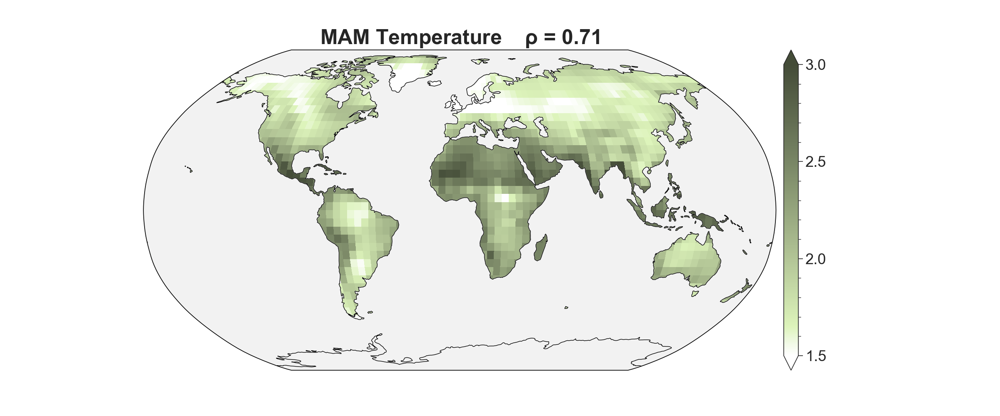

In [42]:
# Convert any nans in LRP data to 0
lrpdata[np.isnan(lrpdata)] = 0

# Some hatch specs
hatchcolor = '#6d2121' #'#6d2121' # temp #'#143673' # precip # '#584116' #combined

if MODEL_SET == 'tas-ann_models':
    hatchcolor = '#6d2121'
elif MODEL_SET == 'pr-ann_models':
    hatchcolor = '#143673'
else:
    hatchcolor = '#584116'

lrpthresh = get_significant_relevance(.75) #.0003 #combined-seas-precip #.0025 #combined-seas-temp #.007 # temp-ann #.01 #precip-ann 
lrpmax = 5 * lrpthresh

plt.rcParams['hatch.color'] = hatchcolor
plt.rcParams['hatch.linewidth'] = .7

# Signal to Noise (internal + model variability) Ratio
data = SNratio.reshape(len(lats), len(lons))
    
plt.figure(figsize=(12,5))
plotdata, cyc_lons = acp(data, coord=lons)
ax = plt.axes(projection=ccrs.Robinson())

snr_lats = lats[lats > -60]
snr_plotdata = plotdata[lats > -60,:]

if varstr == 'Temperature':
    vmin = 1.5; vmax = 3; tickys = [1.5, 2, 2.5, 3];
elif varstr == 'Precipitation':
    vmin = 0; vmax = 1.5; tickys = [0, .5, 1, 1.5];

plt.pcolormesh(cyc_lons, snr_lats, snr_plotdata, transform=ccrs.PlateCarree(), 
               cmap=proplot.Colormap('#444C38'), 
               vmin = vmin, vmax=vmax) #vmax = 1.7, vmin=0 for precip #vmax = 4.4, vmin = 1 for temperature
cb = plt.colorbar(pad=0.01, extend='both')
cb.ax.tick_params(labelsize=13)
cb.set_ticks(tickys)
#cb.set_ticks([0,0.5,1,1.5])
levels = [0, lrpthresh, np.max(lrpdata)]
#levels = [0, .0002, 1]
#plt.contour(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), levels=levels,colors='firebrick',linewidths=.5)
#lrpdata[np.isnan(lrpdata)] = 0

# The following is cool
plt.contourf(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), 
            levels=levels, hatches=['',''], alpha = 0)
#plt.plot([],[], '', color = hatchcolor, label = 'high relevance')
#plt.contour(lrplons, lrplats, lrpdata, colors = hatchcolor, transform=ccrs.PlateCarree(), 
#             levels=levels[1:], linewidths=.75)


ax.coastlines(zorder=2, linewidth = .5)
ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='.95')
ax.add_feature(cartopy.feature.LAND, zorder=0,facecolor='.95')

#plt.xlim(-170, -25)
#plt.ylim(-90, 90)
#plt.legend(loc='center left', bbox_to_anchor=(.02, .5)) # Plots the legend if doing hatching
#plt.title('(b) temperature signal-to-noise ratio', size=13, fontweight='demi')
plt.title(str(YEAR) + ' ' + VAR + ' signal-to-noise ratio from ' + MODEL_SET, size=18, fontweight='demi')


# Calculate the spearman value
spear_r, spear_p = ss.spearmanr(data[lrpdata[:,:-1] > 0].flatten(), b=lrpdata[:,:-1][lrpdata[:,:-1] > 0])

plt.title(periodstr + ' ' + varstr + '    ' + r"$\rho$" + ' = %.2f' %spear_r, size=18, fontweight='demi')

#plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/signal-noise-ratio-' + MODEL_SET + '-' + \
#            VAR + str(YEAR) + '.jpg', 
#            dpi=300, bboxes_inches='tight')

"""
# Signal to Noise (internal variability) Ratio
data = SNinternal.reshape(len(lats), len(lons))
    
plt.figure(figsize=(12,5))
plotdata, cyc_lons = acp(data, coord=lons)
ax = plt.axes(projection=ccrs.PlateCarree())
plt.pcolormesh(cyc_lons, lats, plotdata, transform=ccrs.PlateCarree(), cmap='Blues')
cb = plt.colorbar(pad=0.01, extend='max')
cb.ax.tick_params(labelsize=12)
#cb.set_ticks([0,1,2,3])
#plt.contour(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), levels=[.2,1],colors='black',linewidths=.5)
plt.contourf(cyc_lons, lats, lrpdata, transform=ccrs.PlateCarree(), 
            levels=[0,.1,1], hatches=['','..'], alpha = 0)
ax.coastlines(zorder=2, linewidth = .5)
ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='white')
plt.title('Signal-to-noise ratio (internal), CMIP6 near-surface air temperature', size=14)

# Signal to Noise (internal + model variability) Ratio
data = SNmodel.reshape(len(lats), len(lons))
    
plt.figure(figsize=(12,5))
plotdata, cyc_lons = acp(data, coord=lons)
ax = plt.axes(projection=ccrs.PlateCarree())
plt.pcolormesh(cyc_lons, lats, plotdata, transform=ccrs.PlateCarree(), cmap='Blues')
cb = plt.colorbar(pad=0.01, extend='max')
cb.ax.tick_params(labelsize=12)
#cb.set_ticks([0,1,2,3])
#plt.contour(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), levels=[.2,1],colors='black',linewidths=.5)
plt.contourf(cyc_lons, lats, lrpdata, transform=ccrs.PlateCarree(), 
            levels=[0,.1,1], hatches=['','..'], alpha = 0)
ax.coastlines(zorder=2, linewidth = .5)
ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='white')
plt.title('Signal-to-noise ratio (model), CMIP6 near-surface air temperature', size=14)


""";

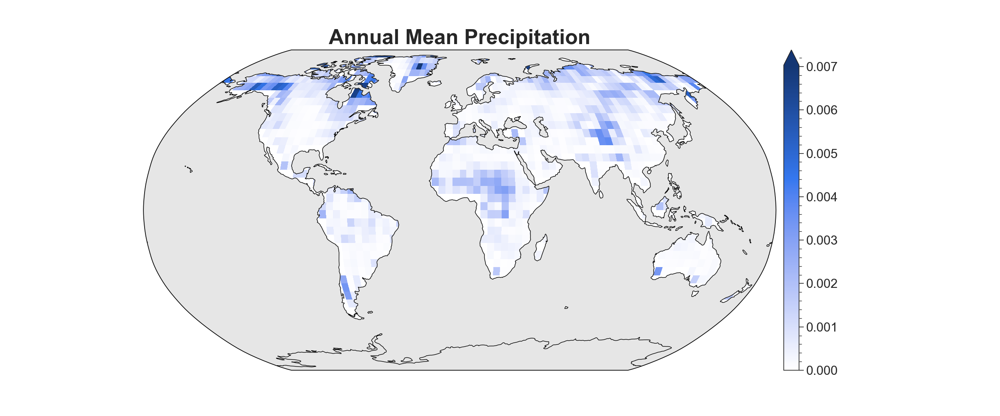

In [117]:
# Some hatch specs
#hatchcolor = '#143673' #'#6d2121' # temp #'#143673' # precip # '#584116' #combined
#lrpmax = .001 #combined-seas-precip #.0025 #combined-seas-temp #.007 # temp-ann #.01 #precip-ann 

lrpcm = proplot.Colormap(hatchcolor)

plt.figure(figsize=(12,5))

lrplatsplot = lrplats[lats > -60]
lrpdataplot = lrpdata[lats > -60,:]

ax = plt.axes(projection=ccrs.Robinson())
plt.pcolormesh(lrplons, lrplatsplot, lrpdataplot, transform=ccrs.PlateCarree(), 
               cmap=lrpcm, vmax = lrpmax)

cb = plt.colorbar(pad=0.01, extend='max')
cb.ax.tick_params(labelsize=11)
#cb.set_ticks([])
#cb.set_ticks([.5, 1, 1.5, 2, 2.5 ,3])

plt.contourf(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), 
            levels=levels, hatches=['',''], alpha = 0) # THis one just makes sure the earth shape is right

ax.coastlines(zorder=2, linewidth = .5)
ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='.9')
ax.add_feature(cartopy.feature.LAND, zorder=0,facecolor='.9')
#ax.add_feature(cartopy.feature.BORDERS)
#plt.xlim(-170, -25)
#plt.ylim(-60, 90)
#plt.legend(loc='center left', bbox_to_anchor=(0, .5))
#plt.title('(b) temperature signal-to-noise ratio', size=13, fontweight='demi')
plt.title(str(YEAR) + ' ' + VAR + ' signal-to-noise ratio from ' + MODEL_SET, size=18, fontweight='demi')
plt.title(periodstr + ' ' + varstr, size=18, fontweight='demi')
#plt.title(VAR, size=18, fontweight='demi')
plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/relevance-' + MODEL_SET + '-' + \
            VAR + str(YEAR) + '.jpg', 
            dpi=300, bboxes_inches='tight')

In [133]:
get_total_relevance()

pr-djf pr-mam pr-jja pr-son pr-son


0.05946238739375076

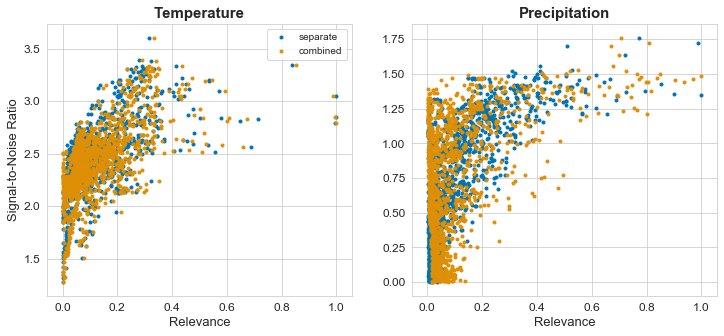

In [53]:
EXPERIMENT_NAME = 'tas_pr_globe-land'
model_set_list = ['tas-ann_models','pr_tas-ann_models', 'pr-ann_models', 'pr_tas-ann_models']
var_list = ['tas', 'tas', 'pr', 'pr']

fig, axs = plt.subplots(1,2, figsize=(12,5))

datai = 0
for ax in axs.flatten():

    VAR = var_list[datai]
    MODEL_SET = model_set_list[datai]
    
    # Calculate SN Ratio
    LATRANGE, LONRANGE = [np.min(lrplats), np.max(lrplats)], [np.min(lrplons), np.max(lrplons)]
    ds_orig, years, lats, lons = open_climate_model_data()
    ds = remove_mean_1980_2019(ds_orig, years)
    fo_ds = calc_polynomial(ds, years)
    SNratio, SNmodel, SNinternal = calc_variability(fo_ds, years)
    
    # Get LRP for the first MODEL_SET
    lrpdata, lrplons, lrplats = get_lrp_data()
    
    stnscatter = SNratio.reshape(len(lats), len(lons))[lrpdata[:,:-1] != 0]
    lrpscatter = lrpdata[:,:-1][lrpdata[:,:-1] != 0]
    ax.scatter(lrpscatter/np.max(lrpscatter), stnscatter, marker='.', label='separate')
    ax.set_title(['Temperature', 'Precipitation'][datai//2], size=15, fontweight='demi')
    if datai <2:
        ax.set_ylabel('Signal-to-Noise Ratio', size=13)
    ax.set_xlabel('Relevance', size=13)
    ax.set_xticks([0, .2, .4, .6, .8, 1])
    ax.tick_params(labelsize=12)
    datai += 1
    # Get LRP for the second MODEL_SET
    VAR = var_list[datai]
    MODEL_SET = model_set_list[datai]
    
    lrpdata, lrplons, lrplats = get_lrp_data()
    
    stnscatter = SNratio.reshape(len(lats), len(lons))[lrpdata[:,:-1] != 0]
    lrpscatter = lrpdata[:,:-1][lrpdata[:,:-1] != 0]
    ax.scatter(lrpscatter/np.max(lrpscatter), stnscatter, marker='.', label='combined')
    
    
    if datai == 1:
        ax.legend()
    datai += 1
#stnscatter = data[lrpdata[:,:-1] != 0]
#plt.scatter(lrpscatter, stnscatter)
#plt.xlabel('Relevance')
#plt.ylabel('')

In [47]:
ax

# Trends

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import os
from sklearn import linear_model
from cartopy.util import add_cyclic_point as acp
import cartopy
import cartopy.crs as ccrs
import seaborn as sb
sb.set_style('white')

In [47]:
USER = 'Jamin'
VAR = 'r95p'

In [48]:
fn_list = []
dirr = '/Users/'+USER+'/Rams/TOE_Research/data/netcdfFiles_r90x45/cmip6/'+VAR+'/'
for fn in os.listdir(dirr):
    if fn.endswith('nc'):
        fn_list.append(dirr + fn)
ds = []
yr_beg = 1920
yr_end = 2099
for fn in fn_list:
    dd = xr.open_dataset(fn)
    dd = dd[VAR].sel(time=slice(str(yr_beg),str(yr_end))).sel(lon=slice(190,335))
    lons = dd.lon.values
    lats = dd.lat.values
    dd = dd.groupby("time.year").mean("time").values
    
    ds.append(dd)
years = np.arange(yr_beg,yr_end+1)
ds_orig = np.reshape(ds, (np.shape(ds)[0], np.shape(ds)[1], -1))

In [49]:
# Removing mean 1980-2020
logic = np.logical_and(years >= 1980, years < 2020)
ds = ds_orig - np.stack(len(years)*[np.mean(ds_orig[:,logic,:], axis=1)], axis=1)

In [50]:
# Okay, the first thing to do is to calculate the 4th-order polynomial 
# re: Hawkins and Sutton 2009 THE POTENTIAL TO NARROW UNCERTAINTY IN REGIONAL CLIMATE PREDICTIONS
fo_ds = np.zeros(np.shape(ds))
P = np.power(years.reshape((-1,1)),np.arange(4,-1, -1).reshape((-1,1)).T)
for mod in range(len(ds)):
    coeffs = np.polyfit(years, ds[mod], deg=4)
    fo_ds[mod] = P @ coeffs

In [51]:
# Calculating Internal Variability 
twentyfirst_logic = np.logical_and(years >= 2000, years < 2100)
end_of_century_logic = np.logical_and(years>=2060, years<2100)
detrended = ds[:,twentyfirst_logic,:] - fo_ds[:, twentyfirst_logic, :]

print(detrended.shape)

internal_variability = np.mean(np.var(detrended, axis=1), axis=0) # Assume constant in time
inter_model_variability = np.var(fo_ds[:, -1, :],axis=(0))

# Signal
signal = abs(np.mean(fo_ds[:, twentyfirst_logic, :][:,-1,:],axis=0) \
             - np.mean(fo_ds[:, twentyfirst_logic, :][:,0,:],axis=0))

# Convert to total variance standard deviation and find 90th percentile (Z = 1.65)
noise90 = 1.65 * np.sqrt(internal_variability + inter_model_variability)
internalnoise90 = 1.65 * np.sqrt(internal_variability)
modelnoise90 = 1.65 * np.sqrt(inter_model_variability)

SNratio = signal / noise90
SNmodel = signal / modelnoise90
SNinternal = signal / internalnoise90

(21, 100, 1620)


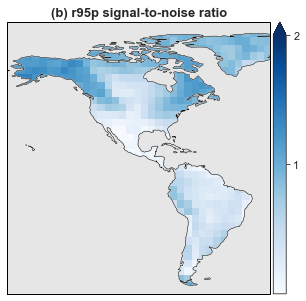

In [52]:
# Signal to Noise (internal + model variability) Ratio
data = SNratio.reshape(len(lats), len(lons))
    
plt.figure(figsize=(6,5))
plotdata, cyc_lons = acp(data, coord=lons)
ax = plt.axes(projection=ccrs.PlateCarree())
plt.pcolormesh(cyc_lons, lats, plotdata, transform=ccrs.PlateCarree(), cmap='Blues', vmax = 2)
cb = plt.colorbar(pad=0.01, extend='max')
cb.ax.tick_params(labelsize=11)
cb.set_ticks([1,2,3])
#plt.contour(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), levels=[.1,1],colors='firebrick',linewidths=.5)
ax.coastlines(zorder=2, linewidth = .5)
ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='.9')
plt.xlim(-170, -25)
plt.ylim(-60, 90)
plt.title('(b) '+VAR+' signal-to-noise ratio', size=13, fontweight='demi');

# Just down here plotting some sample maps

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import os
from sklearn import linear_model
from cartopy.util import add_cyclic_point as acp
import cartopy
import cartopy.crs as ccrs
import seaborn as sb
sb.set_style('white')

In [179]:
USER = 'Jamin'
ROOT = '/Users/' + USER+ '/Rams/TOE_Research/'
RES = 'r240x120'
LATRANGE = [-90,90]
LONRANGE = [0,360]
EXPERIMENT_NAME = 'tas_pr_globe-land'
MODEL_SET = 'tas-seas_models'
VAR = 'tas-amj'
NORM = 'onemap'
YEAR = 1970
REF_YEAR = 1920

In [180]:
def open_climate_model_data():

    fn_list = []
    dirr = ROOT + 'data/netcdfFiles_' + RES + '/cmip6/'+VAR+'/'
    for fn in os.listdir(dirr):
        if fn.endswith('nc'):
            fn_list.append(dirr + fn)
    ds = []
    yr_beg = 1920
    yr_end = 2099
    for fn in fn_list:
        dd = xr.open_dataset(fn)
        dd = dd[VAR].sel(time=slice(str(yr_beg),str(yr_end))).sel(lon=slice(LONRANGE[0],LONRANGE[1]))\
                      .sel(lat=slice(LATRANGE[0],LATRANGE[1]))
        lons = dd.lon.sel(lon=slice(LONRANGE[0],LONRANGE[1])).values
        lats = dd.lat.sel(lat=slice(LATRANGE[0],LATRANGE[1])).values
        dd = dd.groupby("time.year").mean("time").values

        ds.append(dd)
    years = np.arange(yr_beg,yr_end+1)
    ds_orig = np.reshape(ds, (np.shape(ds)[0], np.shape(ds)[1], -1))
    return ds_orig, years, lats, lons

def remove_mean_1980_2019(ds_orig, years):
    # Removing mean 1980-2020
    logic = np.logical_and(years >= 1980, years < 2020)
    ds = ds_orig - np.stack(len(years)*[np.mean(ds_orig[:,logic,:], axis=1)], axis=1)
    return ds

In [181]:
ds_orig, years, lats, lons = open_climate_model_data()
ds = remove_mean_1980_2019(ds_orig, years)

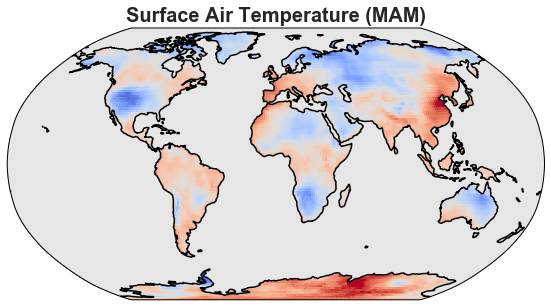

In [186]:
# Signal to Noise (internal + model variability) Ratio
data = np.mean(ds, axis = 0)[44,:].reshape(len(lats), len(lons))
    
plt.figure(figsize=(12,5))
plotdata, cyc_lons = acp(data, coord=lons)
ax = plt.axes(projection=ccrs.Robinson())
plt.pcolormesh(cyc_lons, lats, plotdata, transform=ccrs.PlateCarree(), cmap='coolwarm', vmax=0, vmin=-1.7)


ax.coastlines(zorder=2, linewidth = 1.5, color = '0')
ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='.9')
title = 'Surface Air Temperature (MAM)'
plt.title(title, fontweight = 'demi', size=20)
plt.savefig('/Users/Jamin/Downloads/' + title + '.png', bbox_inches = 'tight', pad_inches = .02, dpi=300)

In [141]:
np.quantile(data, .5)

-1.51655513048172

# Some playing around with data

In [95]:
import numpy as np
import pickle
import seaborn as sb
import matplotlib.pyplot as plt
import cartopy.crs as ccrs
from cartopy.util import add_cyclic_point as acp

In [108]:
USER = 'Jamin'
RES = 'r90x45'
ROOT = '/Users/' + USER + '/Rams/TOE_Research/' # root directory for the whole project
PATH = ROOT + 'data/' # the path of the netCDF files (before PRIM)
EXPERIMENT = 'pr_tas_final_globe-land/'
MODEL_SET = 'pr-month'
DATAFN = '/Users/' + USER + '/Rams/TOE_Research/data/lrp_npz_' + RES + '/classification_topmodels/' \
         + EXPERIMENT + 'lrp_' + MODEL_SET + '.npz'
VALFN = '/Users/' + USER + '/Rams/TOE_Research/playground_data/' + EXPERIMENT + 'validation_models_list.p'
BESTMODELSFN = '/Users/' + USER + '/Rams/TOE_Research/playground_data/' + EXPERIMENT \
             + 'ranked_best_models/' + MODEL_SET + '_models.p'
MASK = PATH + 'landmask/landmask_nopole_' + RES + '.npz'

In [109]:
def get_lrp_data(filename=None):
    if filename:
        npzdata = np.load(filename)
    else:
        npzdata = np.load(SAVE_LRP_PATH + 'lrp_model' + str(MODEL_NUM) + '.npz');
    try:
        return npzdata['data'], npzdata['obs'], npzdata['years'], npzdata['obs_years'], \
               npzdata['lats'], npzdata['lons'], npzdata['pred_years']
    except:
        return npzdata['data'], None, npzdata['years'], None, \
               npzdata['lats'], npzdata['lons'], npzdata['pred_years']
    
def unmask(data, lats, lons, fill = np.nan):
    # incoming data should be one-dimensional 
    maskinfo = np.load(MASK) # boolland has shape lats, lons
    boolland, boollats, boollons = maskinfo['mask'], maskinfo['lats'], maskinfo['lons']
    boolland = boolland[np.logical_and(boollats >= np.min(lats), boollats <= np.max(lats)), :]
    boolland = boolland[:,np.logical_and(boollons >= np.min(lons), boollons <= np.max(lons))]
    output_lons = boollons[np.logical_and(boollons >= np.min(lons), boollons <= np.max(lons))]
    output_lats = boollats[np.logical_and(boollats >= np.min(lats), boollats <= np.max(lats))]    
    
    # Putting the good data into a new matrix, fill the remaining space with filltype (default: np.nan)
    output_data = np.full(boolland.shape, fill)
    output_data[boolland] = data.copy()
    
    return output_data, output_lats, output_lons

In [110]:
data, obs_data, years, obs_years, lats, lons, pred_years = get_lrp_data(DATAFN)
f = open(VALFN, 'rb')
validation_models = pickle.load(f)
f.close()
f = open(BESTMODELSFN, 'rb')
ranked_models = pickle.load(f)[:20]
f.close()

#### First I am going to do this across all models individually, just seeing, simply, when they exceed the 1920-1960 baseline period forever.

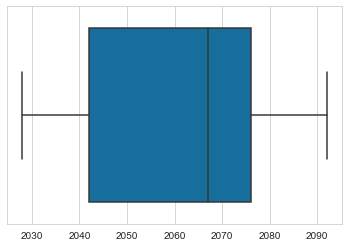

In [111]:
toes = []
toes_spatial = []
for mod, yrs in zip(data, years):
    # To find when it's greater than the 1920-1960 baseline
    checkgreater = (mod - np.max(mod[:40, :], axis=0)) > 0
    toe1 = np.flip(yrs)[np.flip(np.argmin(np.flip(checkgreater), axis=0))]
    #To find when it's less than the 1920-1960 baseline
    checklesser = (mod - np.min(mod[:40, :], axis=0)) < 0
    toe2 = np.flip(yrs)[np.flip(np.argmin(np.flip(checklesser), axis=0))]
    toes.append(np.min([toe1, toe2]))
    toes_spatial.append(np.min(np.stack([toe1, toe2]), axis=0))
sb.boxplot(toes)

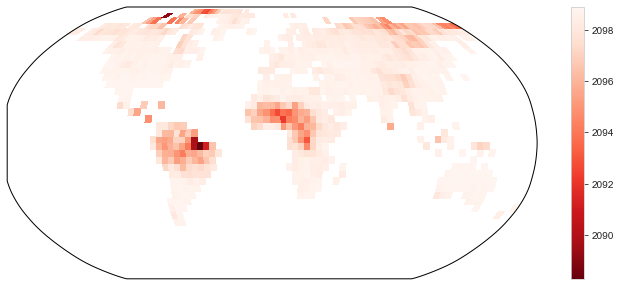

In [116]:
mondata = np.min(np.mean(toes_spatial, axis=0).reshape((12,-1)),axis=0)
plotdata, plotlats, plotlons = unmask(mondata, lats, lons)

plt.figure(figsize=(12,5))
plotdata, cyc_lons = acp(plotdata, coord=plotlons)
ax = plt.axes(projection=ccrs.Robinson())
plt.pcolormesh(cyc_lons, plotlats, plotdata, transform=ccrs.PlateCarree(), cmap='Reds_r')
plt.colorbar()

#### Same thing as before, but now all of them together

In [113]:
plotdata

array([[nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       ...,
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan],
       [nan, nan, nan, ..., nan, nan, nan]])

# Plotting all the maps associated with the clustering methods.

In [1]:
import numpy as np
import matplotlib.pyplot as plt
import xarray as xr
import os
from sklearn import linear_model
from cartopy.util import add_cyclic_point as acp
import cartopy
import cartopy.crs as ccrs
import pickle
import proplot
import seaborn as sb
import copy
sb.set_style('white')

/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/_collections_abc.py:841: MatplotlibDeprecationWarning: 
The examples.directory rcparam was deprecated in Matplotlib 3.0 and will be removed in 3.2. In the future, examples will be found relative to the 'datapath' directory.
  self[key] = other[key]


In [15]:
USER = 'Jamin'
RES = 'r240x120'
ROOT = '/Users/' + USER + '/Rams/TOE_Research/' # root directory for the whole project
ROOT = '/Users/Jamin/Google Drive/My Drive/TOE_Research/'
PATH = ROOT + 'data/' # the path of the netCDF files (before PRIM)
MASK = PATH + 'landmask/landmask_nopole_' + RES + '.npz'
TRIALTYPE = '_americas-land'
EXPERIMENT = 'r95p_final' + TRIALTYPE + '/'
MODEL_SET = 'r95p-seas-met_models/'
timecode = str('2090') #toe or 2090
clusters = 1
VAR = sorted(['r95p-djf', 'r95p-mam','r95p-jja','r95p-son'])
GCM_NUM = 32

In [16]:
def unmask(data, lats, lons, fill = np.nan):
    # incoming data should be one-dimensional 
    maskinfo = np.load(MASK) # boolland has shape lats, lons
    boolland, boollats, boollons = maskinfo['mask'], maskinfo['lats'], maskinfo['lons']
    # Shaping to the domain of the input data
    boolland = boolland[np.logical_and(boollats >= np.min(lats), boollats <= np.max(lats)), :]
    boolland = boolland[:,np.logical_and(boollons >= np.min(lons), boollons <= np.max(lons))]
    output_lons = boollons[np.logical_and(boollons >= np.min(lons), boollons <= np.max(lons))]
    output_lats = boollats[np.logical_and(boollats >= np.min(lats), boollats <= np.max(lats))]    
    
    # Putting the good data into a new matrix, fill the remaining space with filltype (default: np.nan)
    output_data = np.full(boolland.shape, fill)
    output_data[boolland] = data.copy()
    
    return output_data, output_lats, output_lons

In [17]:
outfilename = ROOT + 'playground_data/clusterdata/r95p-seas-met_' + timecode + '_' \
+ str(clusters) + 'clusters_data.npz'
clusterdata = np.load(outfilename, allow_pickle = True) 
relevance_maps, bargraphx, bargraphy, toes, kmeans_input, kmeans_output, lats, lons = \
    clusterdata['relevance_maps'], clusterdata['bargraphx'], clusterdata['bargraphy'], \
    clusterdata['toes'], clusterdata['kmeans_input'], clusterdata['kmeans_output'], \
    clusterdata['lats'], clusterdata['lons']

In [18]:
relevance_maps.shape

(1, 4, 2314)

In [59]:
modelnames = sorted(['ACCESS-ESM1-5/', 'BCC-CSM2-MR/', 'CESM2-WACCM/', 'CESM2/',
           'CMCC-CM2-SR5/', 'CNRM-CM6-1-HR/', 'CNRM-CM6-1/', 'CNRM-ESM2-1/',
           'CanESM5/', 'EC-Earth3/', 'FGOALS-g3/', 'GFDL-CM4/', 'GFDL-ESM4/',
           'HadGEM3-GC31-LL/', 'HadGEM3-GC31-MM/', 'INM-CM4-8/', 'INM-CM5-0/',
           'IPSL-CM6A-LR/', 'KACE-1-0-G/', 'KIOST-ESM/', 'MIROC-ES2L/', 'MIROC6/',
           'MPI-ESM1-2-LR/', 'MRI-ESM2-0/', 'NESM3/', 'UKESM1-0-LL/','EC-Earth3-Veg/', 
           'NorESM2-MM/', 'ACCESS-CM2/', 'MPI-ESM1-2-HR/', 'TaiESM1/', 'NorESM2-LM/'])
modelnames = np.array([m[:-1] for m in modelnames])
modelnames

array(['ACCESS-CM2', 'ACCESS-ESM1-5', 'BCC-CSM2-MR', 'CESM2-WACCM',
       'CESM2', 'CMCC-CM2-SR5', 'CNRM-CM6-1-HR', 'CNRM-CM6-1',
       'CNRM-ESM2-1', 'CanESM5', 'EC-Earth3-Veg', 'EC-Earth3',
       'FGOALS-g3', 'GFDL-CM4', 'GFDL-ESM4', 'HadGEM3-GC31-LL',
       'HadGEM3-GC31-MM', 'INM-CM4-8', 'INM-CM5-0', 'IPSL-CM6A-LR',
       'KACE-1-0-G', 'KIOST-ESM', 'MIROC-ES2L', 'MIROC6', 'MPI-ESM1-2-HR',
       'MPI-ESM1-2-LR', 'MRI-ESM2-0', 'NESM3', 'NorESM2-LM', 'NorESM2-MM',
       'TaiESM1', 'UKESM1-0-LL'], dtype='<U15')

[100. 100.   0.   0.   0.   0. 100. 100. 100.   0. 100. 100.   0.   0.
   0. 100. 100.   0.   0.   0. 100.   0.   0.   0.  91.   0.   0.   0.
   0.   0.   0. 100.]
[100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100.
 100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100. 100.
 100. 100. 100. 100.]


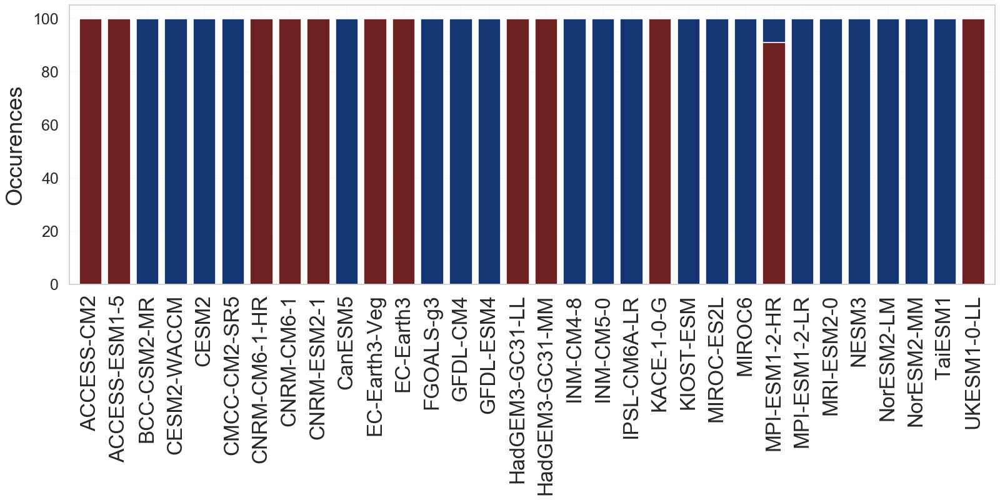

In [35]:
fig = plt.figure(constrained_layout=True, figsize = (8,4))
gs = fig.add_gridspec(1, 1)

bartotlist = []
bartot = np.zeros(shape=32)
for bx, by in zip(bargraphx, bargraphy):
    bartot[bx] += by
    print(bartot)
    bartotlist.append(bartot.copy())
    

ax1 = fig.add_subplot(gs[0, 0])
ax1.bar(np.arange(32), bartotlist[-1], color='#143673')
plt.ylabel('Occurences', size=13)
plt.xlim(-.75,31.75)
#ax1.set_title('Cluster 1', size=15, fontweight='demi')  

ax1.bar(np.arange(32), bartotlist[0], color='#6d2121', zorder=2)
plt.xticks(np.arange(32),labels=modelnames, rotation=90, size=12)
#ax1.set_title('Title', size=15, fontweight='demi') 
plt.xlim(-.75,31.75)
#plt.suptitle('How often does each climate model fall into each cluster?', size=18)

#plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/clusters/occurrences-bargraph-' + \
#                VAR[0].split('-')[0] + '-' + str(timecode) + '-' + str(clusters) + 'clusters.jpg', 
#                dpi=300, bboxes_inches='tight')

In [8]:
toes[0]

array([2014, 2007, 1993, ..., 1996, 2019, 1997])

In [123]:
## Getting validation TOEs
if type(toes) != list:
    toes = [toes]
all_toes = np.full(sum([arr.size for arr in toes[0]]), np.nan).reshape(100,-1) # Reshaping to 32 GCMs, 100 ANNs

#is_val = np.full(all_toes.shape, False)

f = open(ROOT + '/playground_data/' + EXPERIMENT+
         'bestmodeldictionary_cmip6_classification'+TRIALTYPE+'.p', 'rb')
modelstats = pickle.load(f)[str(VAR)]
f.close()

f = open(ROOT + '/playground_data/' + EXPERIMENT + 'ranked_best_models/' + MODEL_SET[:-1] + '.p', 'rb')
modelranking = pickle.load(f)
f.close()

for run, i in zip(modelranking, range(len(modelranking))):
    for ident, TofE in zip(modelstats[run]['dataset info']['validation model id numbers'],
                          modelstats[run]['model result']['TOE(val)']):
        all_toes[i, ident] = TofE

val_toes = [[]]*len(np.unique(kmeans_output))  

for cnum in np.unique(kmeans_output):
    val_toes[cnum] = all_toes[kmeans_output.reshape(100,32) == cnum]
    val_toes[cnum] = val_toes[cnum][~np.isnan(val_toes[cnum])]

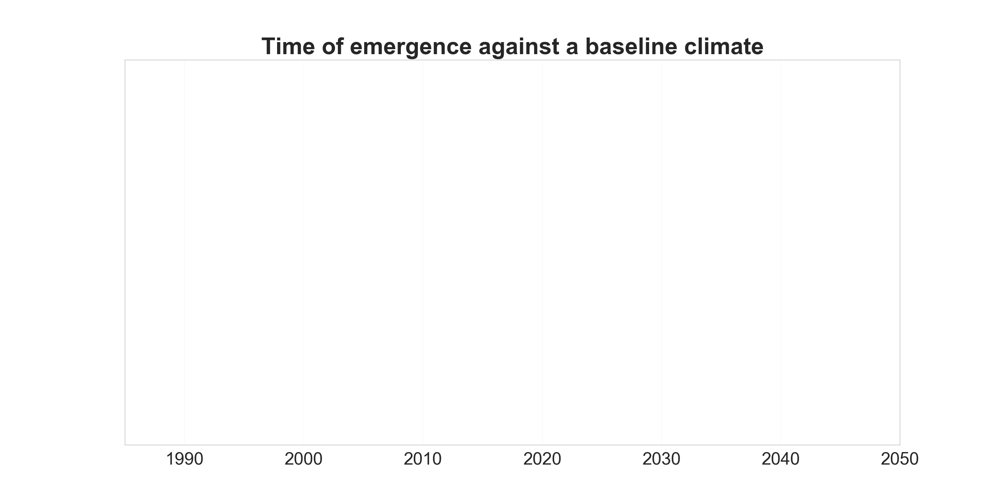

In [129]:
sb.set_style('whitegrid')
plt.figure(figsize = (12,6))
uniq = []
for toe in val_toes:
    uniq.extend(toe)
uniq = set(uniq)

mydata = copy.deepcopy(val_toes)
#mydata = []
#factor = 5
#for toe, i in zip(val_toes, range(len(val_toes))):
#    mydata.append([])
#    for u in uniq:
#        numadd = len(toe[toe==u]) // factor + int(len(toe[toe==u]) % factor > 0)
#        mydata[i].extend([u]*numadd)
for my, i in zip(mydata, range(len(mydata))):
    for u in set(my):
        if sum(my == u) > 5:
            for val, j in zip(mydata[i], range(len(mydata[i]))):
                if val == u:
                    mydata[i][j] = u + np.random.choice([-.25, .25])
    

#sb.swarmplot(data=mydata, orient='h', zorder=2, color='k', size=3.5)
#sb.boxplot(data=val_toes, orient='h', palette=['#6d2121', '#143673'], showfliers=False, zorder=1)
#FF00FF for purple
#plt.yticks([0,1], [1,2], size=18, fontweight='demi')
plt.yticks([])
plt.xlim(1985, 2050)
plt.xticks([1990, 2000, 2010, 2020, 2030, 2040, 2050],size=15)
plt.title('Time of emergence against a baseline climate',fontweight='demi', size=20)
plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/clusters/TOE-boxplot-' + \
                VAR[0].split('-')[0] + '-' + str(timecode) + '-' + str(clusters) + 'clusters-background.jpg', 
                dpi=300, bboxes_inches='tight')
sb.set_style('white')

In [45]:
#print(np.min(val_toes[1]), np.quantile(val_toes[1], .25), np.quantile(val_toes[1], .5), np.quantile(val_toes[1], .75),
#      np.max(val_toes[1]))
plot_comparison = dict()

relevance-r95p-djf-toe-clusters=1_of_2.jpg
relevance-r95p-jja-toe-clusters=1_of_2.jpg
relevance-r95p-mam-toe-clusters=1_of_2.jpg
relevance-r95p-son-toe-clusters=1_of_2.jpg
relevance-r95p-djf-toe-clusters=2_of_2.jpg
relevance-r95p-jja-toe-clusters=2_of_2.jpg
relevance-r95p-mam-toe-clusters=2_of_2.jpg
relevance-r95p-son-toe-clusters=2_of_2.jpg


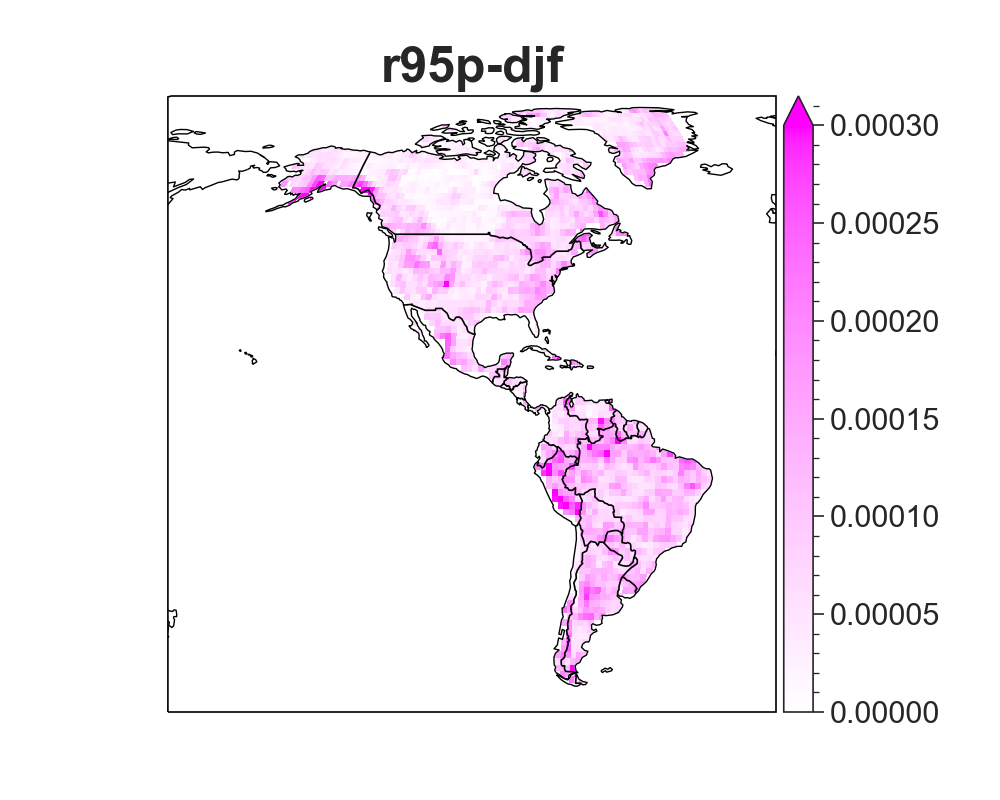

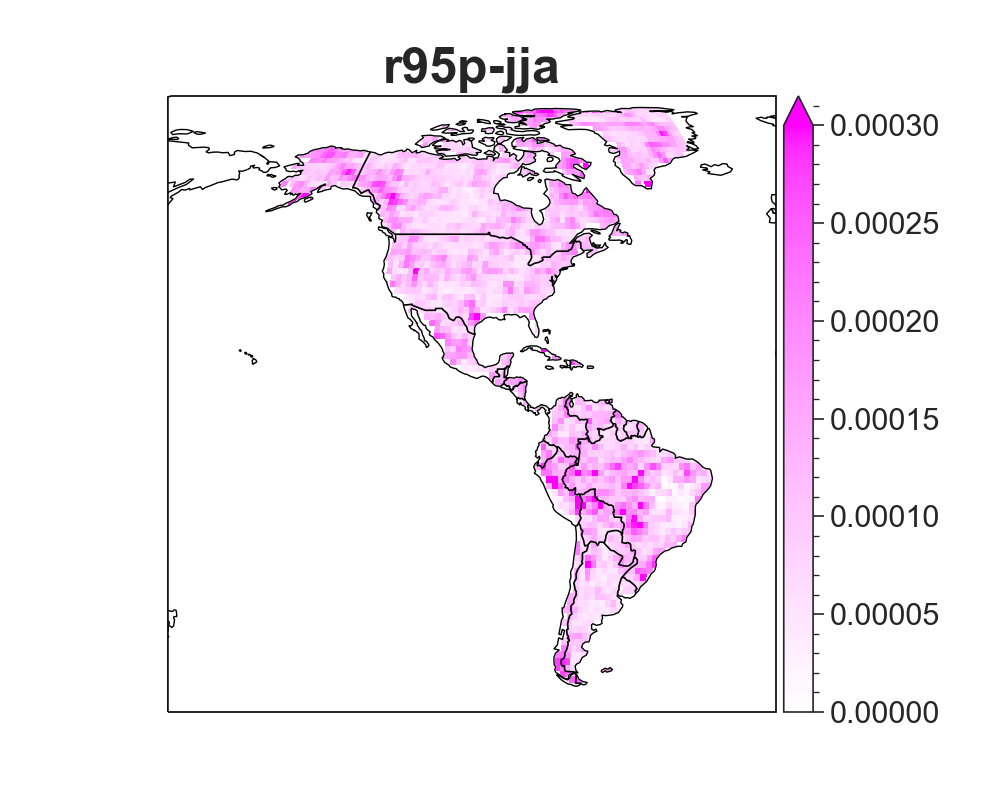

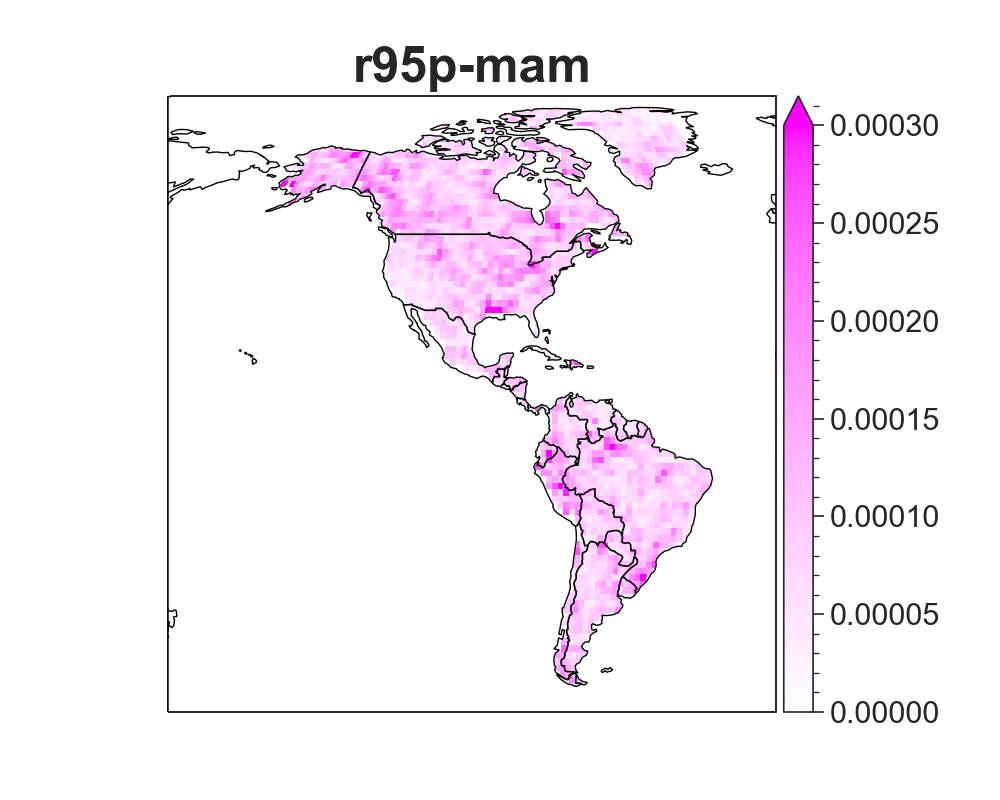

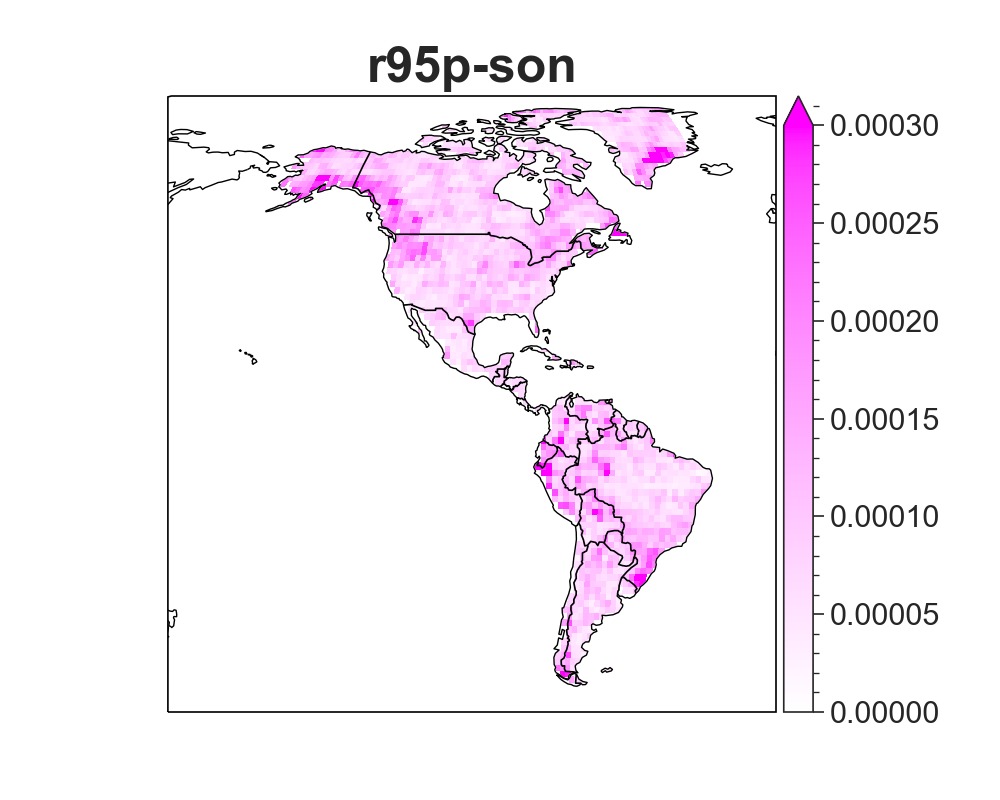

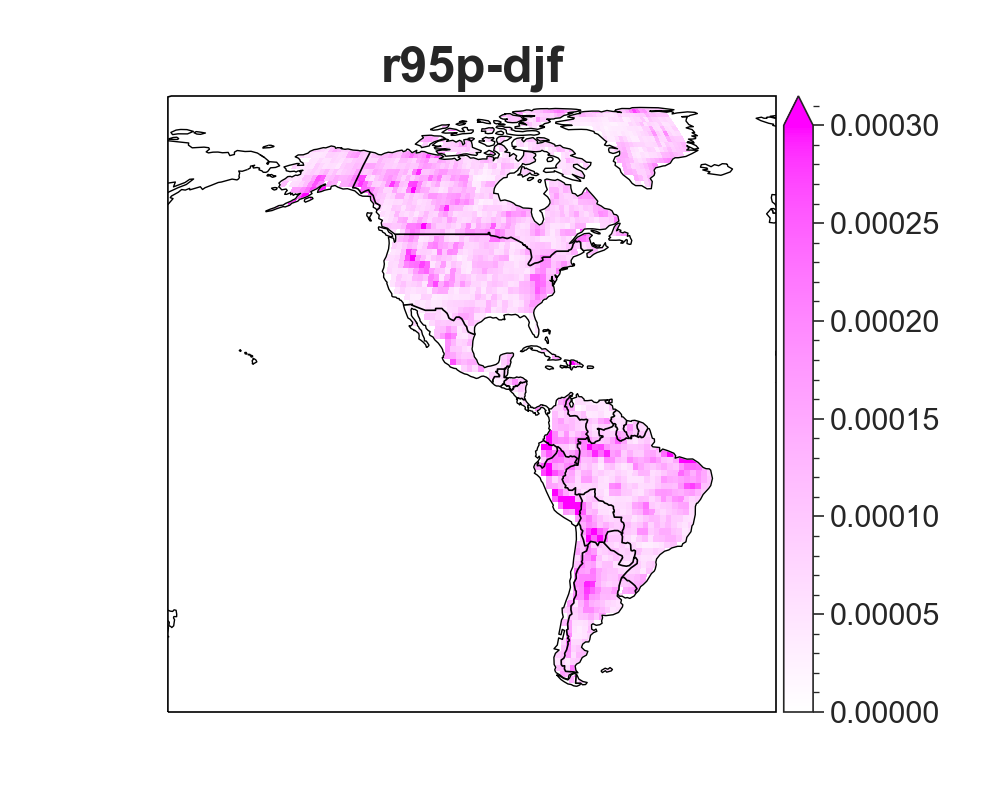

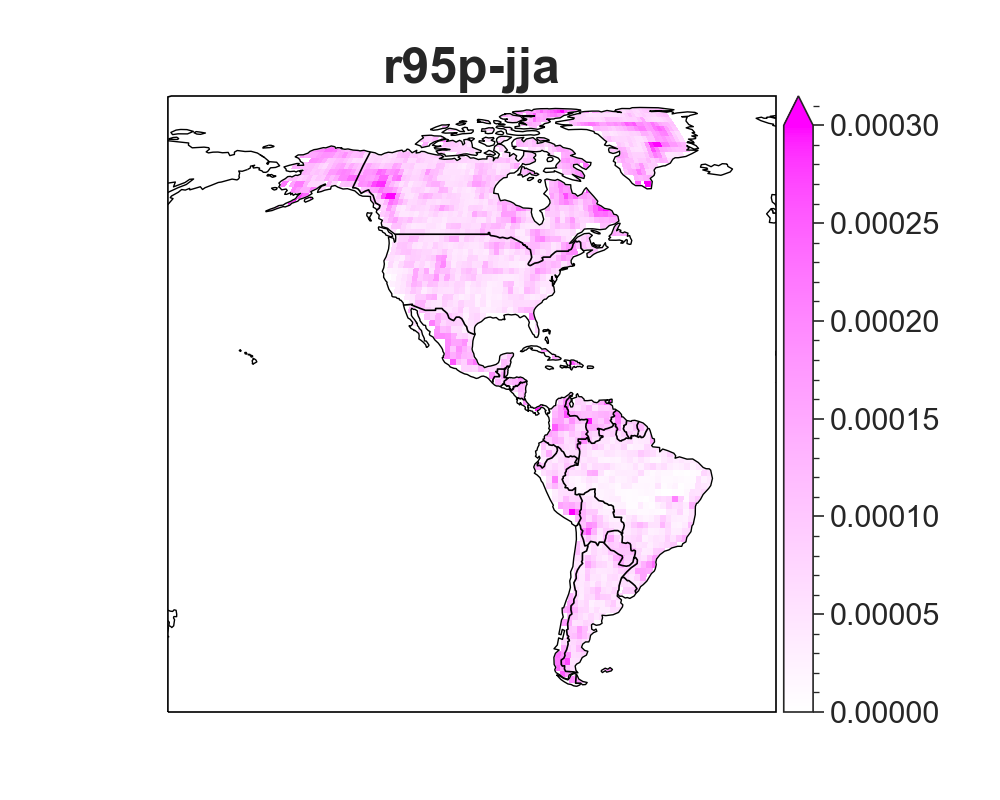

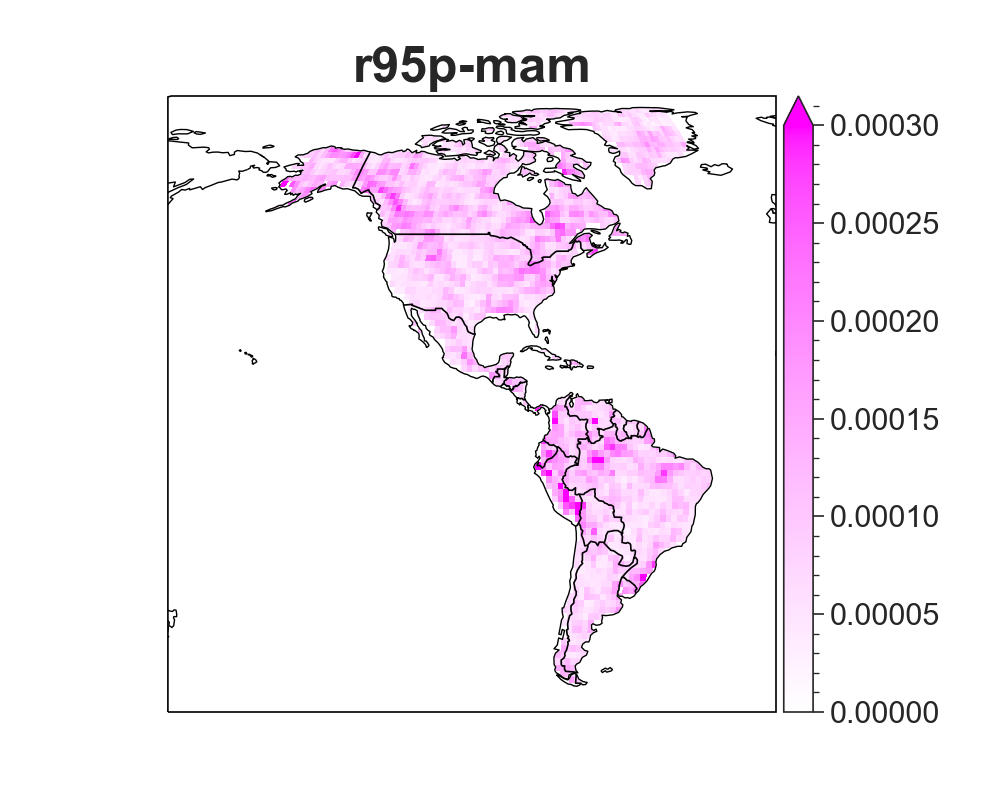

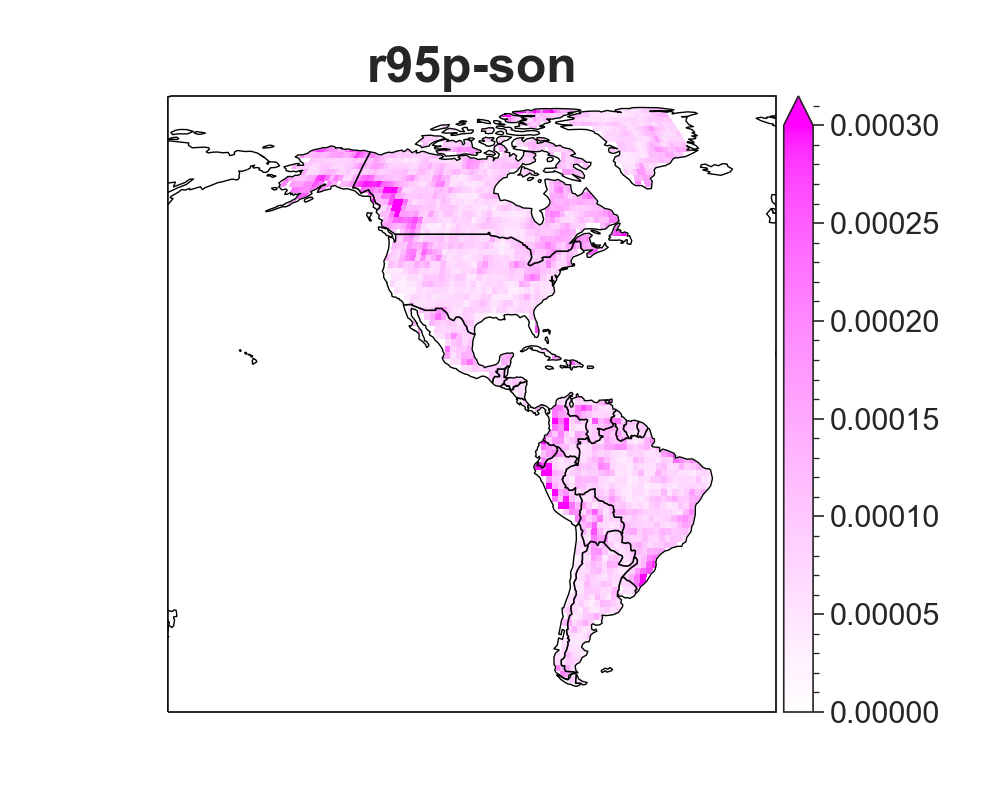

In [69]:
diff = False

for cnum in range(len(relevance_maps)):
    for v in range(len(VAR)):
        var = VAR[v]
        hatchcolor = ['#6d2121', '#143673'][cnum] #6d2121' # temp #'#143673' # precip # '#584116' #combined
        hatchcolor = '#FF00FF'
        lrpmax = .0003 #combined-seas-precip #.0025 #combined-seas-temp #.007 # temp-ann #.01 #precip-ann 
        
        if diff:
            lrpcm = "vlag"
        else:
            lrpcm = proplot.Colormap(hatchcolor)

        plt.figure(figsize=(5,4))

        lrpdata, lrplats, lrplons = unmask(relevance_maps[cnum][v], lats, lons)

        ax = plt.axes(projection=ccrs.Robinson(central_longitude=280))
        #ax = plt.axes(projection=ccrs.Robinson())

        #plot_comparison[v] = lrpdata.copy()
        if diff:
            plt.pcolormesh(lrplons, lrplats, lrpdata - plot_comparison[v], transform=ccrs.PlateCarree(), 
                           cmap=lrpcm, vmin=-lrpmax, vmax = lrpmax)#ListedColormap(sb.color_palette("seismic", 160)[80:]))
            cb = plt.colorbar(pad=0.01, extend='both')
        else:
            plt.pcolormesh(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), 
                           cmap=lrpcm, vmin=0, vmax = lrpmax)#ListedColormap(sb.color_palette("seismic", 160)[80:]))
            cb = plt.colorbar(pad=0.01, extend='max')
        cb.ax.tick_params(labelsize=11)
        #cb.set_ticks([])
        #cb.set_ticks(np.array([0, .5, 1, 1.5, 2, 2.5 ,3])

        ax.coastlines(zorder=2, linewidth = .5)
        ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='white')
        ax.add_feature(cartopy.feature.BORDERS)
        #plt.xlim(-170, -25)
        #plt.ylim(-60, 90)
        #plt.legend(loc='center left', bbox_to_anchor=(0, .5))
        #plt.title('(b) temperature signal-to-noise ratio', size=13, fontweight='demi')
        #plt.title(str(YEAR) + ' ' + VAR + ' signal-to-noise ratio from ' + MODEL_SET, size=18, fontweight='demi')
        #plt.title('SON precipitation', size=18, fontweight='demi')
        plt.title(var, size=18, fontweight='demi')
        if diff:
            savename = 'diffrelevance-' + var + '-eoc_minus_toe-clusters=' + str(cnum + 1) \
                     + '_of_' +str(clusters) + '.jpg'
        else:
            savename = 'relevance-' + var + '-' + str(timecode) + '-clusters=' + str(cnum + 1) \
                     + '_of_' +str(clusters) + '.jpg'
        plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/final_clusters/' + savename, 
                    dpi=300, bboxes_inches='tight')
        print(savename)

In [103]:
(relevance_maps[1] - relevance_maps[0]).shape

(4, 2314)

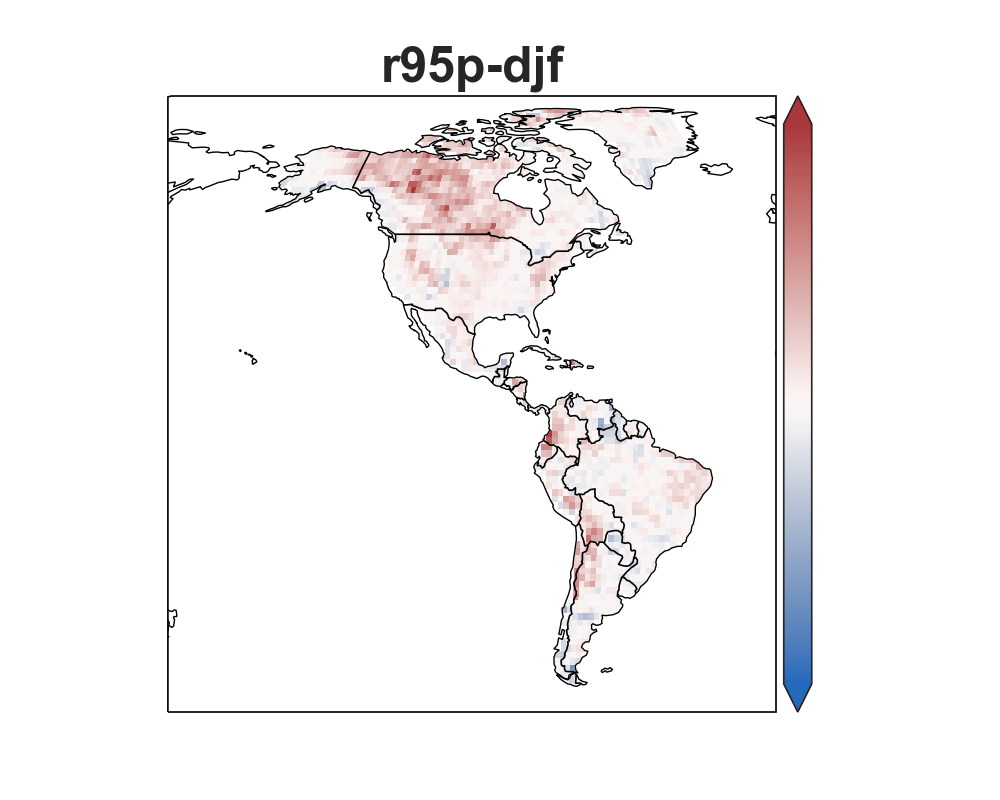

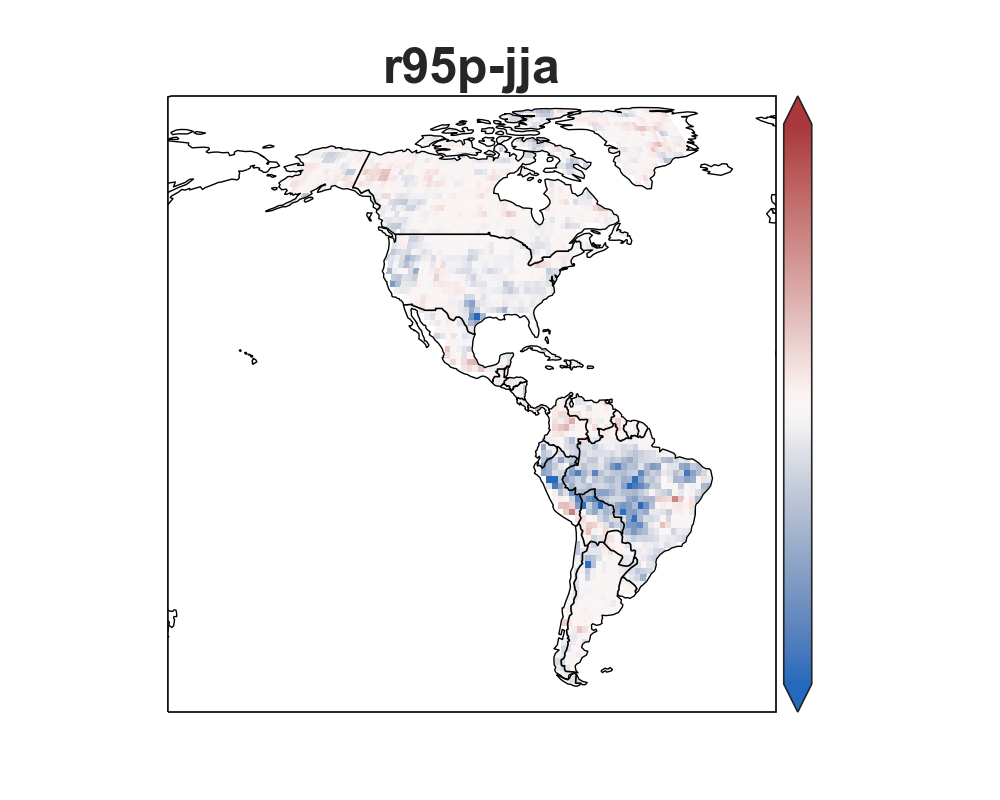

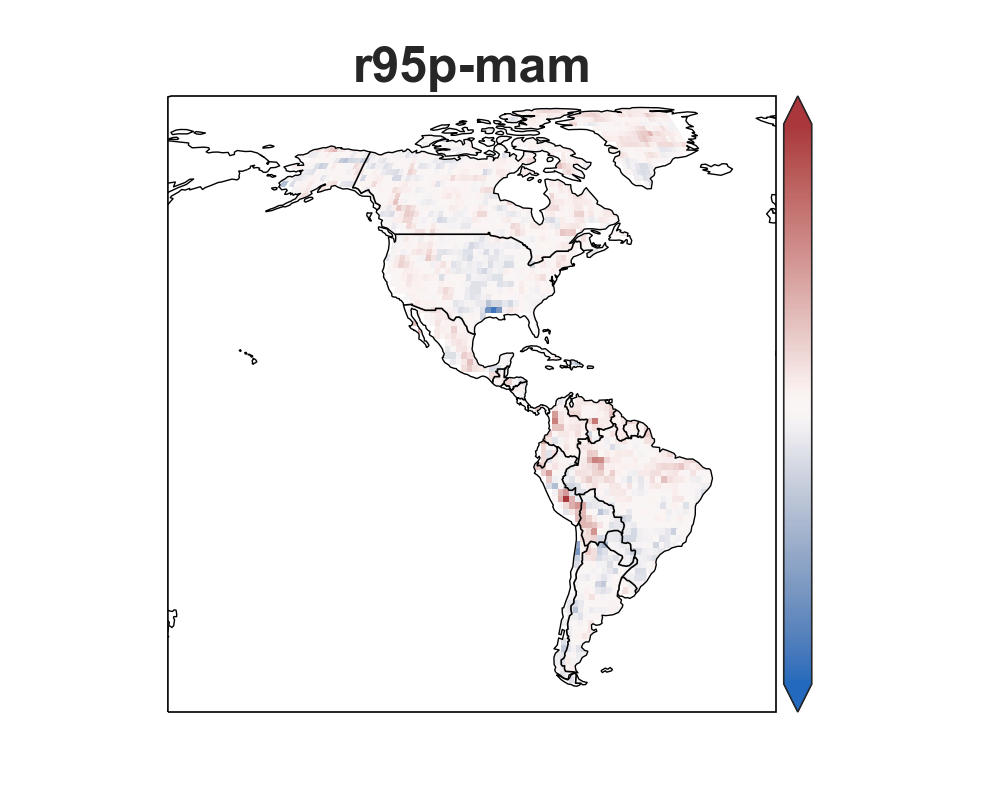

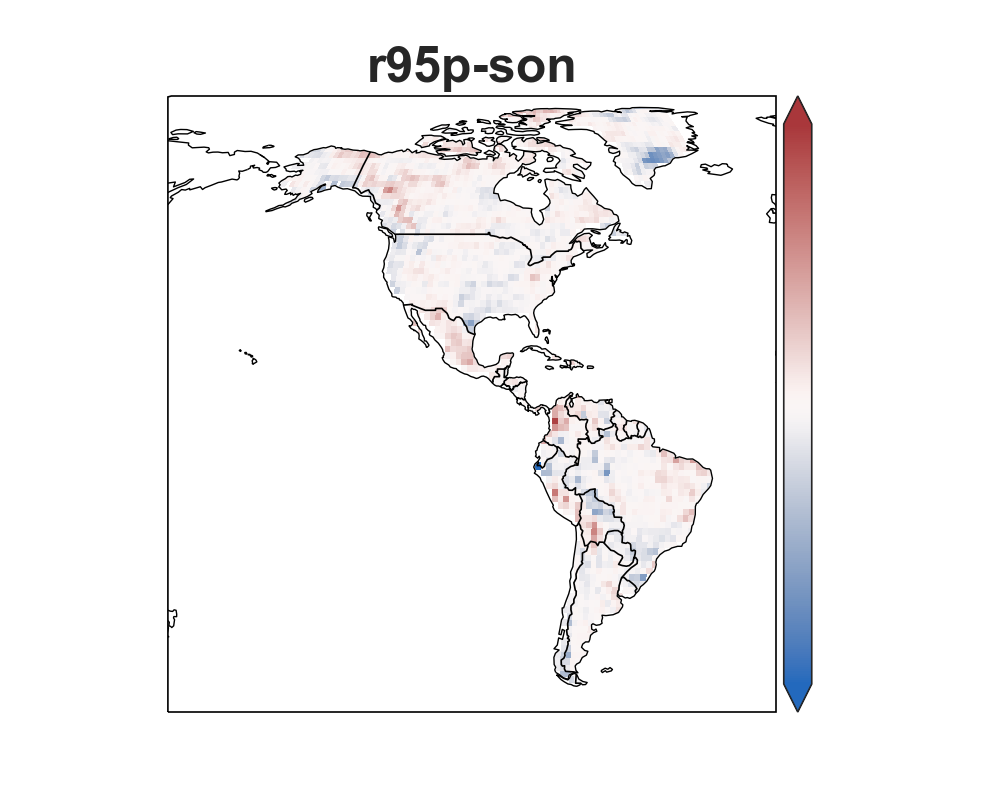

In [76]:
for v in range(len(VAR)):
    var = VAR[v]
    hatchcolor = '#6d2121' #'#6d2121' # temp #'#143673' # precip # '#584116' #combined
    lrpmax = .00015 #combined-seas-precip #.0025 #combined-seas-temp #.007 # temp-ann #.01 #precip-ann
    lrpmax = .0003

    lrpcm = proplot.Colormap(hatchcolor)

    plt.figure(figsize=(5,4))

    lrpdata, lrplats, lrplons = unmask(relevance_maps[1][v] - relevance_maps[0][v], lats, lons)

    ax = plt.axes(projection=ccrs.Robinson(central_longitude=280))
    #ax = plt.axes(projection=ccrs.Robinson())
    plt.pcolormesh(lrplons, lrplats, lrpdata, transform=ccrs.PlateCarree(), 
                   cmap="vlag", vmax = lrpmax, vmin = -lrpmax)#ListedColormap(sb.color_palette("seismic", 160)[80:]))
    cb = plt.colorbar(pad=0.01, extend='both')
    cb.ax.tick_params(labelsize=11)
    cb.set_ticks([])
    #cb.set_ticks([.5, 1, 1.5, 2, 2.5 ,3])

    ax.coastlines(zorder=2, linewidth = .5)
    ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='white')
    ax.add_feature(cartopy.feature.BORDERS)
    #plt.xlim(-170, -25)
    #plt.ylim(-60, 90)
    #plt.legend(loc='center left', bbox_to_anchor=(0, .5))
    #plt.title('(b) temperature signal-to-noise ratio', size=13, fontweight='demi')
    #plt.title(str(YEAR) + ' ' + VAR + ' signal-to-noise ratio from ' + MODEL_SET, size=18, fontweight='demi')
    #plt.title('SON precipitation', size=18, fontweight='demi')
    plt.title(var, size=18, fontweight='demi')
    plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/final_clusters/diffrelevance-' + \
                var + '-' + str(timecode) + '-cluster2_minus_cluster1.jpg', 
                dpi=300, bboxes_inches='tight')

### Okay, now maps of signal, noise (internal and model)

In [147]:
#USER = 'Jamin'
#ROOT = '/Users/' + USER+ '/Rams/TOE_Research/'
RES = 'r240x120'
MASK = PATH + 'landmask/landmask_nopole_' + RES + '.npz'
LATRANGE = [-90, 90] #[-55,90]
LONRANGE = [0,360] #[190,335]
#EXPERIMENT_NAME = 'pr_tas_final_globe-land'
#MODEL_SET = 'pr_tas-seas-met_models'
VAR = sorted(['r95p-djf', 'r95p-mam','r95p-jja','r95p-son'])
#NORM = 'onemap'
YEAR = 2090
REF_YEAR = 1920

In [148]:
def open_climate_model_data(mod_id = None):

    #mod_ids is an ndarray of model ids in alphabetical order
    
    fn_list = []
    dirr = ROOT + 'data/netcdfFiles_' + RES + '/cmip6/'+VAR+'/'
    for fn in os.listdir(dirr):
        if fn.endswith('nc'):
            fn_list.append(dirr + fn)
    ds = []
    yr_beg = 1920
    yr_end = 2099
    if type(mod_id) == int:
        fn = sorted(fn_list)[mod_id]
        dd = xr.open_dataset(fn)
        dd = dd[VAR].sel(time=slice(str(yr_beg),str(yr_end))).sel(lon=slice(LONRANGE[0],LONRANGE[1]))\
                      .sel(lat=slice(LATRANGE[0],LATRANGE[1]))
        lons = dd.lon.sel(lon=slice(LONRANGE[0],LONRANGE[1])).values
        lats = dd.lat.sel(lat=slice(LATRANGE[0],LATRANGE[1])).values
        dd = dd.groupby("time.year").mean("time").values
        ds.append(dd)
    elif mod_id is not None:
        for imod in mod_id:
            fn = sorted(fn_list)[imod]
            dd = xr.open_dataset(fn)
            dd = dd[VAR].sel(time=slice(str(yr_beg),str(yr_end))).sel(lon=slice(LONRANGE[0],LONRANGE[1]))\
                          .sel(lat=slice(LATRANGE[0],LATRANGE[1]))
            lons = dd.lon.sel(lon=slice(LONRANGE[0],LONRANGE[1])).values
            lats = dd.lat.sel(lat=slice(LATRANGE[0],LATRANGE[1])).values
            dd = dd.groupby("time.year").mean("time").values
            ds.append(dd)
    else:
        for fn in sorted(fn_list):
            dd = xr.open_dataset(fn)
            dd = dd[VAR].sel(time=slice(str(yr_beg),str(yr_end))).sel(lon=slice(LONRANGE[0],LONRANGE[1]))\
                          .sel(lat=slice(LATRANGE[0],LATRANGE[1]))
            lons = dd.lon.sel(lon=slice(LONRANGE[0],LONRANGE[1])).values
            lats = dd.lat.sel(lat=slice(LATRANGE[0],LATRANGE[1])).values
            dd = dd.groupby("time.year").mean("time").values

            ds.append(dd)
            
    years = np.arange(yr_beg,yr_end+1)
    ds_orig = np.reshape(ds, (np.shape(ds)[0], np.shape(ds)[1], -1))
    return ds_orig, years, lats, lons

def remove_mean_1980_2019(ds_orig, years):
    # Removing mean 1980-2020
    logic = np.logical_and(years >= 1980, years < 2020)
    each_model_mean = np.stack(len(years)*[np.mean(ds_orig[:,logic,:], axis=1)], axis=1)
    all_model_mean = np.mean(ds_orig[:,logic,:], axis=(0,1))
    ds = ds_orig - each_model_mean + all_model_mean # puts all lines on the average
    assert(len(ds[np.isnan(ds)]) == 0)
    return ds

def calc_polynomial(ds, years, deg=4):
    # Okay, the first thing to do is to calculate the 4th-order polynomial 
    # re: Hawkins and Sutton 2009 THE POTENTIAL TO NARROW UNCERTAINTY IN REGIONAL CLIMATE PREDICTIONS
    fo_ds = np.zeros(np.shape(ds))
    P = np.power(years.reshape((-1,1)),np.arange(4,-1, -1).reshape((-1,1)).T)
    for mod in range(len(ds)):
        coeffs = np.polyfit(years, ds[mod], deg=4)
        fo_ds[mod] = P @ coeffs
    return fo_ds

def calc_variability(fo_ds, years):
    # Calculating Internal Variability 
    #twentyfirst_logic = np.logical_and(years >= REF_YEAR, years < 2100)
    detrended = ds - fo_ds

    internal_variability = np.mean(np.var(detrended, axis=1), axis=0) # Assume constant in time
    inter_model_variability = np.var(fo_ds[:, np.where(years == YEAR), :],axis=(0))

    # Baseline, Future
    baseline = np.mean(fo_ds[:,np.where(years == REF_YEAR),:],axis=0)
    assert(np.all(np.isnan(baseline)== False))
    future = np.mean(fo_ds[:,np.where(years == YEAR),:],axis=0)
    assert(np.all(np.isnan(future)== False))
    # Signal
    signal =  future - baseline
    assert(np.all(np.isnan(signal)== False))
                 
    signalpercent = (future - baseline) / baseline

    # Convert to total variance standard deviation and find 90th percentile (Z = 1.65)
    noise90 = 1.65 * np.sqrt(internal_variability + inter_model_variability)
    internalnoise90 = 1.65 * np.sqrt(internal_variability)
    modelnoise90 = 1.65 * np.sqrt(inter_model_variability)
    
    assert(np.all(np.isnan(noise90)== False))
    assert(np.all(np.isnan(internalnoise90)== False))
    assert(np.all(np.isnan(modelnoise90)== False))

    SNratio = abs(signal) / noise90
    SNmodel = abs(signal) / modelnoise90
    SNinternal = abs(signal) / internalnoise90

    #assert(np.all(np.isnan(SNratio)== False))
    #assert(np.all(np.isnan(SNmodel)== False))
    #assert(np.all(np.isnan(SNinternal)== False))
    
    return SNratio, SNmodel, SNinternal, signal, modelnoise90, internalnoise90, signalpercent, baseline, future

In [40]:
var_orig = VAR
for cnum in range(len(relevance_maps)):
    print(bargraphx[cnum][bargraphy[cnum] > 75])
    for v in range(len(var_orig)):
        VAR = var_orig[v]
        var = VAR
        ds_orig, years, lats, lons = open_climate_model_data()
        ds = ds_orig[bargraphx[cnum][bargraphy[cnum] > 75]]
        fo_ds = calc_polynomial(ds, years)
        SNratio, SNmodel, SNinternal, signal, modelnoise90, internalnoise90, signalpercent, \
        baseline, future = calc_variability(fo_ds, years)

        for to_map, to_map_name in \
        zip([signal, modelnoise90, internalnoise90, SNratio, SNmodel, SNinternal, signalpercent, baseline,
             future], 
            ['signal', 'modelnoise', 'internalnoise', 'signoiseratio', 'signoisemodel', 
             'signoiseinternal','signalpercent', 'baseline', 'future']):

            data = to_map.reshape(len(lats), len(lons))
            #print(to_map_name, VAR, np.min(data))
            
            plt.figure(figsize=(5,4))

            #data, lats, lons = unmask(to_map, lats, lons)

            ax = plt.axes(projection=ccrs.Robinson(central_longitude=280))
            #ax = plt.axes(projection=ccrs.Robinson())
            
            # Defaults:
            vmin, vmax = 0, 3
            ticks = [0, 1, 2, 3]
            factor = 1
            cmap = 'Greens'
            extend = 'max'
            
            if to_map_name in ['signoiseratio', 'signoisemodel', 'signoiseinternal']:
                ticks = [0, 0.5, 1, 1.5]
                vmax=1.5
            elif to_map_name in ['modelnoise', 'internalnoise']:
                ticks = [0, 1, 2, 3]
                factor =100000
                cmap = proplot.Colormap('#FF00FF')
            elif to_map_name == 'signal':
                ticks = [-3, -2, -1, 0,1, 2, 3]
                cmap="vlag"
                extend = 'both'
                vmin = -3
                factor=100000
            elif to_map_name == 'signalpercent':
                ticks = [-100, -50, 0, 50, 100]
                vmin, vmax = -100, 100
                cmap = "vlag"
                extend = 'both'
                factor = 100
            elif to_map_name == 'baseline':
                ticks = [0,1,2,3,4,5]
                factor = 100000
                cmap = proplot.Colormap('#FF00FF')
                vmax = 5
            elif to_map_name == 'future':
                ticks = [0,1,2,3,4,5]
                factor = 100000
                cmap = proplot.Colormap('#FF00FF')
                vmax = 5

            plt.pcolormesh(lons, lats, factor * data, transform=ccrs.PlateCarree(), 
                           vmin = vmin, vmax = vmax, cmap=cmap)
            cb = plt.colorbar(pad=0.01, extend=extend)
            cb.ax.tick_params(labelsize=11)
            #cb.set_ticks([])
            cb.set_ticks(ticks)

            ax.coastlines(zorder=2, linewidth = .5)
            ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='white')
            ax.add_feature(cartopy.feature.BORDERS)
            #plt.xlim(-170, -25)
            #plt.ylim(-60, 90)
            #plt.legend(loc='center left', bbox_to_anchor=(0, .5))
            #plt.title('(b) temperature signal-to-noise ratio', size=13, fontweight='demi')
            #plt.title(str(YEAR) + ' ' + VAR + ' signal-to-noise ratio from ' + MODEL_SET, size=18, fontweight='demi')
            #plt.title('SON precipitation', size=18, fontweight='demi')
            plt.title(var + ' ' + to_map_name, size=18, fontweight='demi')
            #plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/clusters/' + to_map_name + '-' + \
            #            var + '-' + str(timecode) + '-' + str(cnum + 1) + '.jpg', 
            #            dpi=300, bboxes_inches='tight')
VAR = var_orig



[ 0  1  6  7  8 10 11 15 16 20 24 31]
signal r95p-djf -8.912740122675917e-06
modelnoise r95p-djf 2.112769593052813e-09
internalnoise r95p-djf 7.462672323747585e-08
signoiseratio r95p-djf 7.827487761162713e-07
signoisemodel r95p-djf 1.8392672308692022e-06
signoiseinternal r95p-djf 8.649898622086713e-07
signalpercent r95p-djf -450.5465153782608
baseline r95p-djf -1.48768783276206e-07
future r95p-djf -1.4618833512612614e-09
signal r95p-jja -1.635029372416367e-05
modelnoise r95p-jja 1.029801930601317e-09
internalnoise r95p-jja 2.5862293489677765e-08
signoiseratio r95p-jja 4.944286756585464e-05
signoisemodel r95p-jja 0.0001276082637883824
signoiseinternal r95p-jja 5.363222698526008e-05
signalpercent r95p-jja -11797.154343687494
baseline r95p-jja -5.9976588938909e-07
future r95p-jja -1.069330864090709e-10
signal r95p-mam -7.333020406009557e-06
modelnoise r95p-mam 1.6869355800958135e-09
internalnoise r95p-mam 6.027657981532852e-08
signoiseratio r95p-mam 6.226089068512122e-05
signoisemodel r95

/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:55: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:65: RuntimeWarning: invalid value encountered in true_divide


signal r95p-son -1.3652446231931608e-05
modelnoise r95p-son 0.0
internalnoise r95p-son 0.0
signoiseratio r95p-son nan
signoisemodel r95p-son nan
signoiseinternal r95p-son nan
signalpercent r95p-son nan
baseline r95p-son -1.6176186057546374e-07
future r95p-son -1.7065820027394503e-09
[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]
signal r95p-djf -7.043569783762859e-06
modelnoise r95p-djf 8.376586319304784e-09
internalnoise r95p-djf 1.4758934064264644e-07
signoiseratio r95p-djf 4.573457605623958e-05
signoisemodel r95p-djf 7.181010970789509e-05
signoiseinternal r95p-djf 5.932150294558125e-05
signalpercent r95p-djf -13.37871702460773
baseline r95p-djf -1.6550399577772503e-08
future r95p-djf -8.256494047481633e-10
signal r95p-jja -1.3903662617453794e-05
modelnoise r95p-jja 5.426309349046911e-09
internalnoise r95p-jja 1.0917245143471485e-07
signoiseratio r95p-jja 1.3375997894405917e-05
signoisemodel r95p-jja 4.104118341434374e-05
signoiseinternal r95p-jja 1.4148527788069341e-0

In [149]:
# Setting up TOE paired with the model that it came from
f = open(ROOT + '/playground_data/' + EXPERIMENT+
         'bestmodeldictionary_cmip6_classification'+TRIALTYPE+'.p', 'rb')
modelstats = pickle.load(f)[str(VAR)]
f.close()
models_for_toe = []
toe_for_models = []
for i in np.arange(100):
    modelstats[i]['model result']
    models_to_add = np.arange(GCM_NUM)
    temp_val_models = modelstats[i]['dataset info']['validation model id numbers']
    models_to_add = np.delete(models_to_add, np.array(temp_val_models))
    models_to_add = np.concatenate((models_to_add, np.array(temp_val_models)))
    models_for_toe.append(models_to_add)
    toetraintemp = modelstats[i]['model result']['TOE(train)']
    toevalidtemp = modelstats[i]['model result']['TOE(val)']    
    toes_to_add = np.concatenate((np.array(toetraintemp), np.array(toevalidtemp)))
    toe_for_models.append(toes_to_add)
toe_for_models = np.concatenate(toe_for_models)
models_for_toe = np.concatenate(models_for_toe)

/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:3: ResourceWarning: unclosed file <_io.BufferedReader name='/Users/Jamin/Rams/TOE_Research//playground_data/r95p_final_americas-land/bestmodeldictionary_cmip6_classification_americas-land.p'>
  This is separate from the ipykernel package so we can avoid doing imports until


[ 0  1  6  7  8 10 11 15 16 20 24 31]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:83: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:94: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:95: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in true_divide


[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:83: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:94: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:95: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in true_divide


[ 0  1  6  7  8 10 11 15 16 20 24 31]
[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]
[ 0  1  6  7  8 10 11 15 16 20 24 31]
[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


[ 0  1  6  7  8 10 11 15 16 20 24 31]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:83: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:94: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:95: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:96: RuntimeWarning: invalid value encountered in true_divide


[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:101: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


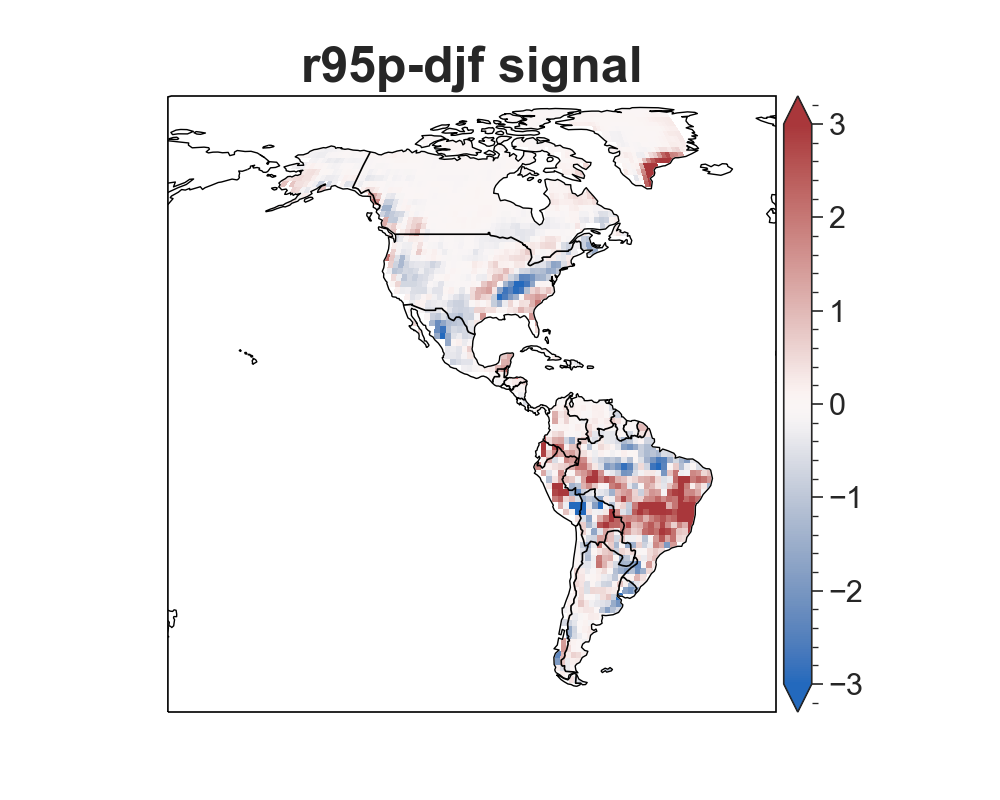

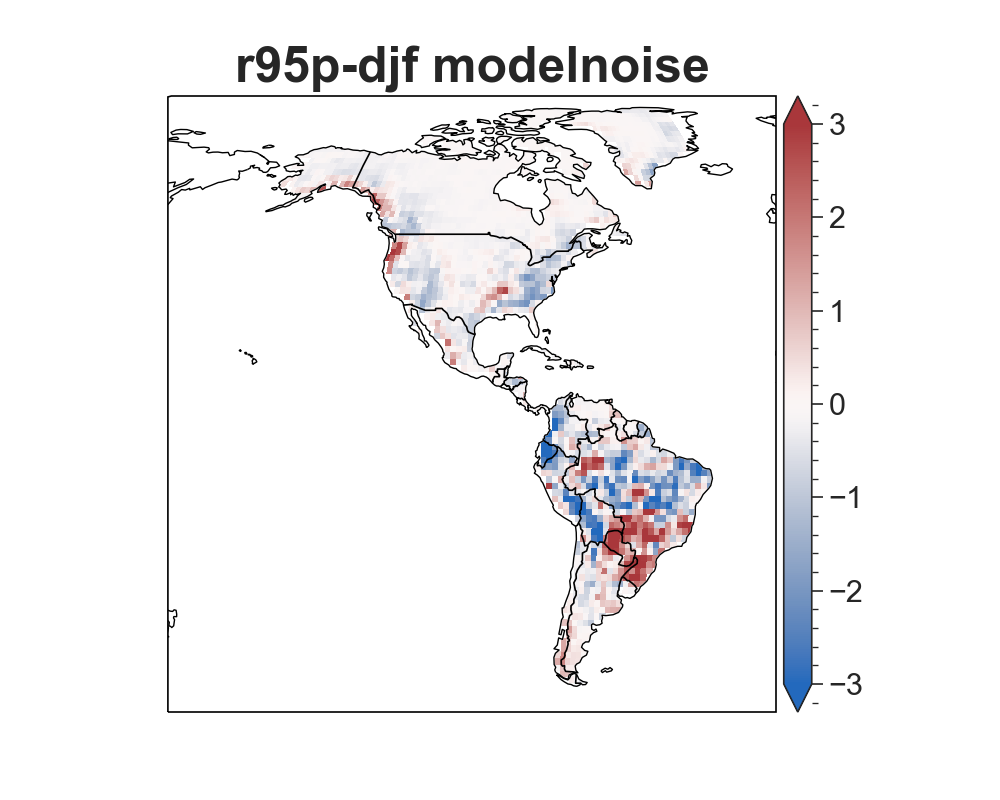

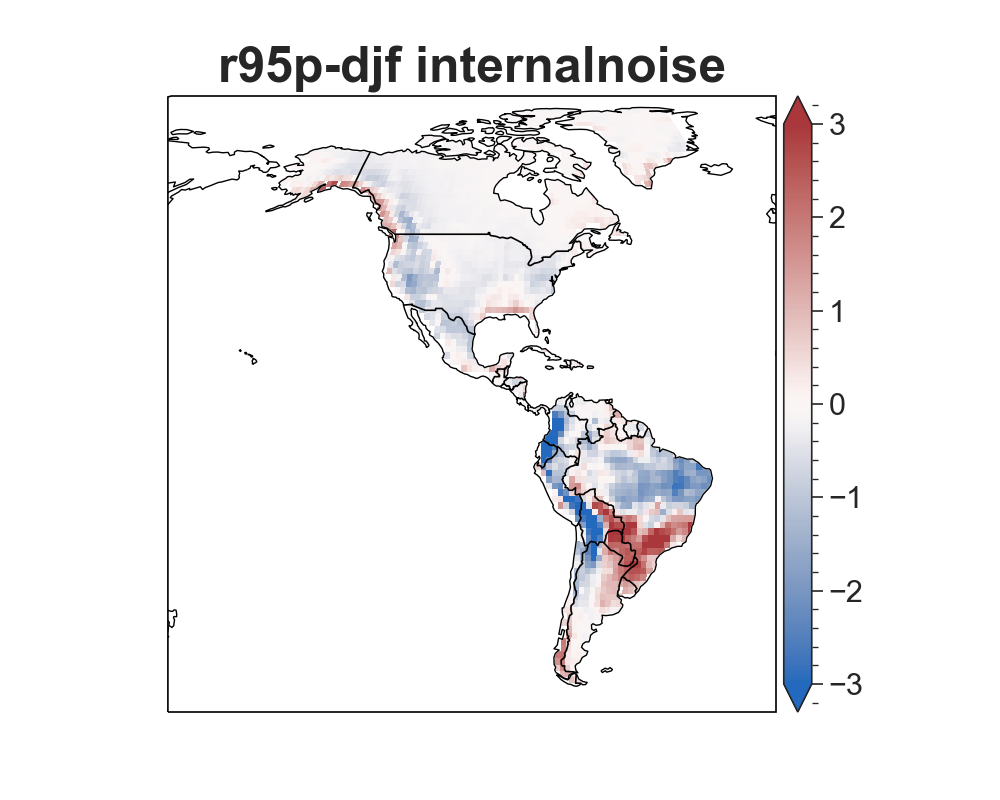

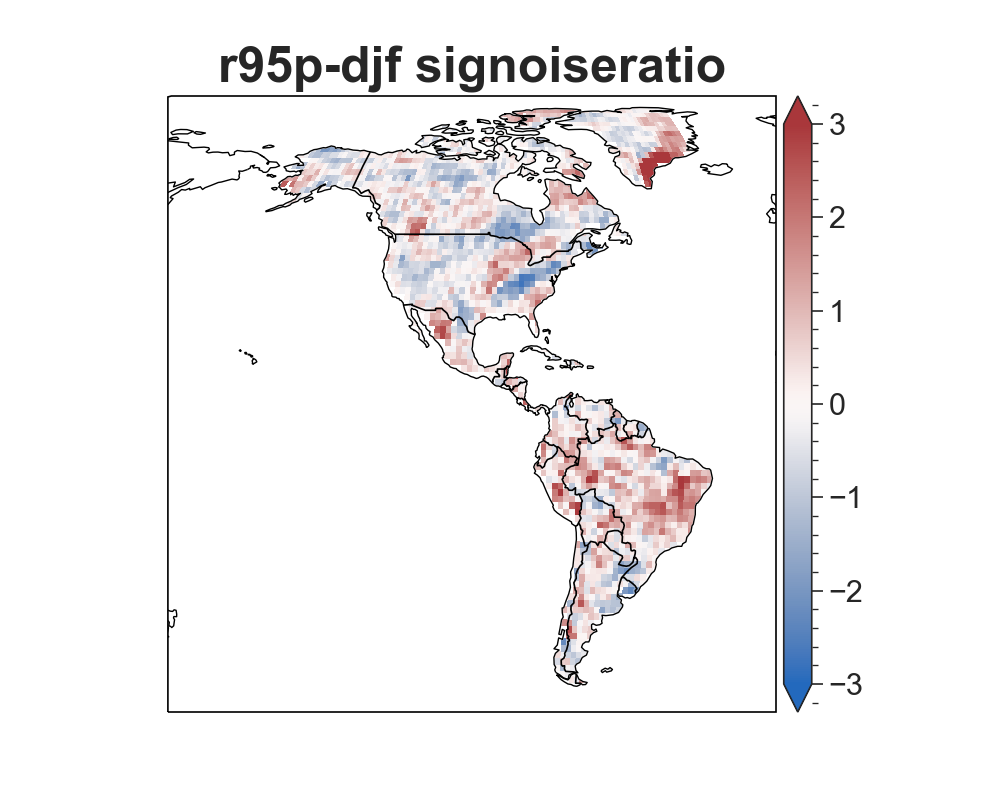

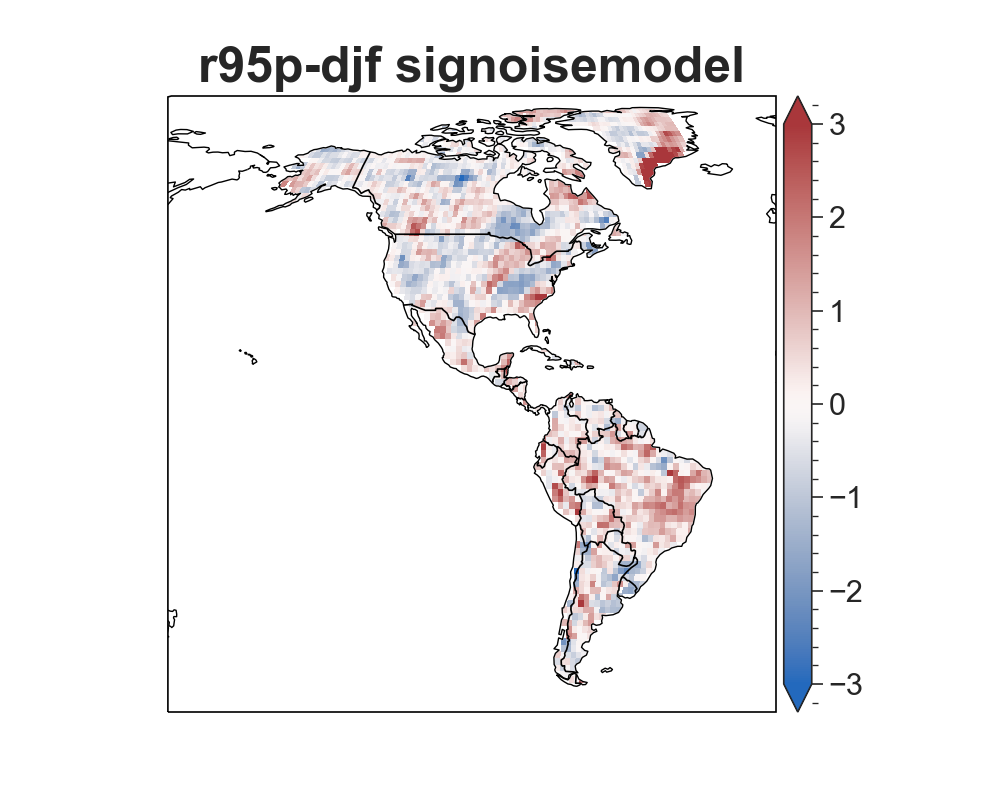

...

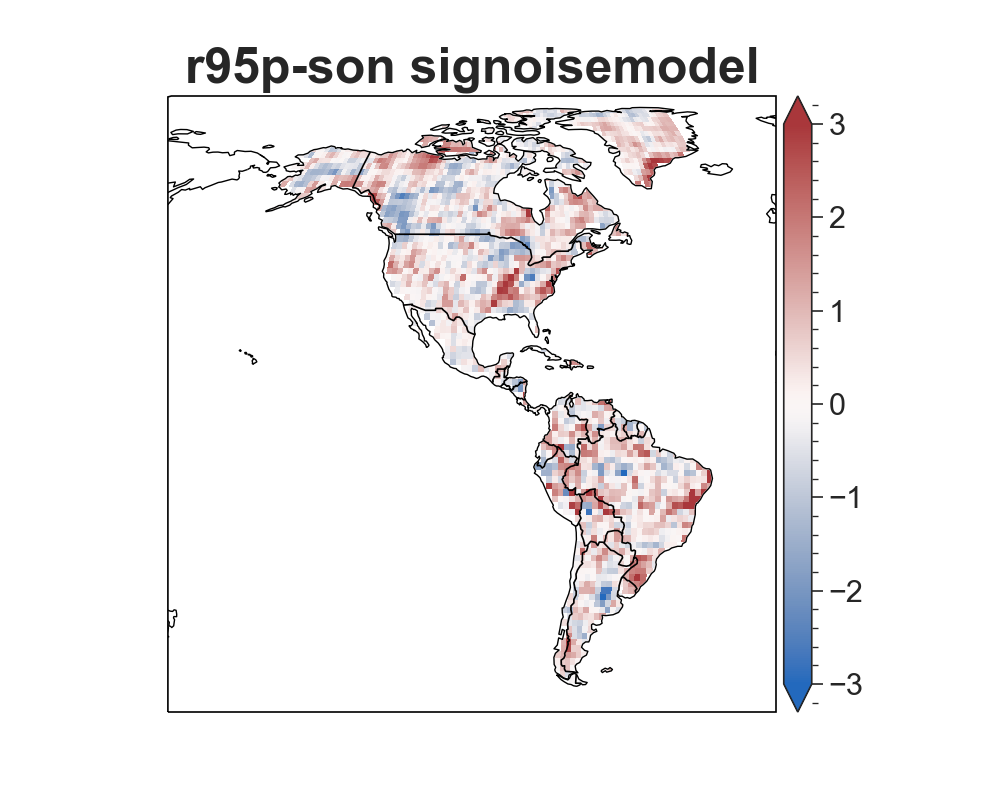

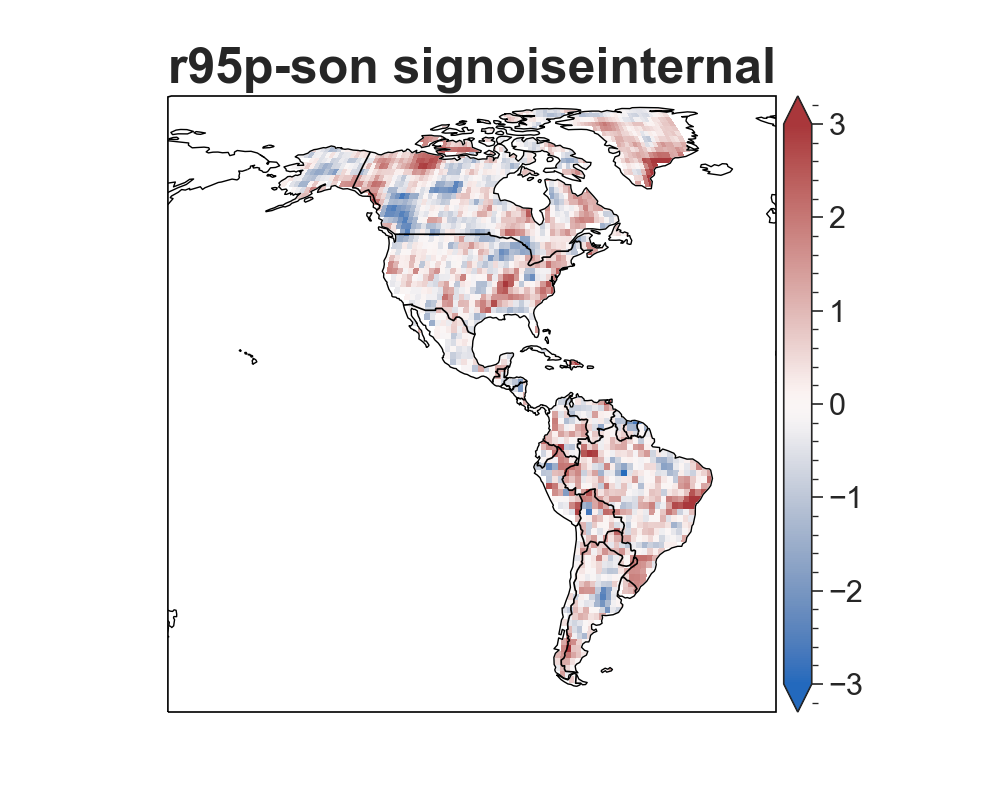

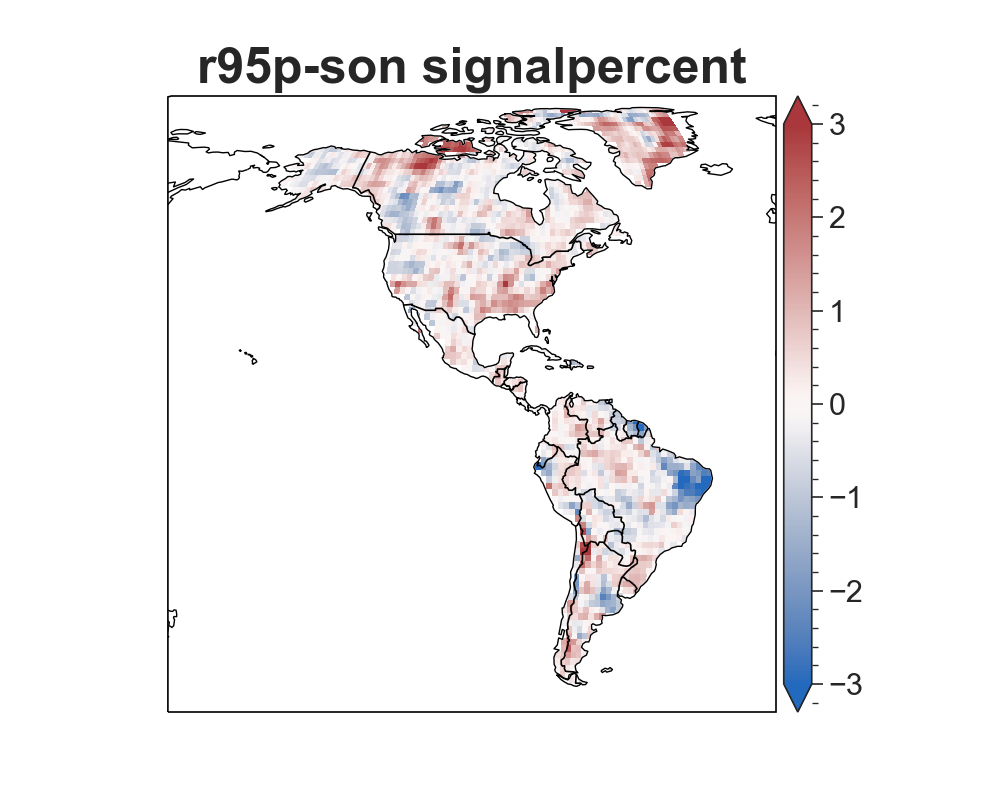

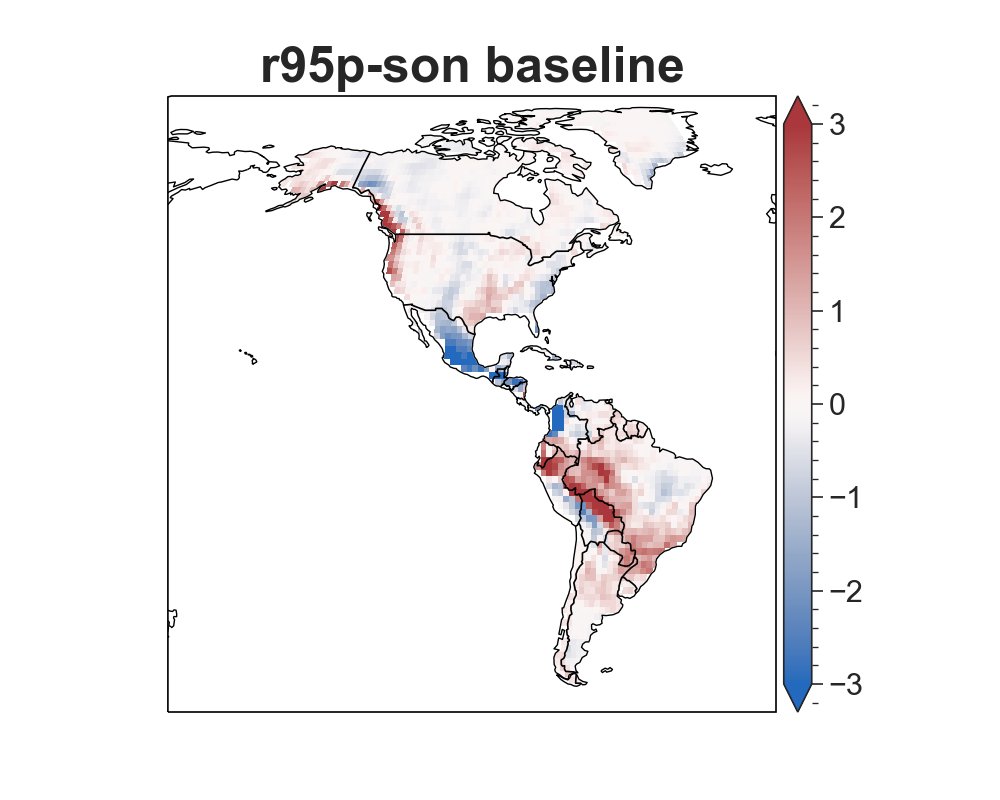

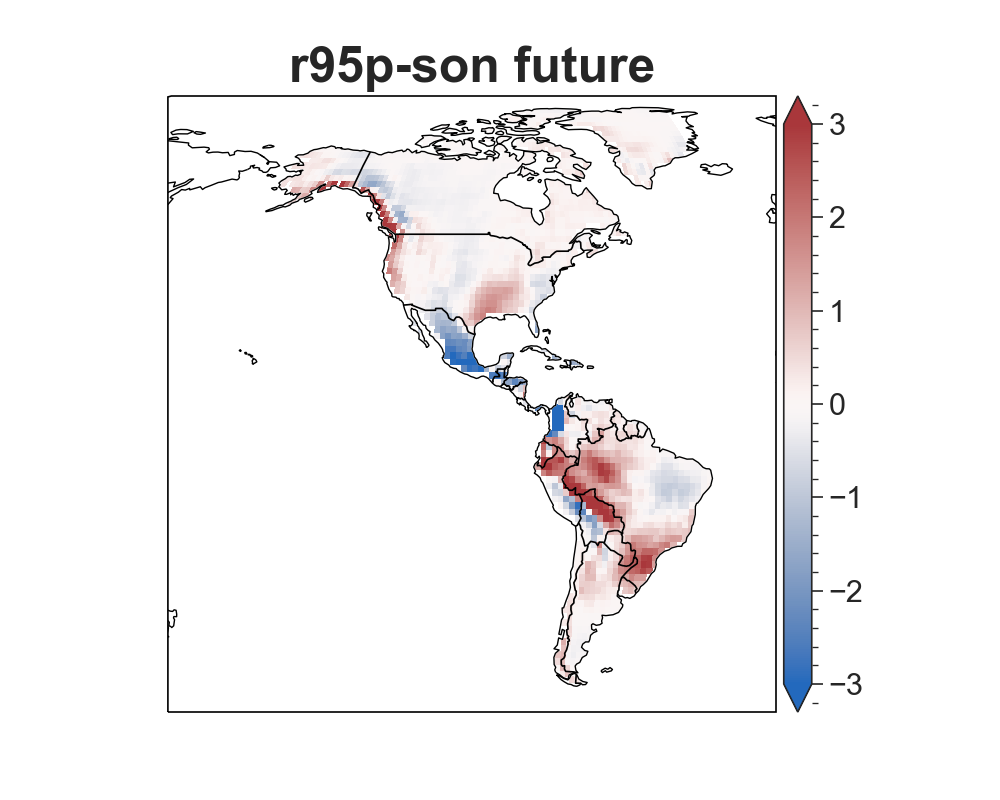

In [151]:
# Calculate differences in SNratio and such for a changing year (used for the TOE case)

def stackweightmean(list_of_arr, weights=None):
    # Incoming is  list of tuples of arrays, each part of the tuple is a different var
    output_list = []
    for i in range(len(list_of_arr[0])):
        temp_list_1var = [subtup[i] for subtup in list_of_arr]
        output_list.append(np.average(np.stack(temp_list_1var), axis=0, weights=weights))
    return output_list #outputting a list of arrays (one array for each tup element)

var_orig = VAR
for v in range(len(var_orig)): 
    SNratio_list, SNmodel_list, SNinternal_list, signal_list, modelnoise90_list, internalnoise90_list, \
    signalpercent_list, baseline_list, future_list = [list() for i in range(9)]

    for cnum in range(len(relevance_maps)):
        
        this_cluster_models = bargraphx[cnum][bargraphy[cnum] > 75]
        print(this_cluster_models)

        VAR = var_orig[v]
        var = VAR
        all_data_list = []
        
#         for modelnumber in bargraphx[cnum][bargraphy[cnum] > 75]:
#             local_toe_for_models = toe_for_models[models_for_toe == modelnumber]
#             uniq_years, year_counts = np.unique(local_toe_for_models, return_counts = True)
#             weights = year_counts / np.sum(year_counts)
#             all_data_list_onemodel = []
#             for endyear in uniq_years:
#                 YEAR = endyear
#                 ds_orig, years, lats, lons = open_climate_model_data(mod_id=modelnumber)
#                 print(modelnumber, endyear)
#                 print("Do NaNs exist?:", len(ds_orig[np.isnan(ds_orig)]))
#                 ds = remove_mean_1980_2019(ds_orig, years)
#                 fo_ds = calc_polynomial(ds, years)
#                 #SNratio1, SNmodel1, SNinternal1, signal1, modelnoise901, internalnoise901, signalpercent1, \
#                 #baseline1, future1 = calc_variability(fo_ds, years)
#                 all_data_list_onemodel.append( calc_variability(fo_ds, years) )
#             all_data_list.append(stackweightmean(all_data_list_onemodel, weights = weights))
            
            
        YEAR =2005
        ds_orig, years, lats, lons = open_climate_model_data(mod_id = this_cluster_models)
        ds = remove_mean_1980_2019(ds_orig, years)
        fo_ds = calc_polynomial(ds, years)
        #SNratio1, SNmodel1, SNinternal1, signal1, modelnoise901, internalnoise901, signalpercent1, \
        #baseline1, future1 = calc_variability(fo_ds, years)
        #all_data_list.append(calc_variability(fo_ds, years))

        SNratio_temp, SNmodel_temp, SNinternal_temp, signal_temp, modelnoise90_temp, \
        internalnoise90_temp, signalpercent_temp, baseline_temp, future_temp \
        = calc_variability(fo_ds, years)
               
#         SNratio_temp, SNmodel_temp, SNinternal_temp, signal_temp, modelnoise90_temp, \
#         internalnoise90_temp, signalpercent_temp, baseline_temp, future_temp \
#         = stackweightmean(all_data_list)
    
        SNratio_list.append(SNratio_temp)
        SNmodel_list.append(SNmodel_temp)
        SNinternal_list.append(SNinternal_temp)
        signal_list.append(signal_temp)
        modelnoise90_list.append(modelnoise90_temp)
        internalnoise90_list.append(internalnoise90_temp)
        signalpercent_list.append(signalpercent_temp)
        baseline_list.append(baseline_temp)
        future_list.append(future_temp)
       
    SNratio, SNmodel, SNinternal, signal, modelnoise90, internalnoise90, signalpercent, baseline, future = \
    SNratio_list[0] - SNratio_list[1], \
    SNmodel_list[0] - SNmodel_list[1], \
    SNinternal_list[0] - SNinternal_list[1], \
    signal_list[0] - signal_list[1], \
    modelnoise90_list[0] - modelnoise90_list[1], \
    internalnoise90_list[0] - internalnoise90_list[1], \
    signalpercent_list[0] - signalpercent_list[1], \
    baseline_list[0] - baseline_list[1], \
    future_list[0] - future_list[1]

    for to_map, to_map_name in \
    zip([signal, modelnoise90, internalnoise90, SNratio, SNmodel, SNinternal, signalpercent, baseline,
         future], 
        ['signal', 'modelnoise', 'internalnoise', 'signoiseratio', 'signoisemodel', 
         'signoiseinternal','signalpercent', 'baseline', 'future']):

        data = to_map.reshape(len(lats), len(lons))

        maskinfo = np.load(MASK)
        boolland, boollats, boollons = maskinfo['mask'], maskinfo['lats'], maskinfo['lons']
        data[~boolland] = np.nan
        data = data[lats > -55, :]
        data = data[:, np.logical_and(lons < 335, lons > 190)]
        plats = lats[lats > -55]
        plons = lons[np.logical_and(lons < 335, lons > 190)]

        # data = (data - np.nanmean(data)) / np.nanstd(data)
        data = data / np.nanstd(data)

        #print(to_map_name, VAR, np.min(data))

        plt.figure(figsize=(5,4))

        #data, lats, lons = unmask(to_map, lats, lons)

        ax = plt.axes(projection=ccrs.Robinson(central_longitude=280))
        #ax = plt.axes(projection=ccrs.Robinson())

        # Defaults:
        vmin, vmax = -3, 3
        ticks = [-3, -2, -1, 0, 1, 2, 3]
        factor = 1
        cmap = 'vlag'
        extend = 'both'

        """if to_map_name in ['signoiseratio', 'signoisemodel', 'signoiseinternal']:
            ticks = [0, 0.5, 1, 1.5]
            vmax=1.5
        elif to_map_name in ['modelnoise', 'internalnoise']:
            ticks = [0, 1, 2, 3]
            factor =100000
            cmap = proplot.Colormap('#FF00FF')
        elif to_map_name == 'signal':
            ticks = [-3, -2, -1, 0,1, 2, 3]
            cmap="vlag"
            extend = 'both'
            vmin = -3
            factor=100000
        elif to_map_name == 'signalpercent':
            ticks = [-100, -50, 0, 50, 100]
            vmin, vmax = -100, 100
            cmap = "vlag"
            extend = 'both'
            factor = 100
        elif to_map_name == 'baseline':
            ticks = [0,1,2,3,4,5]
            factor = 100000
            cmap = proplot.Colormap('#FF00FF')
            vmax = 5
        elif to_map_name == 'future':
            ticks = [0,1,2,3,4,5]
            factor = 100000
            cmap = proplot.Colormap('#FF00FF')
            vmax = 5"""

        plt.pcolormesh(plons, plats, factor * data, transform=ccrs.PlateCarree(), 
                       vmin = vmin, vmax = vmax, cmap=cmap)
        cb = plt.colorbar(pad=0.01, extend=extend)
        cb.ax.tick_params(labelsize=11)
        #cb.set_ticks([])
        cb.set_ticks(ticks)

        ax.coastlines(zorder=2, linewidth = .5)
        ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='white')
        ax.add_feature(cartopy.feature.BORDERS)
        #plt.xlim(190, 335)
        #plt.ylim(-55, 90)
        #plt.legend(loc='center left', bbox_to_anchor=(0, .5))
        #plt.title('(b) temperature signal-to-noise ratio', size=13, fontweight='demi')
        #plt.title(str(YEAR) + ' ' + VAR + ' signal-to-noise ratio from ' + MODEL_SET, size=18, fontweight='demi')
        #plt.title('SON precipitation', size=18, fontweight='demi')
        plt.title(var + ' ' + to_map_name, size=18, fontweight='demi')
        plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/clusters/' + to_map_name + '-' + \
                    var + '-' + str(timecode) + '-standardized_differences.jpg', 
                    dpi=300, bboxes_inches='tight')
    VAR = var_orig

In [141]:
ds

array([[[0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [9.86613173e-08, 1.02182192e-07, 1.10823905e-07, ...,
         0.00000000e+00, 0.00000000e+00, 0.00000000e+00],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         2.11438149e-07, 2.11280494e-07, 2.11645684e-07],
        ...,
        [1.02727779e-06, 1.02332058e-06, 1.01960825e-06, ...,
         5.72040426e-06, 6.29435272e-06, 6.31791863e-06],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         7.21507604e-06, 6.90539127e-06, 6.75509318e-06],
        [0.00000000e+00, 0.00000000e+00, 0.00000000e+00, ...,
         5.37952883e-06, 5.39144366e-06, 5.28900273e-06]]], dtype=float32)

[ 0  1  6  7  8 10 11 15 16 20 24 31]
[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:55: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:65: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:55: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true

[ 0  1  6  7  8 10 11 15 16 20 24 31]
[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]
[ 0  1  6  7  8 10 11 15 16 20 24 31]
[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


[ 0  1  6  7  8 10 11 15 16 20 24 31]
[ 2  3  4  5  9 12 13 14 17 18 19 21 22 23 25 26 27 28 29 30]


/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:55: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:63: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:64: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:65: RuntimeWarning: invalid value encountered in true_divide
/Users/Jamin/anaconda3/envs/toe2/lib/python3.7/site-packages/ipykernel_launcher.py:51: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


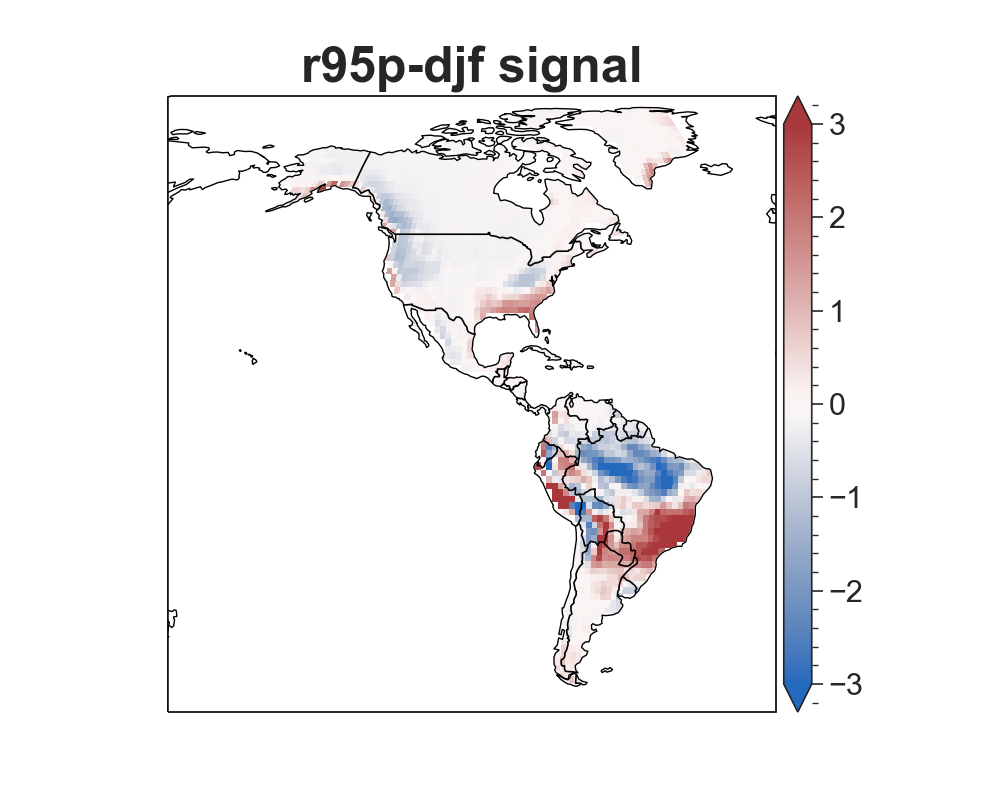

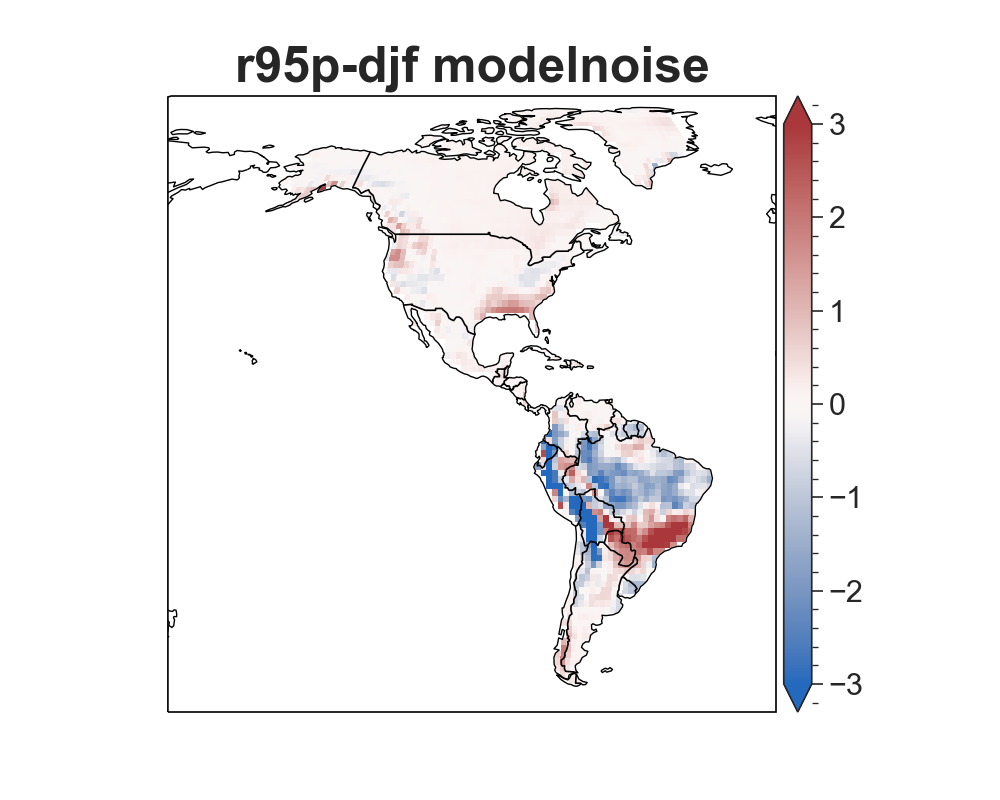

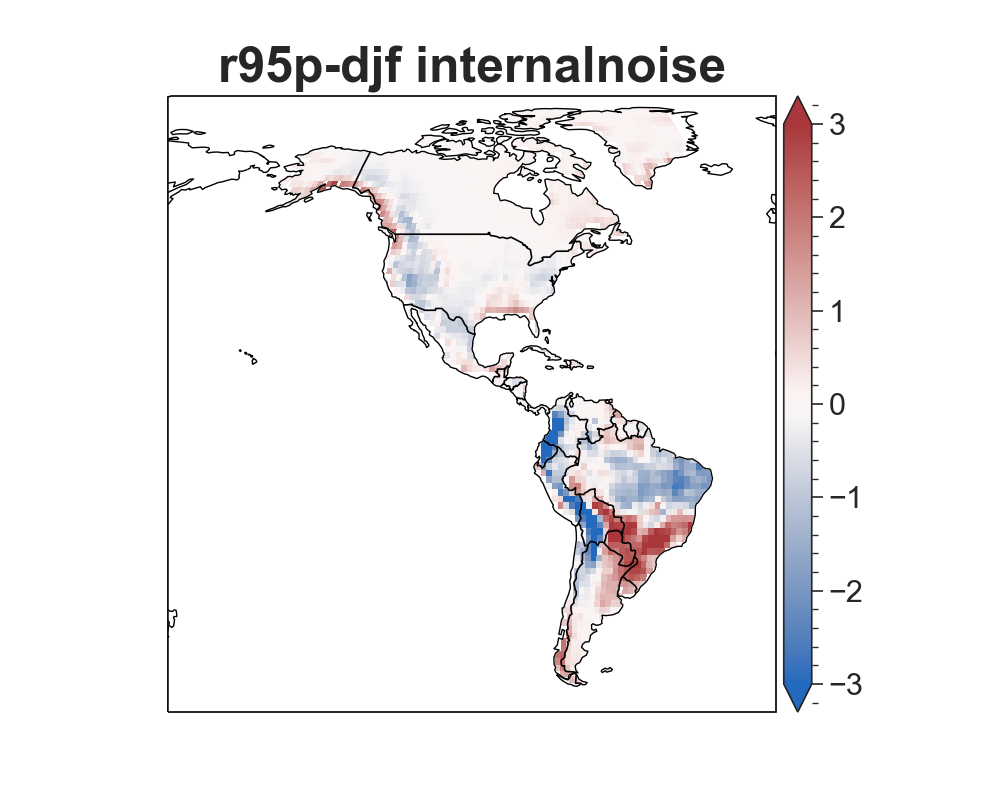

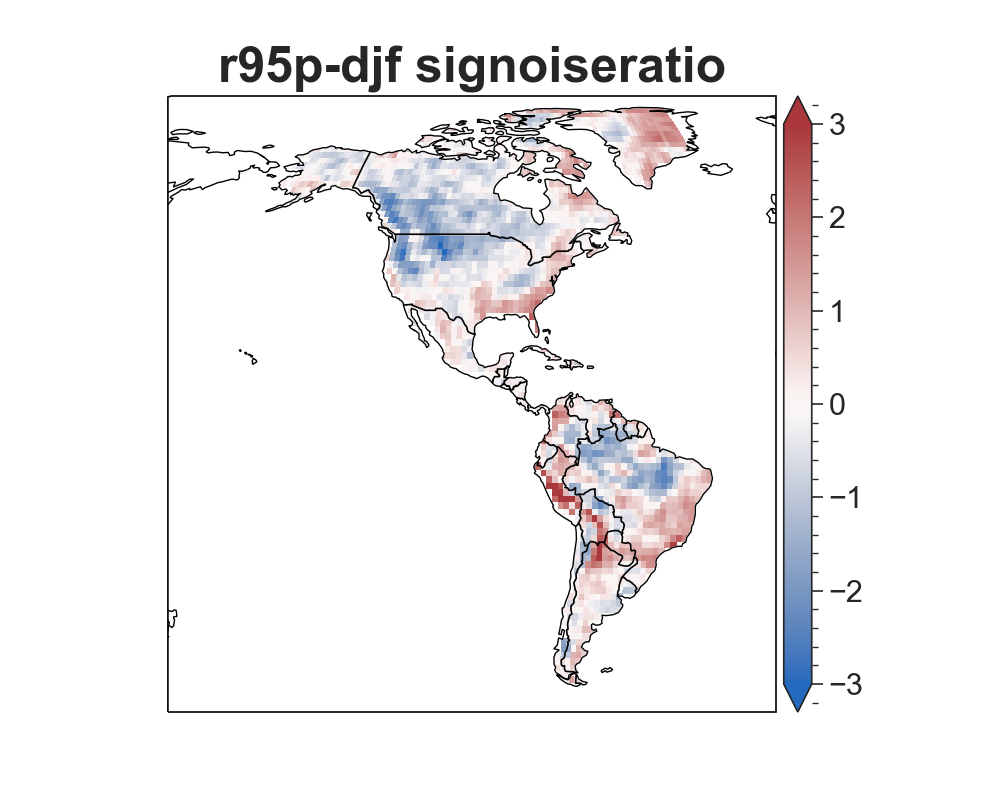

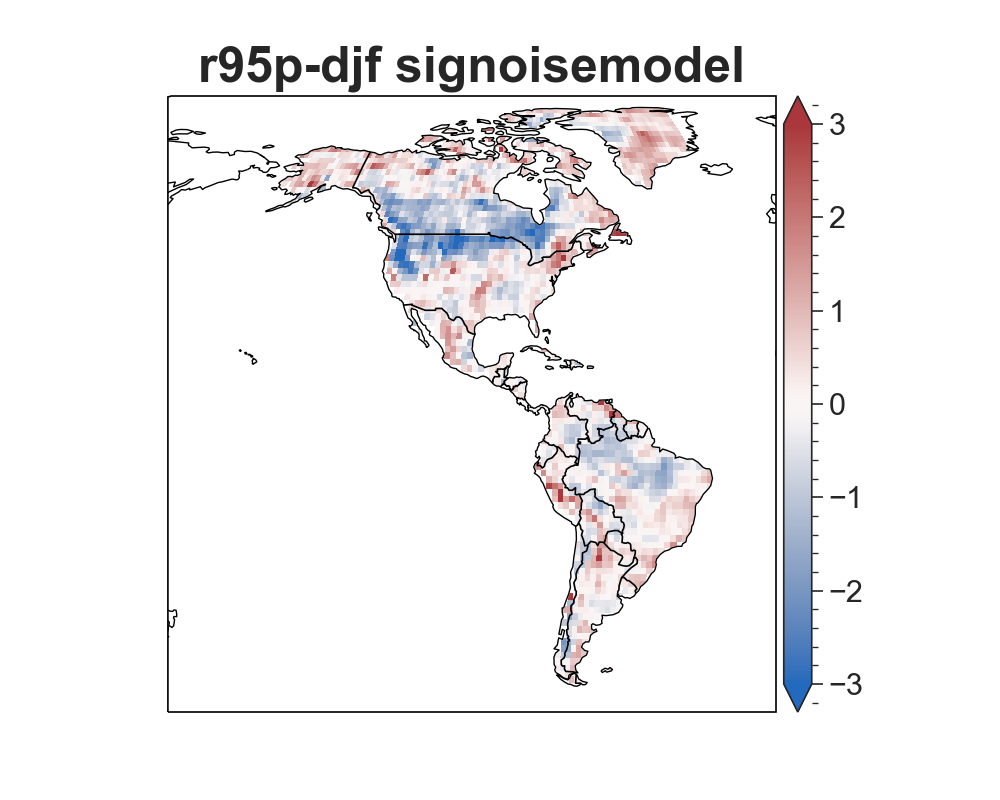

...

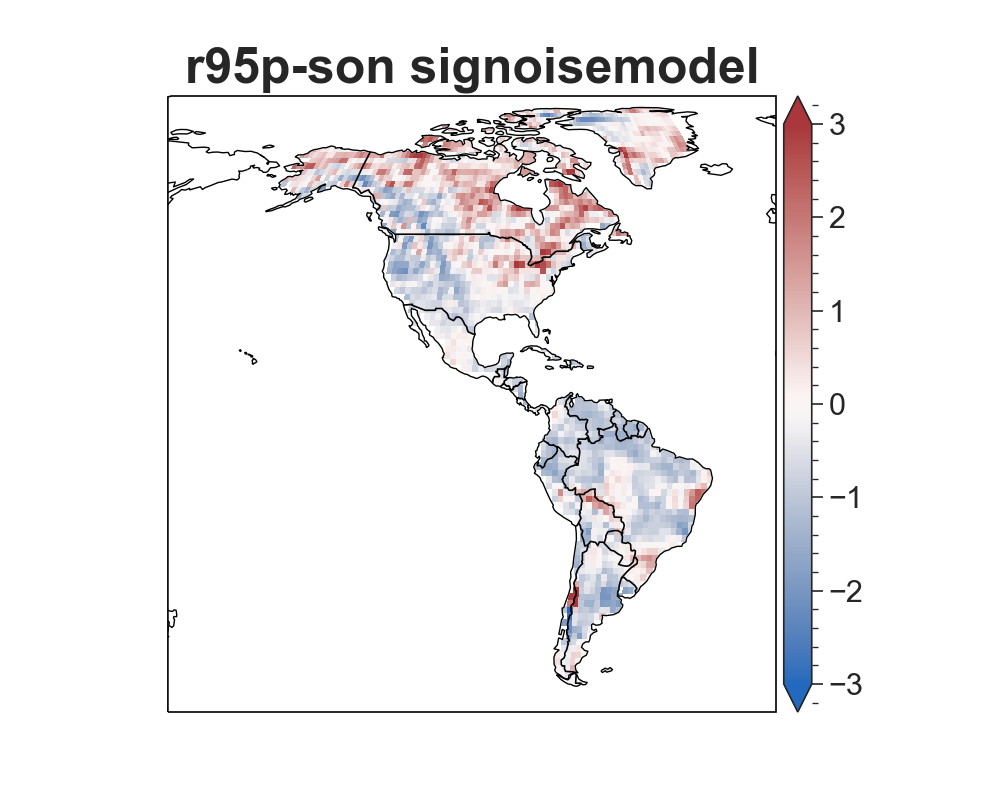

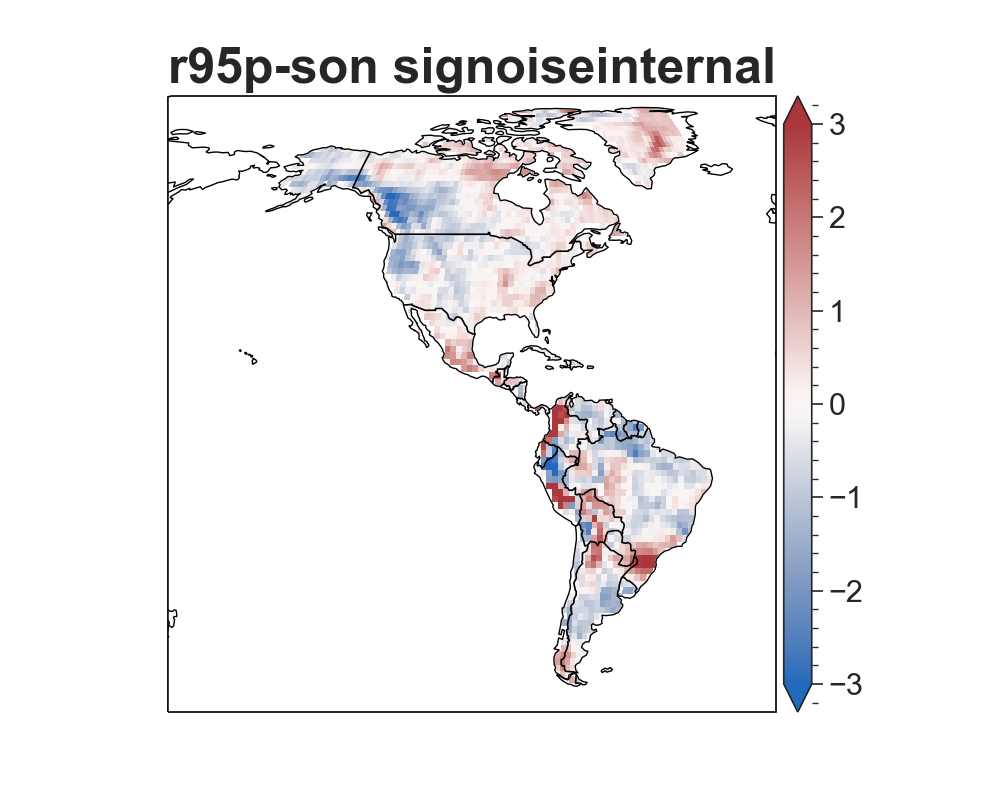

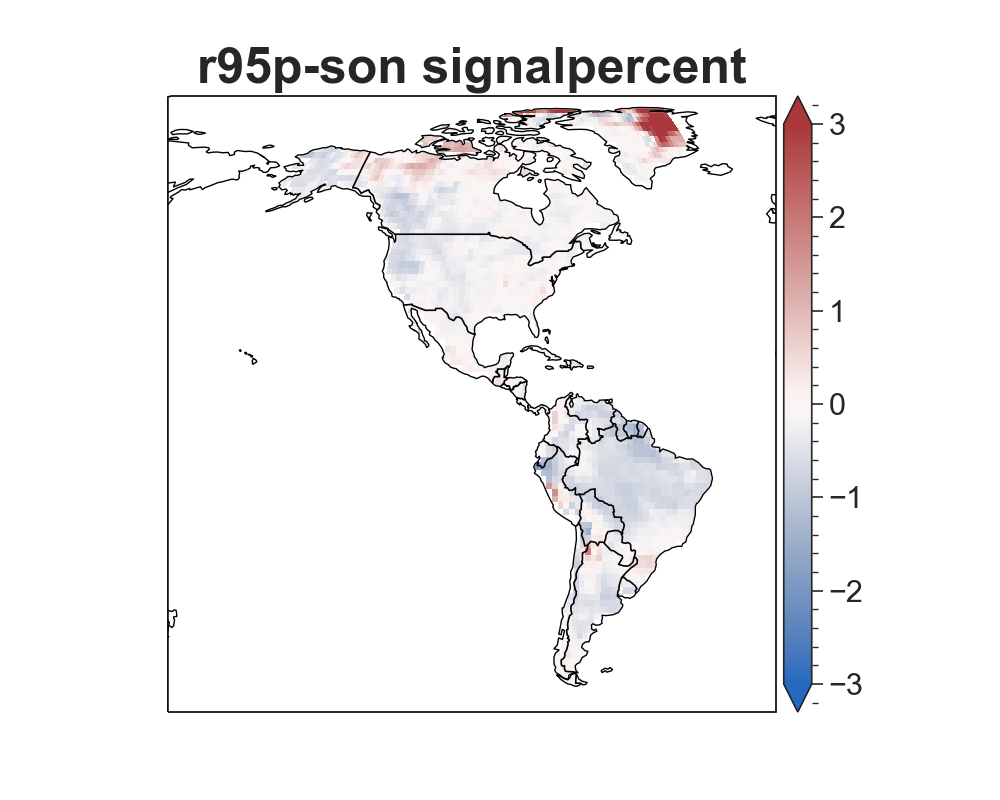

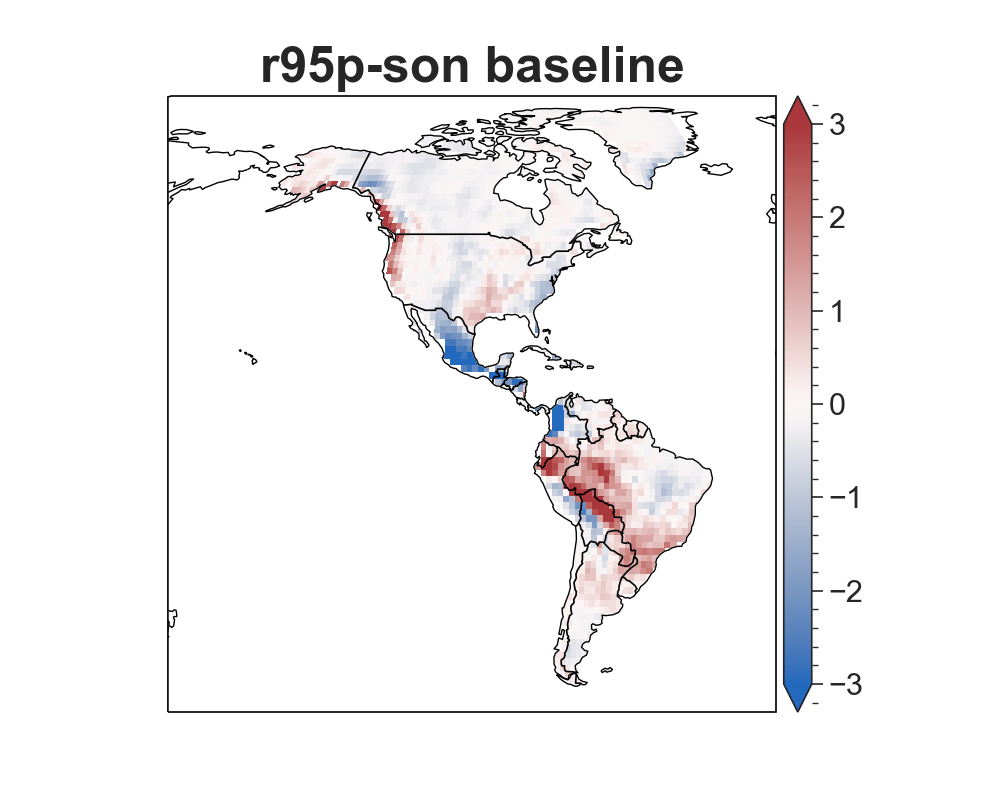

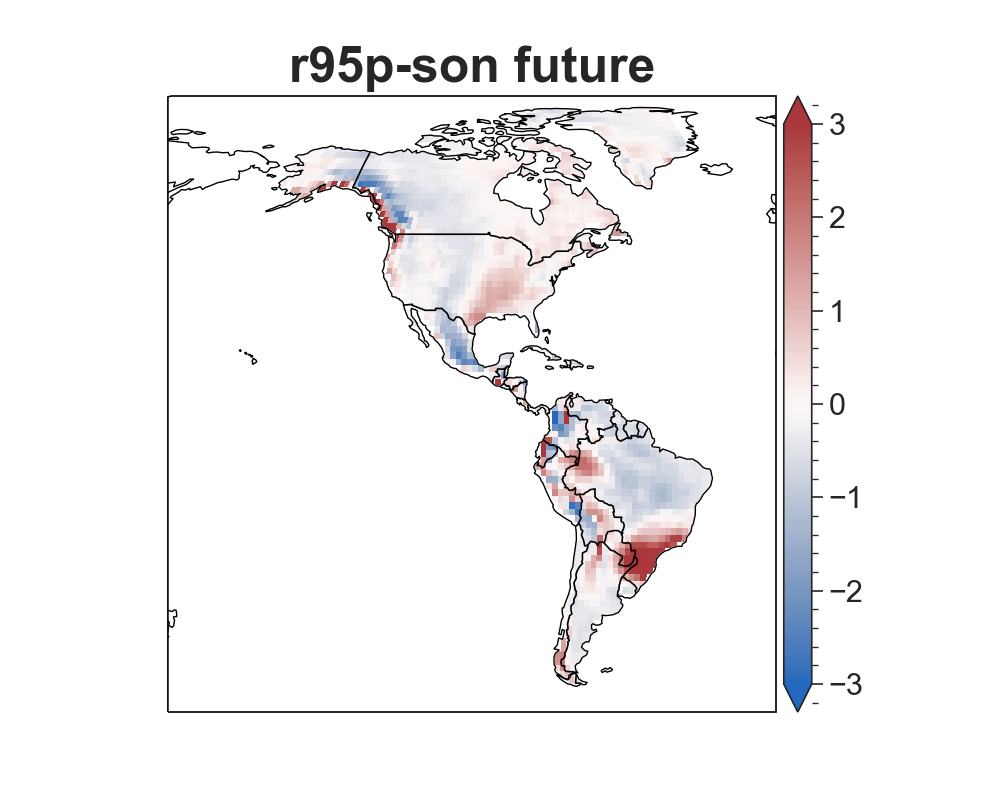

In [45]:
# Calculate the difference in SNratio and such

var_orig = VAR

for v in range(len(var_orig)):

    print(bargraphx[0][bargraphy[0] > 75])
    print(bargraphx[1][bargraphy[1] > 75])
    VAR = var_orig[v]
    var = VAR
    
    cnum = 0
    ds_orig, years, lats, lons = open_climate_model_data()
    ds = ds_orig[bargraphx[cnum][bargraphy[cnum] > 75]]
    fo_ds = calc_polynomial(ds, years)
    SNratio1, SNmodel1, SNinternal1, signal1, modelnoise901, internalnoise901, signalpercent1, \
    baseline1, future1 = calc_variability(fo_ds, years)
    
    cnum = 1
    ds_orig, years, lats, lons = open_climate_model_data()
    ds = ds_orig[bargraphx[cnum][bargraphy[cnum] > 75]]
    fo_ds = calc_polynomial(ds, years)
    SNratio2, SNmodel2, SNinternal2, signal2, modelnoise902, internalnoise902, signalpercent2, \
    baseline2, future2 = calc_variability(fo_ds, years)
    
    signal, modelnoise90, internalnoise90, SNratio, SNmodel, SNinternal, signalpercent, baseline, future \
    = (signal1-signal2, modelnoise901-modelnoise902, internalnoise901-internalnoise902, SNratio1-SNratio2,
       SNmodel1-SNmodel2, SNinternal1-SNinternal2,signalpercent1-signalpercent2, baseline1-baseline2,
       future1-future2)

    for to_map, to_map_name in \
    zip([signal, modelnoise90, internalnoise90, SNratio, SNmodel, SNinternal, signalpercent, baseline,
         future], 
        ['signal', 'modelnoise', 'internalnoise', 'signoiseratio', 'signoisemodel', 
         'signoiseinternal','signalpercent', 'baseline', 'future']):

        data = to_map.reshape(len(lats), len(lons))
        
        maskinfo = np.load(MASK)
        boolland, boollats, boollons = maskinfo['mask'], maskinfo['lats'], maskinfo['lons']
        data[~boolland] = np.nan
        data = data[lats > -55, :]
        data = data[:, np.logical_and(lons < 335, lons > 190)]
        plats = lats[lats > -55]
        plons = lons[np.logical_and(lons < 335, lons > 190)]
        
        data = (data - np.nanmean(data)) / np.nanstd(data)
        
        #print(to_map_name, VAR, np.min(data))

        plt.figure(figsize=(5,4))

        #data, lats, lons = unmask(to_map, lats, lons)

        ax = plt.axes(projection=ccrs.Robinson(central_longitude=280))
        #ax = plt.axes(projection=ccrs.Robinson())

        # Defaults:
        vmin, vmax = -3, 3
        ticks = [-3, -2, -1, 0, 1, 2, 3]
        factor = 1
        cmap = 'vlag'
        extend = 'both'

        """if to_map_name in ['signoiseratio', 'signoisemodel', 'signoiseinternal']:
            ticks = [0, 0.5, 1, 1.5]
            vmax=1.5
        elif to_map_name in ['modelnoise', 'internalnoise']:
            ticks = [0, 1, 2, 3]
            factor =100000
            cmap = proplot.Colormap('#FF00FF')
        elif to_map_name == 'signal':
            ticks = [-3, -2, -1, 0,1, 2, 3]
            cmap="vlag"
            extend = 'both'
            vmin = -3
            factor=100000
        elif to_map_name == 'signalpercent':
            ticks = [-100, -50, 0, 50, 100]
            vmin, vmax = -100, 100
            cmap = "vlag"
            extend = 'both'
            factor = 100
        elif to_map_name == 'baseline':
            ticks = [0,1,2,3,4,5]
            factor = 100000
            cmap = proplot.Colormap('#FF00FF')
            vmax = 5
        elif to_map_name == 'future':
            ticks = [0,1,2,3,4,5]
            factor = 100000
            cmap = proplot.Colormap('#FF00FF')
            vmax = 5"""

        plt.pcolormesh(plons, plats, factor * data, transform=ccrs.PlateCarree(), 
                       vmin = vmin, vmax = vmax, cmap=cmap)
        cb = plt.colorbar(pad=0.01, extend=extend)
        cb.ax.tick_params(labelsize=11)
        #cb.set_ticks([])
        cb.set_ticks(ticks)

        ax.coastlines(zorder=2, linewidth = .5)
        ax.add_feature(cartopy.feature.OCEAN, zorder=1,facecolor='white')
        ax.add_feature(cartopy.feature.BORDERS)
        #plt.xlim(190, 335)
        #plt.ylim(-55, 90)
        #plt.legend(loc='center left', bbox_to_anchor=(0, .5))
        #plt.title('(b) temperature signal-to-noise ratio', size=13, fontweight='demi')
        #plt.title(str(YEAR) + ' ' + VAR + ' signal-to-noise ratio from ' + MODEL_SET, size=18, fontweight='demi')
        #plt.title('SON precipitation', size=18, fontweight='demi')
        plt.title(var + ' ' + to_map_name, size=18, fontweight='demi')
        plt.savefig('/Users/Jamin/Rams/TOE_Research/plots/final_plots/clusters/' + to_map_name + '-' + \
                    var + '-' + str(timecode) + '-standardized_differences.jpg', 
                    dpi=300, bboxes_inches='tight')
VAR = var_orig

In [30]:
print(data.shape)
print((lats < -55).shape)
print(np.logical_or(lons > 335, lons < 190).shape)
data[lats < -55].shape

(120, 240)
(120,)
(240,)


(23, 240)

2.0

In [31]:
modelstats["['r95p-djf', 'r95p-jja', 'r95p-mam', 'r95p-son']"][0]['model result']['TOE(train)']

array([2007, 1999, 2014, 2001, 1999, 1999, 2003, 2009, 1997, 2003, 1996,
       2003, 2020, 2003, 2001, 2016, 2008, 1995, 1997, 2011, 2011, 2019,
       2005, 2011, 2015, 1995])